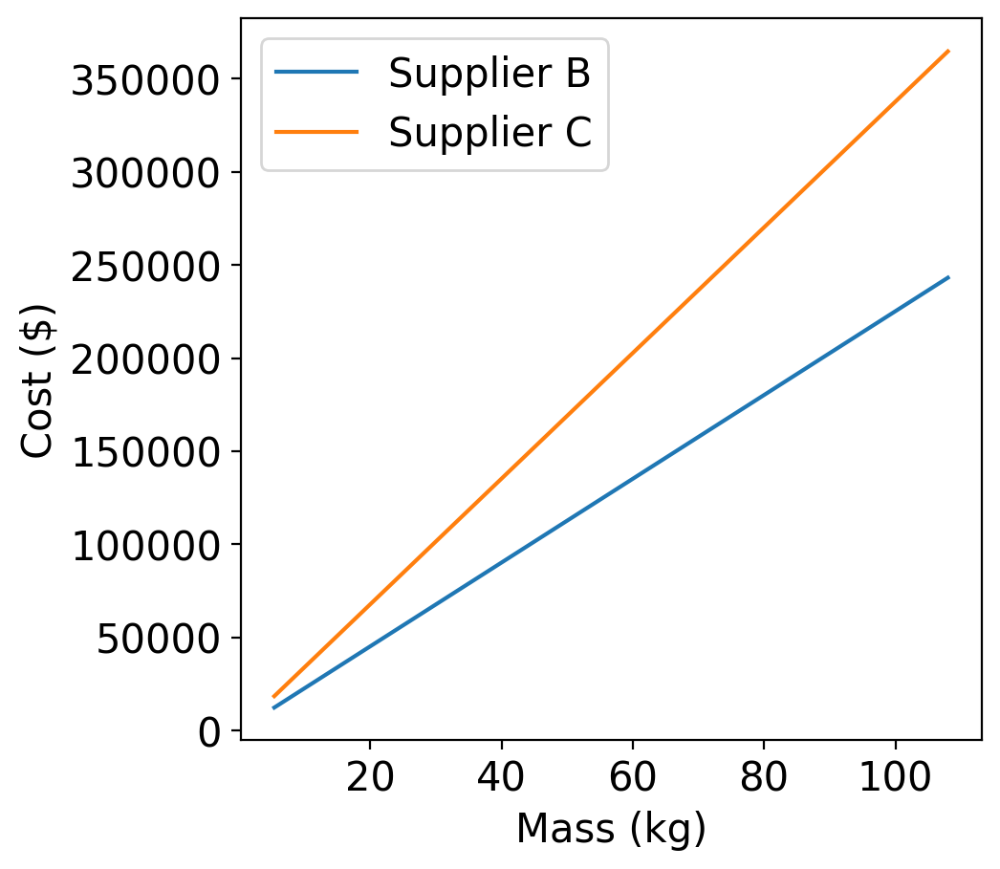

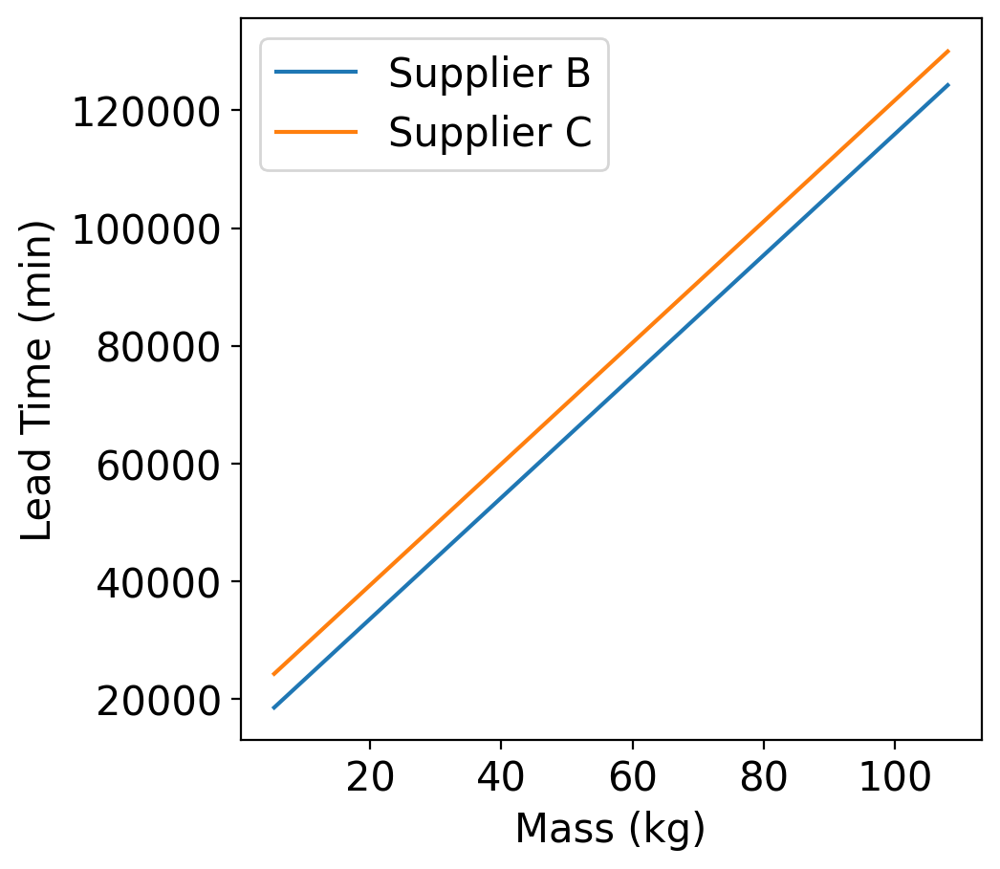

In [28]:
import pandas as pd
import matplotlib.pyplot as plt

folder = 'Past/Iter0/' + 'config_1'
df = pd.read_csv("Studies/EMB_Scenario_2_supplier_test/" + folder + '/probe_results.csv')

dfA = df[df['Supplier'] == 'Supplier-B']
dfB = df[df['Supplier'] == 'Supplier-C']

# print(df['Cost ($)'])
# print(df['Lead Time (min)'])

# print(dfA['Probe'][:-1], dfA['Lead Time (min)'][:-1])

plt.figure(1,dpi = 200, figsize = (5,5))
plt.plot(dfA['Mass (g)'][9:]/1000,dfA['Cost ($)'][9:])
plt.plot(dfB['Mass (g)'][9:]/1000,dfB['Cost ($)'][9:])
plt.xlabel('Mass (kg)',fontsize = '15')
plt.ylabel('Cost ($)',fontsize = '15')
plt.tick_params(axis='both', labelsize=15)
plt.legend(['Supplier B','Supplier C'],fontsize = '15')

plt.figure(2,dpi = 200, figsize = (5,5))
plt.plot(dfA['Mass (g)'][9:]/1000,dfA['Lead Time (min)'][9:])
plt.plot(dfB['Mass (g)'][9:]/1000,dfB['Lead Time (min)'][9:])
plt.xlabel('Mass (kg)',fontsize = '15')
plt.ylabel('Lead Time (min)',fontsize = '15')
plt.tick_params(axis='both', labelsize=15)
plt.legend(['Supplier B','Supplier C'],fontsize = '15')


# plt.figure(1)
# plt.plot(dfA['Probe'],dfA['Cost ($)'])
# plt.plot(dfB['Probe'],dfB['Cost ($)'])
# plt.xlabel('Volume Fraction')
# plt.ylabel('Cost')
# plt.legend(['Supplier B','Supplier C'])

# plt.figure(2)
# plt.plot(dfA['Probe'],dfA['Lead Time (min)'])
# plt.plot(dfB['Probe'],dfB['Lead Time (min)'])
# plt.xlabel('Volume Fraction')
# plt.ylabel('Lead Time')
# plt.legend(['Supplier B','Supplier C'])

# plt.figure(3)
# plt.plot(dfA['Probe'],dfA['Mass (g)'])
# plt.plot(dfB['Probe'],dfB['Mass (g)'])
# plt.xlabel('Volume Fraction')
# plt.ylabel('Mass')
# plt.legend(['Supplier B','Supplier C'])

# plt.figure(4)
# plt.plot(dfA['Probe'],dfA['Compliance (Nm)'])
# plt.plot(dfB['Probe'],dfB['Compliance (Nm)'])
# plt.xlabel('Volume Fraction')
# plt.ylabel('Compliance')
# plt.legend(['Supplier B','Supplier C'])


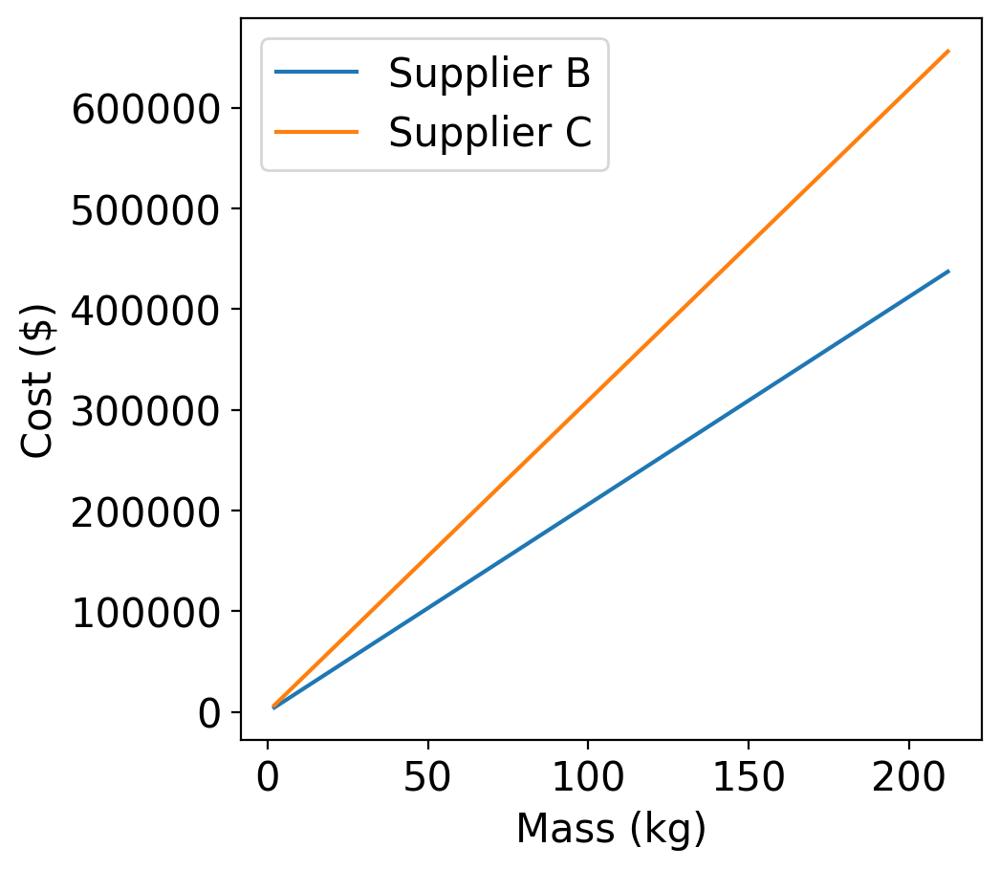

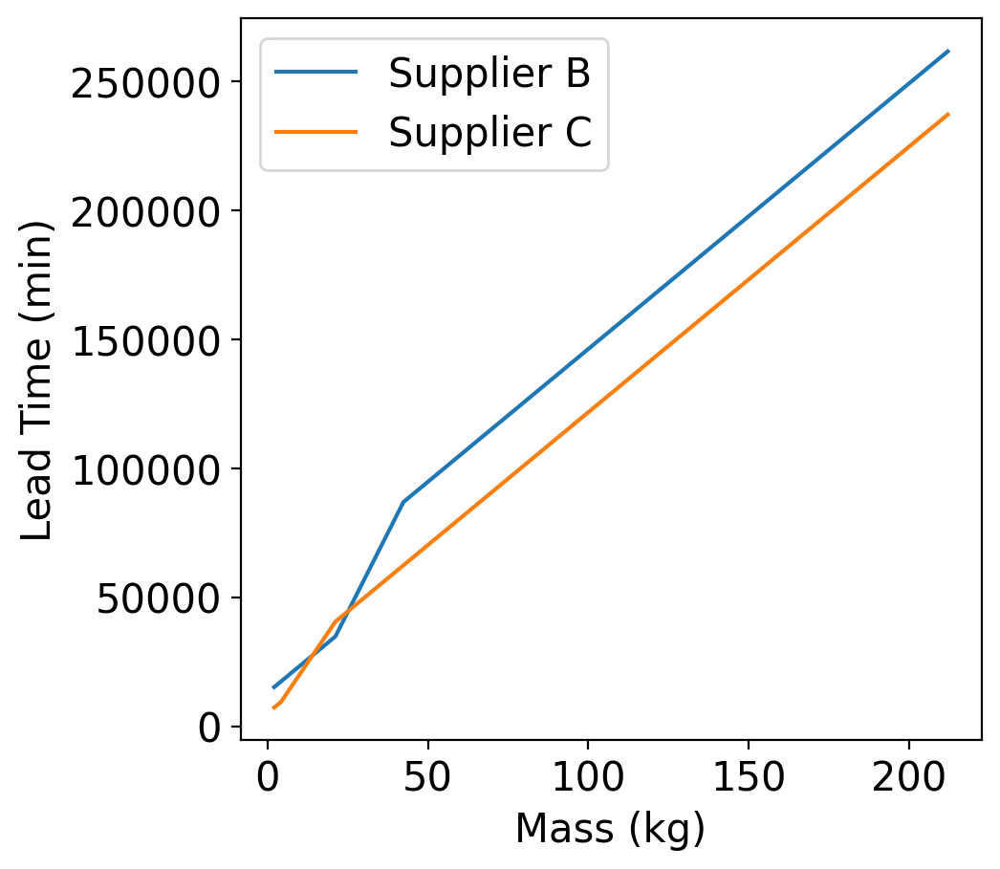

In [26]:
import pandas as pd
import matplotlib.pyplot as plt

folder = 'Past/Iter0/' + 'config_8'
df = pd.read_csv("Studies/EMB_Scenario_2_supplier_test/" + folder + '/probe_results.csv')

dfA = df[df['Supplier'] == 'Supplier-B']
dfB = df[df['Supplier'] == 'Supplier-C']

# print(df['Cost ($)'])
# print(df['Lead Time (min)'])

# print(dfA['Probe'][:-1], dfA['Lead Time (min)'][:-1])

plt.figure(1,dpi = 200, figsize = (5,5))
plt.plot(dfA['Mass (g)'][5:]/1000,dfA['Cost ($)'][5:])
plt.plot(dfB['Mass (g)'][5:]/1000,dfB['Cost ($)'][5:])
plt.xlabel('Mass (kg)',fontsize = '15')
plt.ylabel('Cost ($)',fontsize = '15')
plt.tick_params(axis='both', labelsize=15)
plt.legend(['Supplier B','Supplier C'],fontsize = '15')

plt.figure(2,dpi = 200, figsize = (5,5))
plt.plot(dfA['Mass (g)'][5:]/1000,dfA['Lead Time (min)'][5:])
plt.plot(dfB['Mass (g)'][5:]/1000,dfB['Lead Time (min)'][5:])
plt.xlabel('Mass (kg)',fontsize = '15')
plt.ylabel('Lead Time (min)',fontsize = '15')
plt.tick_params(axis='both', labelsize=15)
plt.legend(['Supplier B','Supplier C'],fontsize = '15')


In [6]:
# folder = 'config_1_2'
# df = pd.read_csv("Studies/MVP_constraints_based_test_2/" + folder + '/probe_results.csv')

# dfA = df[df['Supplier'] == '[\'Supplier-A\']']
# dfB = df[df['Supplier'] == '[\'Supplier-B\']']

# plt.figure(1)
# plt.plot(dfA['Probe'],dfA['Cost'])
# plt.plot(dfB['Probe'],dfB['Cost'])
# plt.xlabel('Volume Fraction')
# plt.ylabel('Cost')
# plt.legend(['Supplier A','Supplier B'])
# print(df['Cost'])

# plt.figure(2)
# plt.plot(dfA['Probe'],dfA['Lead Time'])
# plt.plot(dfB['Probe'],dfB['Lead Time'])
# plt.xlabel('Volume Fraction')
# plt.ylabel('Lead Time')
# plt.legend(['Supplier A','Supplier B'])

# plt.figure(3)
# plt.plot(dfA['Probe'],dfA['mass'])
# plt.plot(dfB['Probe'],dfB['mass'])
# plt.xlabel('Volume Fraction')
# plt.ylabel('Mass')
# plt.legend(['Supplier A','Supplier B'])

# plt.figure(4)
# plt.plot(dfA['Probe'],dfA['compliance'])
# plt.plot(dfB['Probe'],dfB['compliance'])
# plt.xlabel('Volume Fraction')
# plt.ylabel('Compliance')
# plt.legend(['Supplier A','Supplier B'])

In [13]:
import os, shutil
folders = os.listdir("Studies/CB_Scenario_1/Past/Iter0")
for folder in folders:
    if "config" in folder:
        folder = os.path.join("Studies/CB_Scenario_1/Past/Iter0",folder)
        for filename in os.listdir(folder):
            file_path = os.path.join(folder, filename)
            if "mmm.json" not in file_path:
                try:
                    if os.path.isfile(file_path) or os.path.islink(file_path):
                        os.unlink(file_path)
                    elif os.path.isdir(file_path):
                        shutil.rmtree(file_path)
                except Exception as e:
                    print('Failed to delete %s. Reason: %s' % (file_path, e))

In [1]:
import numpy as np
import json
import requests

request = json.load(open("Studies\EMB_Scenario_2_supplier_test\Past\Iter0\config_1\PartProcessPlans.json"))
r = requests.post('http://localhost:9090/generate-bid', data=json.dumps(request))
print(f"Status Code: {r.status_code}, Response: {r.json()}")
data = r.json()["data"]
print('lead time B: ',round(data[0]['leadTime']/60))
print('lead time C: ',round(data[1]['leadTime']/60))


Status Code: 200, Response: {'status': 'success', 'data': [{'id': 1, 'suppliers': 'Supplier-B', 'order': 'Request-A', 'processPlan': 'SLM-Additive-1', 'leadTime': 4057485, 'earliestStartTime': '2023-11-15T00:00:00+0000', 'earliestFinishTime': '2023-12-22T23:04:45+0000', 'cost': 119390.03}, {'id': 2, 'suppliers': 'Supplier-C', 'order': 'Request-A', 'processPlan': 'SLM-Additive-1', 'leadTime': 4401285, 'earliestStartTime': '2023-11-09T12:00:00+0000', 'earliestFinishTime': '2023-12-26T22:34:45+0000', 'cost': 179085.05}]}
lead time B:  67625
lead time C:  73355


8
vf_arr:  [[-1.          0.16147642]
 [-1.          0.13332289]]
mass_vf,time_vf,cost_vf 0.99999 0.16147641509433963 0.13332289466606978
cost_vf
opt1.time_con tf.Tensor(70589.99, shape=(), dtype=float32)
opt1.cost_con tf.Tensor(116665.99, shape=(), dtype=float32)


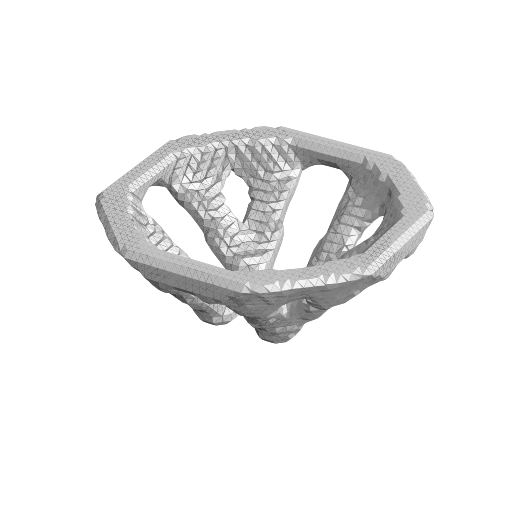

## Result Summary
VF:  tf.Tensor(0.109639004, shape=(), dtype=float32)
Mass: 46.486938 [kg]
Compliance: 1.251260e+01
Time: 47842.38 [min]
Cost: 95740.30 [$]
max d:  0.5777883175141185
comp:  12.512598037719727
vf: tf.Tensor(0.109639004, shape=(), dtype=float32)
0.5 vf: tf.Tensor(0.108125, shape=(), dtype=float64)
0.2 mass: tf.Tensor(52.61906250000001, shape=(), dtype=float64)
cutoff 0.4591836734693878
cutoff mass:  tf.Tensor(46.70625000000001, shape=(), dtype=float64)
## Result Summary
VF:  tf.Tensor(0.109639004, shape=(), dtype=float32)
Mass: 46.486938 [kg]
Compliance: 1.251260e+01
Time: 47842.38 [min]
Cost: 95740.30 [$]
Max Disp: 0.5777882606522496 [mm]


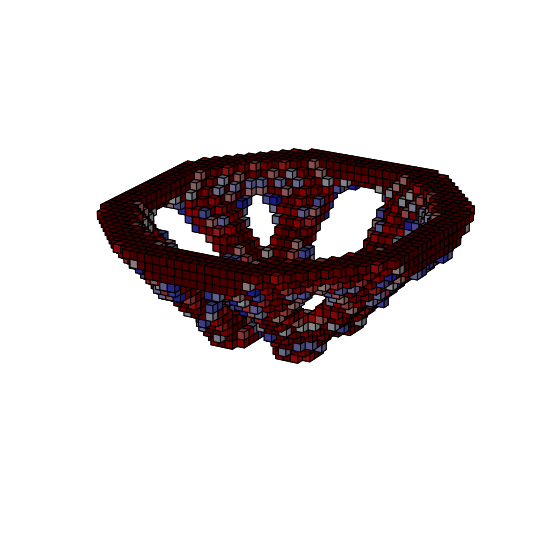

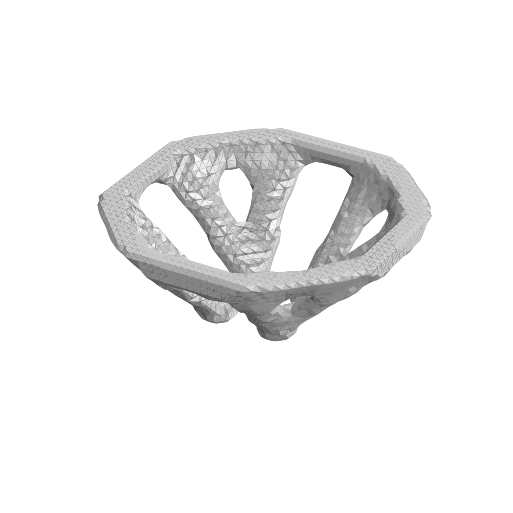

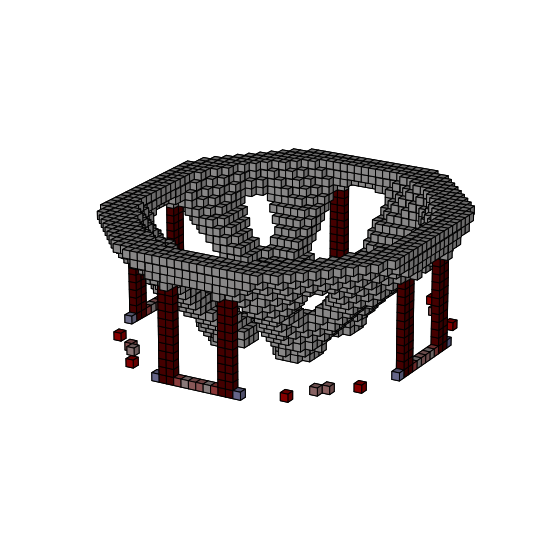

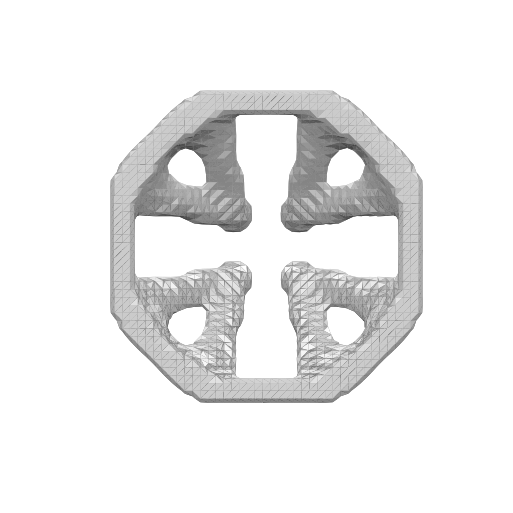

In [1]:
from optimization_sp import run_opt
from optimization_sp import run_batch_opt
import os

# run_batch_opt("Studies/MVP_format_test_1/request_header.json","Studies/MVP_format_test_1","Studies/MVP_format_test_1/bc.json","Resources/mat_lib.json",'Resources/machine.json')

study_folder = "Studies/EMB_Scenario_2_supplier_test"
for i in range(8,9):
    print(i)
    folder_name = "Past/Iter0/"+"config_{}".format(i)
    config_path = os.path.join(study_folder, folder_name)
    # run_opt(os.path.join(study_folder,"Past/Iter0/request_header.json"),os.path.join(config_path,"mmm.json"), os.path.join(study_folder,"bc.json"), "Resources/mat_lib.json",'Resources/machine.json',os.path.join(study_folder,"Past/Iter0/constraints.json"),probe = True, test = False)
    run_opt(os.path.join(study_folder,"Past/Iter0/request_header.json"),os.path.join(config_path,"mmm.json"), os.path.join(study_folder,"bc.json"), "Resources/mat_lib.json",'Resources/machine.json',os.path.join(study_folder,"Past/Iter0/constraints.json"),probe = False, test = True)


8
vf_arr:  [[-1.          0.10534205  0.16147642]
 [-1.          0.20004153  0.13332289]]
mass_vf,time_vf,cost_vf 0.99999 0.16147641509433963 0.13332289466606978
cost_vf
opt1.time_con tf.Tensor(70589.99, shape=(), dtype=float32)
opt1.cost_con tf.Tensor(116665.99, shape=(), dtype=float32)


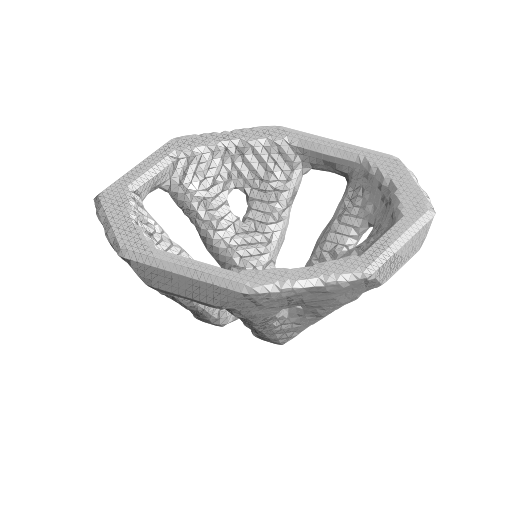

## Result Summary
VF:  tf.Tensor(0.13528222, shape=(), dtype=float32)
Mass: 57.359665 [kg]
Compliance: 1.218331e+01
Time: 58500.47 [min]
Cost: 117077.80 [$]
cutoff 0.44285714285714284
cutoff mass:  tf.Tensor(57.37250000000002, shape=(), dtype=float64)
## Result Summary
VF:  tf.Tensor(0.13528222, shape=(), dtype=float32)
Mass: 57.359665 [kg]
Compliance: 1.044381e+01
Time: 58500.47 [min]
Cost: 117077.80 [$]
Max Disp: 0.49880812429855365 [mm]
comp2 tf.Tensor(10.443812, shape=(), dtype=float32)
Max Disp2: 0.4988081464318314 [mm]


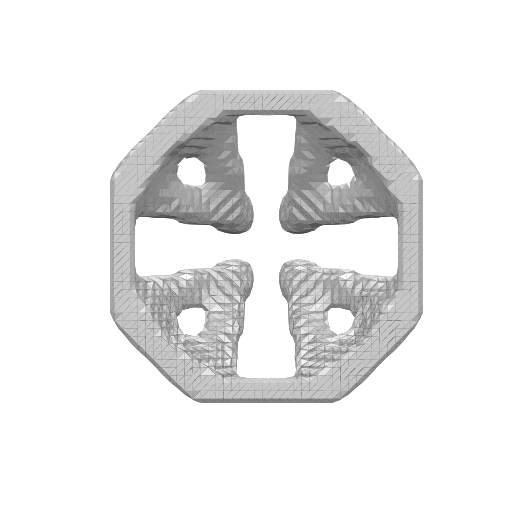

In [1]:
from optimization_sp import run_opt
from optimization_sp import run_batch_opt
import os

study_folder = "Studies/EMB_Scenario_2"
for i in range(8,9):
    print(i)
    folder_name = "Past/Iter0/"+"config_{}".format(i)
    config_path = os.path.join(study_folder, folder_name)
    # run_opt(os.path.join(study_folder,"Past/Iter0/request_header.json"),os.path.join(config_path,"mmm.json"), os.path.join(study_folder,"bc.json"), "Resources/mat_lib.json",'Resources/machine.json',os.path.join(study_folder,"Past/Iter0/constraints.json"),probe = True, test = False)
    run_opt(os.path.join(study_folder,"Past/Iter0/request_header.json"),os.path.join(config_path,"mmm.json"), os.path.join(study_folder,"bc.json"), "Resources/mat_lib.json",'Resources/machine.json',os.path.join(study_folder,"Past/Iter0/constraints.json"),probe = False, test = True)

8
vf_arr:  [[-1.          0.10534205  0.16147642]
 [-1.          0.10510991  0.07003514]]
mass_vf,time_vf,cost_vf 0.99999 0.10534204982597545 0.10510990681373522
cost_vf
opt1.time_con tf.Tensor(46074.99, shape=(), dtype=float32)
opt1.cost_con tf.Tensor(91999.016, shape=(), dtype=float32)


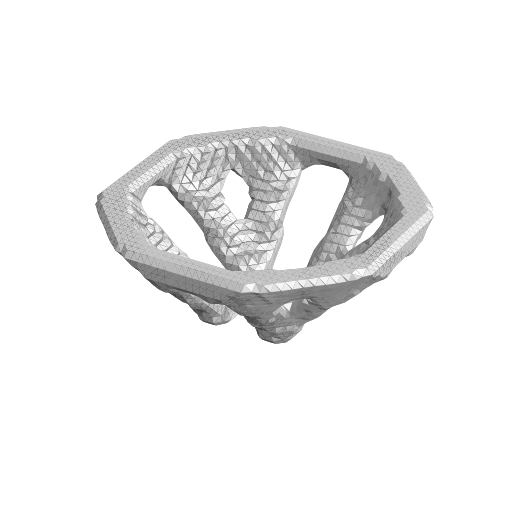

## Result Summary
VF:  tf.Tensor(0.105729274, shape=(), dtype=float32)
Mass: 44.829216 [kg]
Compliance: 1.577579e+01
Time: 46140.16 [min]
Cost: 92332.47 [$]
cutoff 0.49183673469387756
cutoff mass:  tf.Tensor(45.05000000000001, shape=(), dtype=float64)
## Result Summary
VF:  tf.Tensor(0.105729274, shape=(), dtype=float32)
Mass: 44.829216 [kg]
Compliance: 1.342401e+01
Time: 46140.16 [min]
Cost: 92332.47 [$]
Max Disp: 2.1571844428849523 [mm]
comp2 tf.Tensor(15.775793, shape=(), dtype=float32)


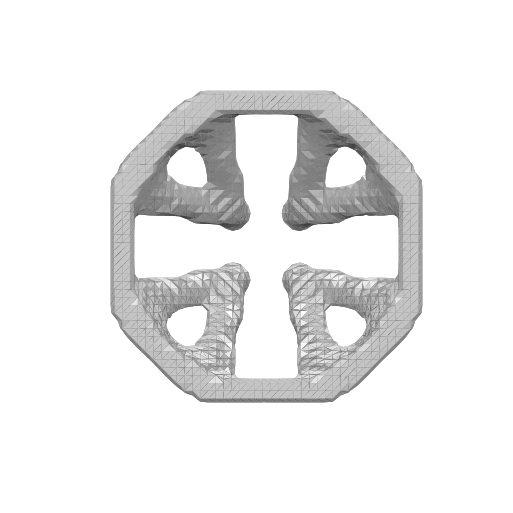

In [1]:
from optimization_sp import run_opt
from optimization_sp import run_batch_opt
import os

study_folder = "Studies/EMB_Scenario_2_supplier_test"
for i in range(8,9):
    print(i)
    folder_name = "config_{}".format(i)
    config_path = os.path.join(study_folder, folder_name)
    # run_opt(os.path.join(study_folder,"Past/Iter0/request_header.json"),os.path.join(config_path,"mmm.json"), os.path.join(study_folder,"bc.json"), "Resources/mat_lib.json",'Resources/machine.json',os.path.join(study_folder,"Past/Iter0/constraints.json"),probe = True, test = False)
    run_opt(os.path.join(study_folder,"request_header.json"),os.path.join(config_path,"mmm.json"), os.path.join(study_folder,"bc.json"), "Resources/mat_lib.json",'Resources/machine.json',os.path.join(study_folder,"constraints.json"),probe = False, test = True)

In [2]:
# from optimization_sp import run_opt
# from optimization_sp import run_batch_opt
# import os

# # run_batch_opt("Studies/MVP_format_test_1/request_header.json","Studies/MVP_format_test_1","Studies/MVP_format_test_1/bc.json","Resources/mat_lib.json",'Resources/machine.json')

# study_folder = "Studies/Engine_Mounting_Bracket_MVP_test"
# for i in range(1,2):
#     print(i)
#     folder_name = "config_{}".format(i)
#     config_path = os.path.join(study_folder, folder_name)
#     run_opt(os.path.join(study_folder,"request_header.json"),os.path.join(config_path,"mmm.json"), os.path.join(study_folder,"bc.json"), "Resources/mat_lib.json",'Resources/machine.json',os.path.join(study_folder,"constraints.json"),probe = True, test = False)
#     run_opt(os.path.join(study_folder,"request_header.json"),os.path.join(config_path,"mmm.json"), os.path.join(study_folder,"bc.json"), "Resources/mat_lib.json",'Resources/machine.json',os.path.join(study_folder,"constraints.json"),probe = False, test = False)


In [1]:
# from optimization_sp import run_opt
# from optimization_sp import run_batch_opt
# import os

# # run_batch_opt("Studies/MVP_format_test_1/request_header.json","Studies/MVP_format_test_1","Studies/MVP_format_test_1/bc.json","Resources/mat_lib.json",'Resources/machine.json')

# study_folder = "Studies/Engine_Mounting_Bracket_MVP_test"
# for i in range(1,10):
#     if i%3!=0:
#         print(i)
#         folder_name = "Past/Iter_passive/"+"config_{}".format(i)
#         config_path = os.path.join(study_folder, folder_name)
#         # run_opt(os.path.join(study_folder,"Past/Iter0/request_header.json"),os.path.join(config_path,"mmm.json"), os.path.join(study_folder,"bc.json"), "Resources/mat_lib.json",'Resources/machine.json',os.path.join(study_folder,"Past/Iter0/constraints.json"),probe = True, test = False)
#         run_opt(os.path.join(study_folder,"Past/Iter_passive/request_header.json"),os.path.join(config_path,"mmm.json"), os.path.join(study_folder,"bc.json"), "Resources/mat_lib.json",'Resources/machine.json',os.path.join(study_folder,"Past/Iter_passive/constraints.json"),probe = False, test = True)

In [4]:
import numpy as np
d = np.array([[1,2,3],[3,4,5]])
print(np.argmax(np.min(d,axis = 0)))

2


1
vf_arr:  [[-1.          0.08019597  0.08019597]
 [-1.          0.07195772  0.0479581 ]]
mass_vf,time_vf,cost_vf 0.46296296296296285 0.08019597267170084 0.07195771897733642
cost_vf
opt1.time_con tf.Tensor(89280.01, shape=(), dtype=float32)
opt1.cost_con tf.Tensor(175000.0, shape=(), dtype=float32)


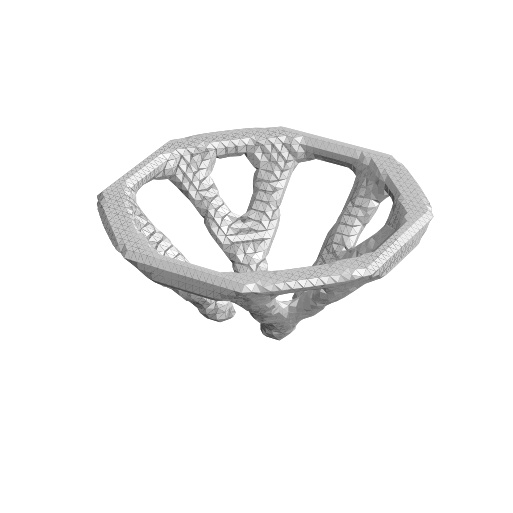

## Result Summary
VF:  tf.Tensor(0.07039088, shape=(), dtype=float32)
Mass: 76.022156 [kg]
Compliance: 6.731230e-01
Time: 79175.86 [min]
Cost: 172946.30 [$]
max d:  0.03850662286911031
comp:  0.6731230020523071
vf: tf.Tensor(0.07039088, shape=(), dtype=float32)
0.5 vf: tf.Tensor(0.0712890625, shape=(), dtype=float64)
0.2 mass: tf.Tensor(89.26875000000003, shape=(), dtype=float64)
cutoff 0.5408163265306123
cutoff mass:  tf.Tensor(76.19062500000003, shape=(), dtype=float64)
## Result Summary
VF:  tf.Tensor(0.07039088, shape=(), dtype=float32)
Mass: 76.022156 [kg]
Compliance: 6.731229e-01
Time: 79175.86 [min]
Cost: 172946.30 [$]
Max Disp: 0.038506618841182005 [mm]
2
vf_arr:  [[-0.58692705  1.         -0.58692705]
 [ 0.16774413  1.          0.45089968]]
mass_vf,time_vf,cost_vf 0.46296296296296285 -0.5869270462633451 0.16774412735391186
cost_vf
opt1.time_con tf.Tensor(99189.586, shape=(), dtype=float32)
opt1.cost_con tf.Tensor(159387.5, shape=(), dtype=float32)
opt1.c_0 tf.Tensor(2.4096467e

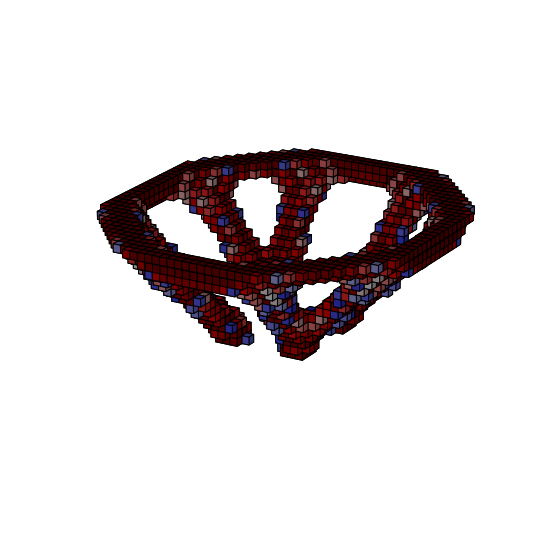

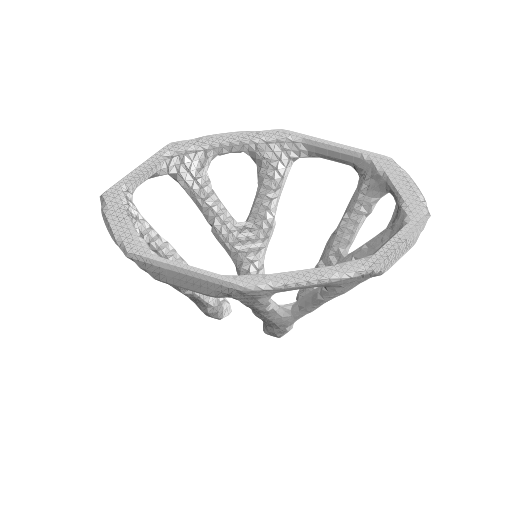

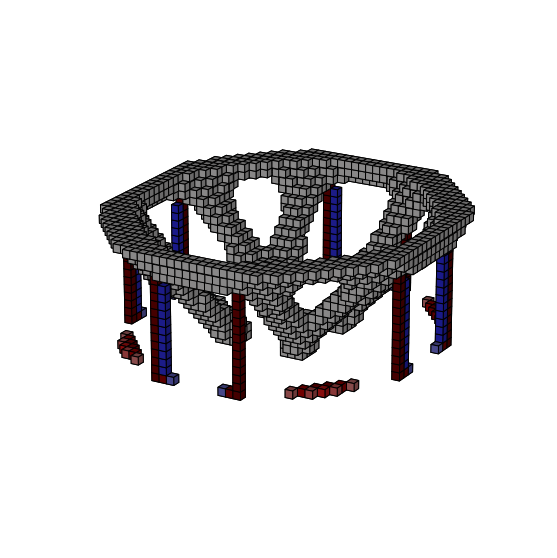

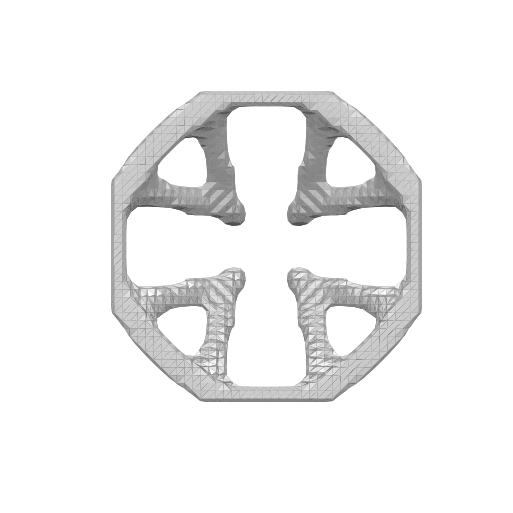

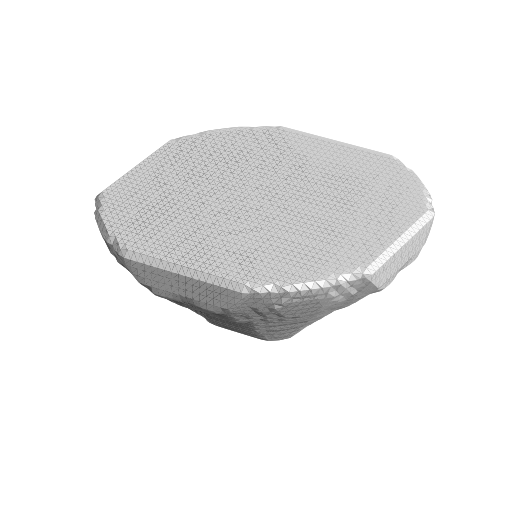

## Result Summary
VF:  tf.Tensor(0.46383888, shape=(), dtype=float32)
Mass: 500.946014 [kg]
Compliance: 9.905490e-02
Time: 33588.46 [min]
Cost: 103930.38 [$]
max d:  0.004302569168848096
comp:  0.09905489534139633
vf: tf.Tensor(0.46383888, shape=(), dtype=float32)
0.5 vf: tf.Tensor(0.48421875, shape=(), dtype=float64)
0.2 mass: tf.Tensor(544.0500000000001, shape=(), dtype=float64)
cutoff 0.5571428571428572
cutoff mass:  tf.Tensor(506.9250000000001, shape=(), dtype=float64)
## Result Summary
VF:  tf.Tensor(0.46383888, shape=(), dtype=float32)
Mass: 500.946014 [kg]
Compliance: 9.905490e-02
Time: 33588.46 [min]
Cost: 103930.38 [$]
Max Disp: 0.004302569437735208 [mm]
3
vf_arr:  [[-1.39851935  1.         -1.39851935]
 [-0.15368952  1.          0.23833333]]
mass_vf,time_vf,cost_vf 0.46296296296296285 -1.3985193548387096 -0.15368951612903214
cost_vf
opt1.time_con 89280.11228011698
opt1.cost_con 174999.36994749223
opt1.c_0 tf.Tensor(2.4096467e-12, shape=(), dtype=float32)


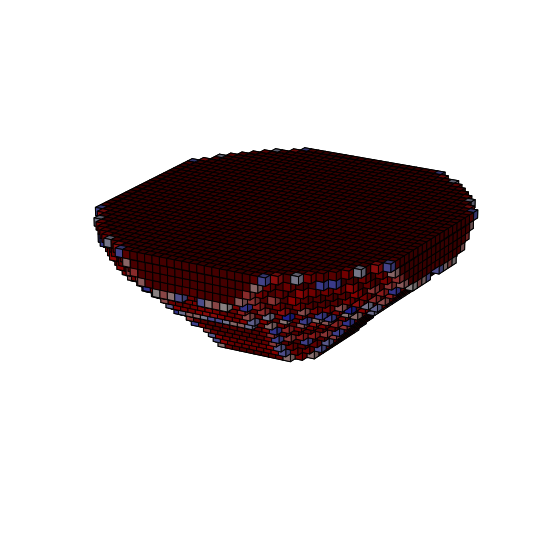

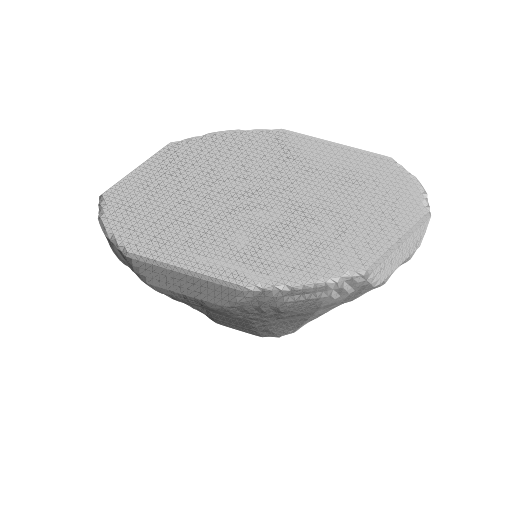

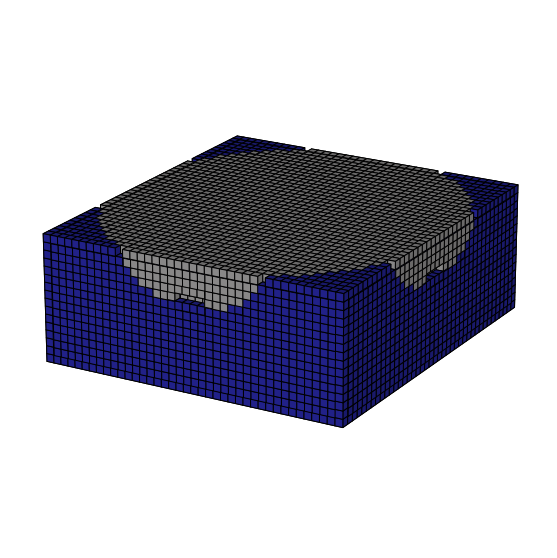

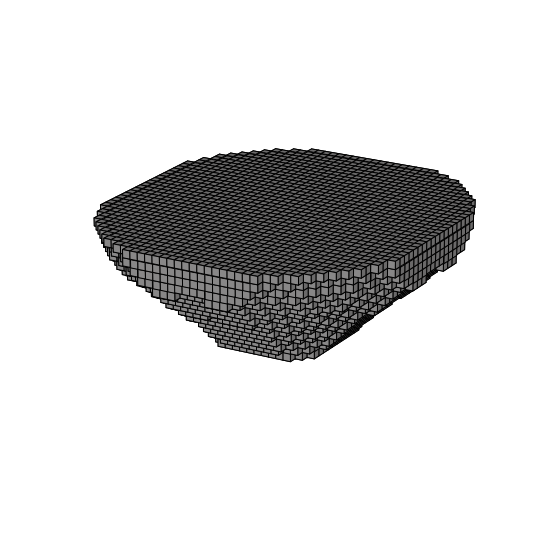

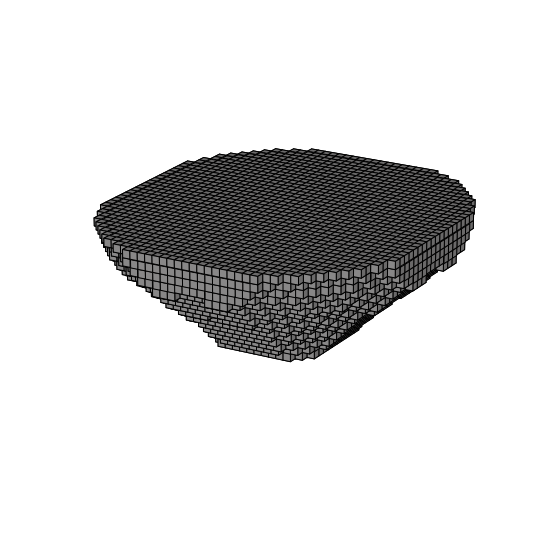

...

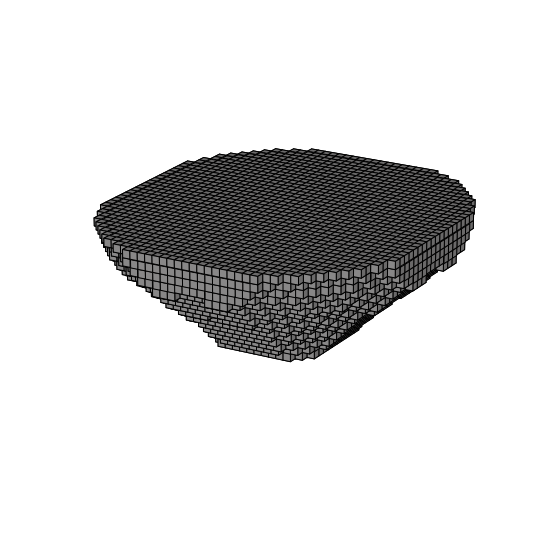

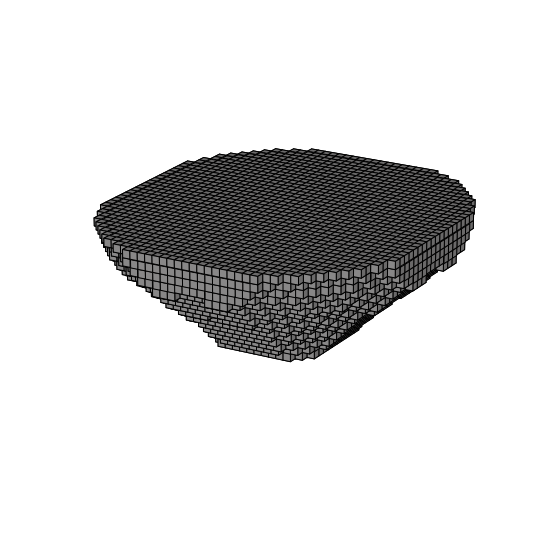

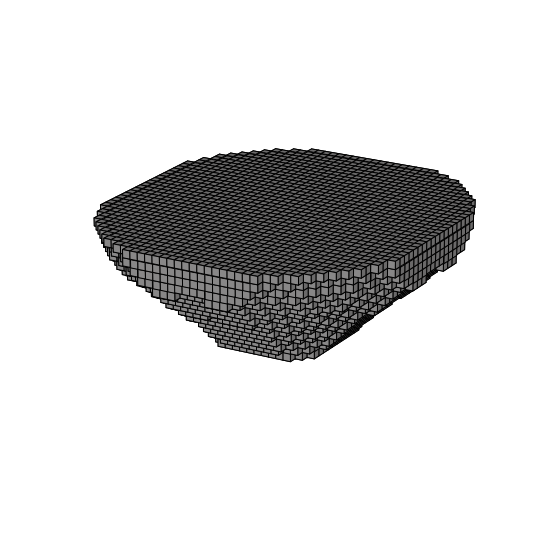

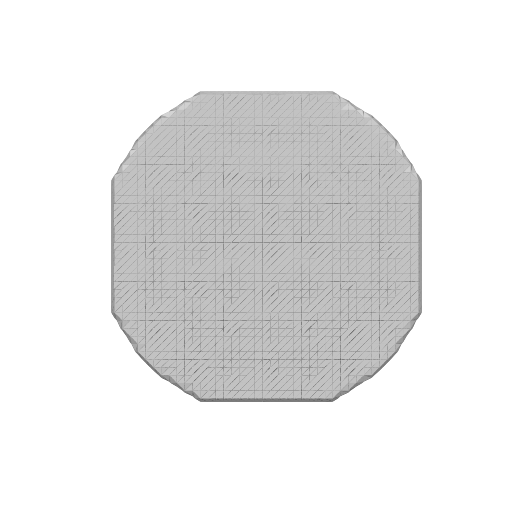

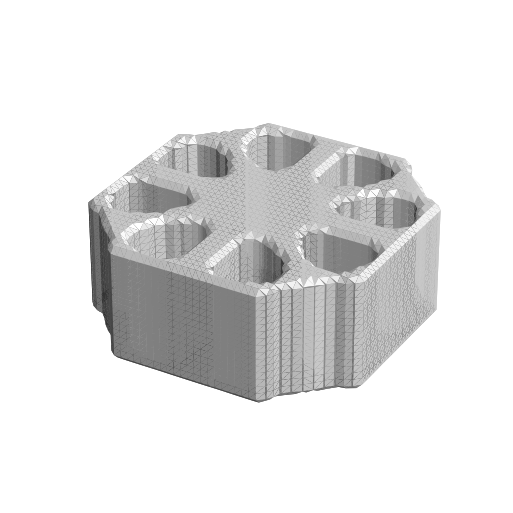

## Result Summary
VF:  tf.Tensor(0.46491456, shape=(), dtype=float32)
Mass: 502.107758 [kg]
Compliance: 1.250117e-01
Time: 10670.17 [min]
Cost: 45790.70 [$]
max d:  0.005317836201019754
comp:  0.12501174211502075
vf: tf.Tensor(0.46491456, shape=(), dtype=float32)
0.5 vf: tf.Tensor(0.4675, shape=(), dtype=float64)
0.2 mass: tf.Tensor(558.9000000000001, shape=(), dtype=float64)
cutoff 0.5244897959183674
cutoff mass:  tf.Tensor(504.90000000000015, shape=(), dtype=float64)
## Result Summary
VF:  tf.Tensor(0.46491456, shape=(), dtype=float32)
Mass: 502.107758 [kg]
Compliance: 1.250117e-01
Time: 10670.17 [min]
Cost: 45790.70 [$]
Max Disp: 0.005317836199942399 [mm]
4
vf_arr:  [[-1.          0.04887791 -1.        ]
 [-1.          0.03945125 -1.        ]]
mass_vf,time_vf,cost_vf 0.28216704288939043 0.048877906594490345 0.039451253935068036
cost_vf
opt1.time_con tf.Tensor(89280.0, shape=(), dtype=float32)
opt1.cost_con tf.Tensor(174999.78, shape=(), dtype=float32)


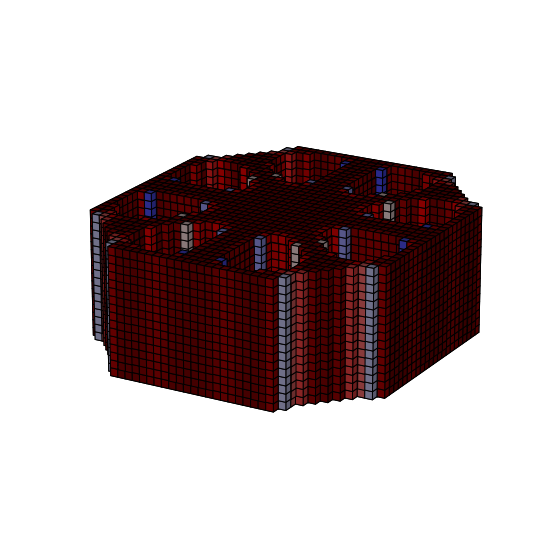

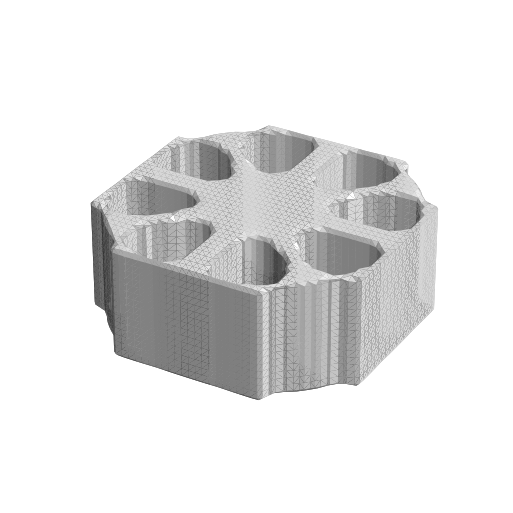

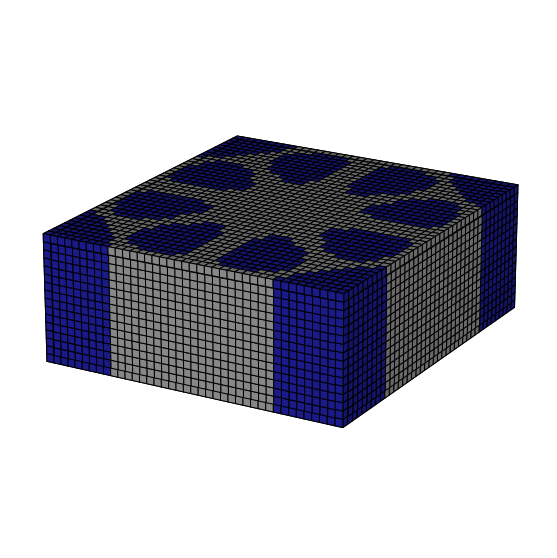

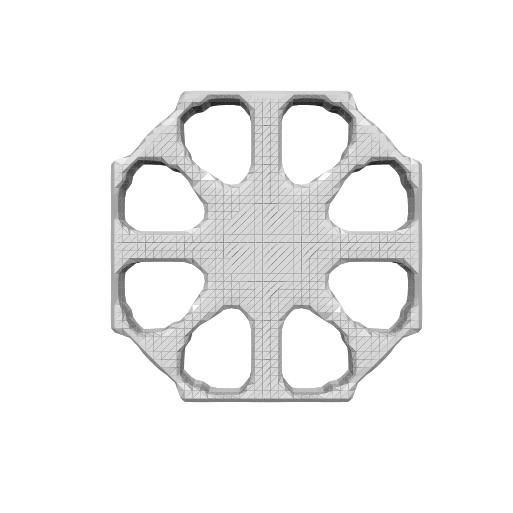

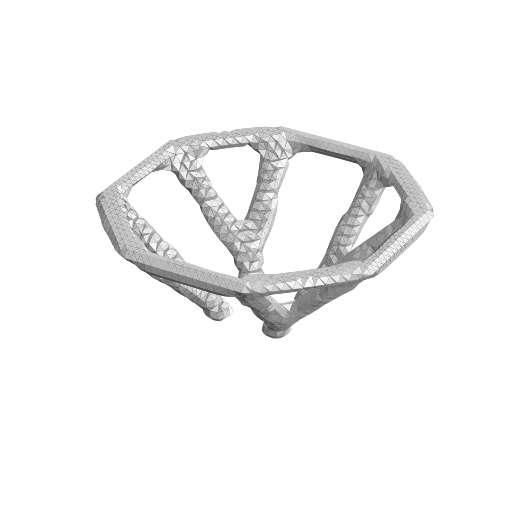

## Result Summary
VF:  tf.Tensor(0.04070704, shape=(), dtype=float32)
Mass: 72.132881 [kg]
Compliance: 7.334470e-01
Time: 72616.43 [min]
Cost: 176315.28 [$]
max d:  0.04619454980969972
comp:  0.7334469556808472
vf: tf.Tensor(0.04070704, shape=(), dtype=float32)
0.5 vf: tf.Tensor(0.041328125, shape=(), dtype=float64)
0.2 mass: tf.Tensor(94.41437500000002, shape=(), dtype=float64)
cutoff 0.5244897959183674
cutoff mass:  tf.Tensor(72.54125000000002, shape=(), dtype=float64)
## Result Summary
VF:  tf.Tensor(0.04070704, shape=(), dtype=float32)
Mass: 72.132881 [kg]
Compliance: 7.334469e-01
Time: 72616.43 [min]
Cost: 176315.28 [$]
Max Disp: 0.04619454331042274 [mm]
5
con supplier
6
con supplier
7
vf_arr:  [[-0.51181078  1.          1.        ]
 [ 0.19619048  1.          1.        ]]
mass_vf,time_vf,cost_vf 0.99999 -0.5118107833163756 0.19619047619047614
cost_vf
opt1.time_con tf.Tensor(99201.41, shape=(), dtype=float32)
opt1.cost_con tf.Tensor(159166.75, shape=(), dtype=float32)
opt1.c_0 tf.T

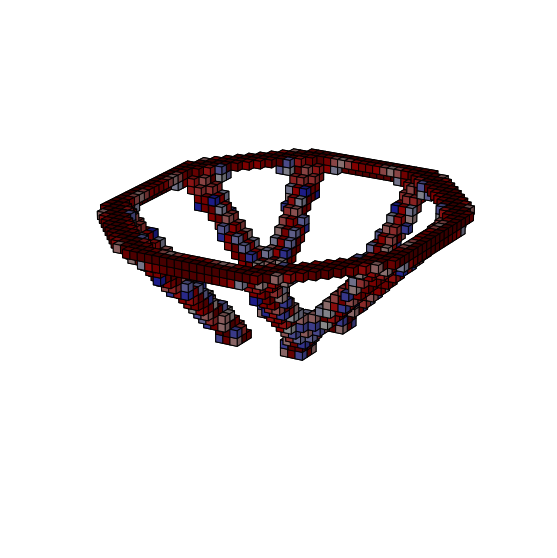

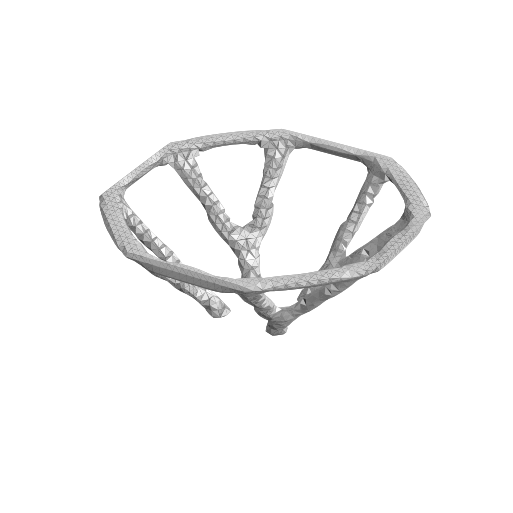

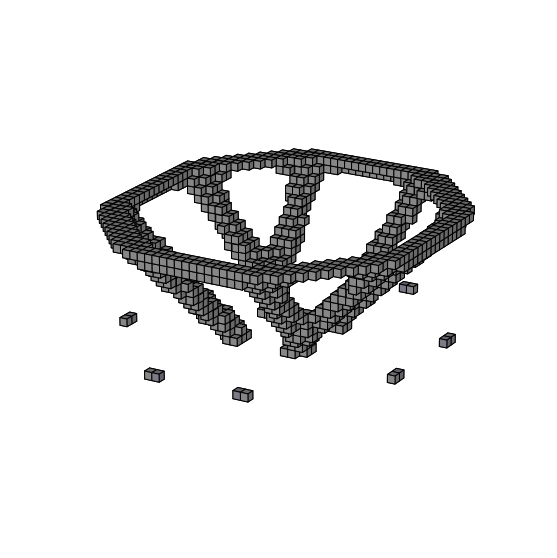

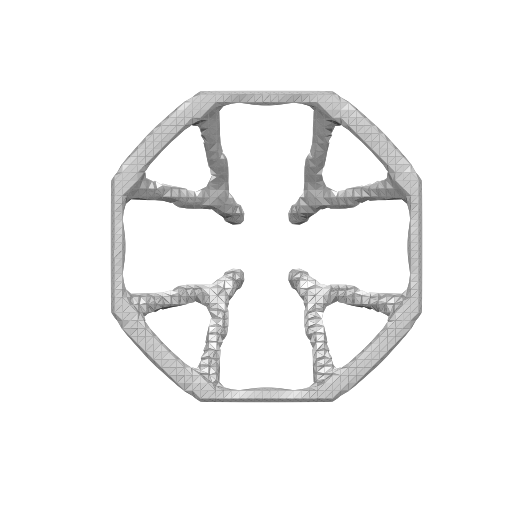

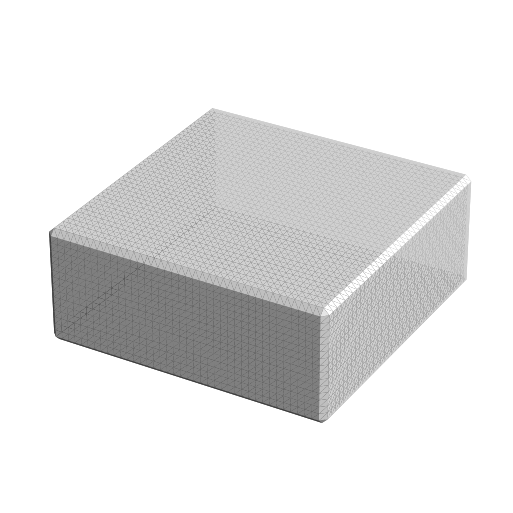

## Result Summary
VF:  tf.Tensor(0.9999997, shape=(), dtype=float32)
Mass: 423.999878 [kg]
Compliance: 2.203730e+00
Time: 115.02 [min]
Cost: 1118.06 [$]
max d:  0.086487816153266
comp:  2.203730344772339
vf: tf.Tensor(0.9999997, shape=(), dtype=float32)
0.5 vf: tf.Tensor(1.0, shape=(), dtype=float64)
0.2 mass: tf.Tensor(424.00000000000006, shape=(), dtype=float64)
cutoff 0.9
cutoff mass:  tf.Tensor(424.00000000000006, shape=(), dtype=float64)
## Result Summary
VF:  tf.Tensor(0.9999997, shape=(), dtype=float32)
Mass: 423.999878 [kg]
Compliance: 2.203730e+00
Time: 115.02 [min]
Cost: 1118.06 [$]
Max Disp: 0.08648781116549775 [mm]
8
vf_arr:  [[-1.          0.20427272  0.20427272]
 [-1.          0.20004153  0.13332289]]
mass_vf,time_vf,cost_vf 0.99999 0.20427271673965774 0.2000415302056472
cost_vf
opt1.time_con tf.Tensor(89279.984, shape=(), dtype=float32)
opt1.cost_con tf.Tensor(174999.0, shape=(), dtype=float32)
opt1.c_0 tf.Tensor(4.9179274e-09, shape=(), dtype=float32)


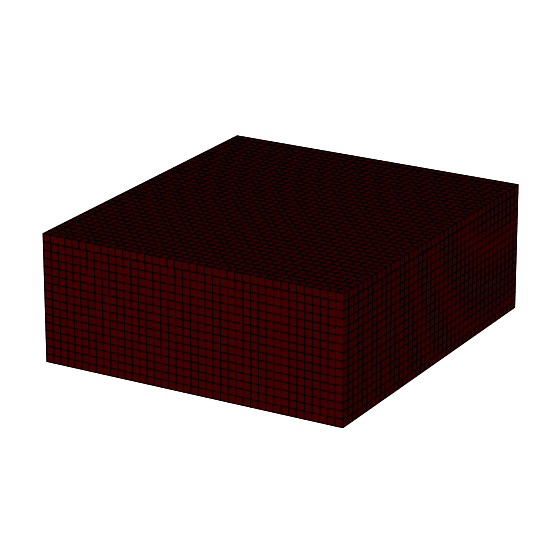

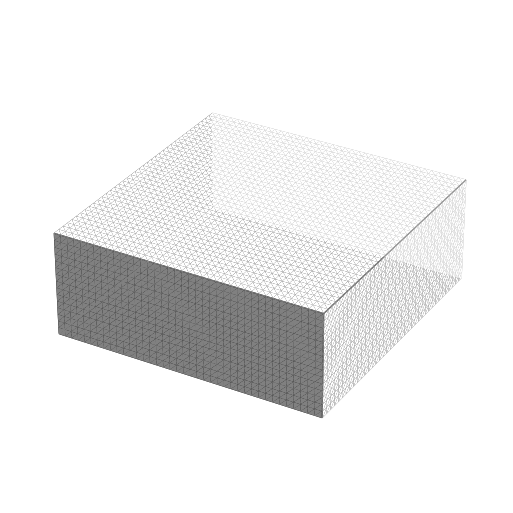

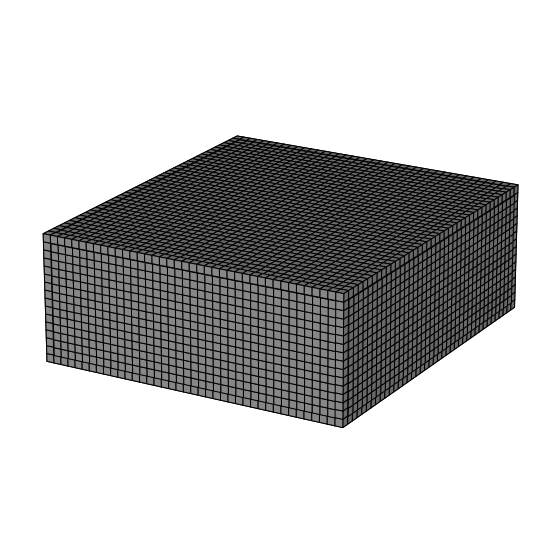

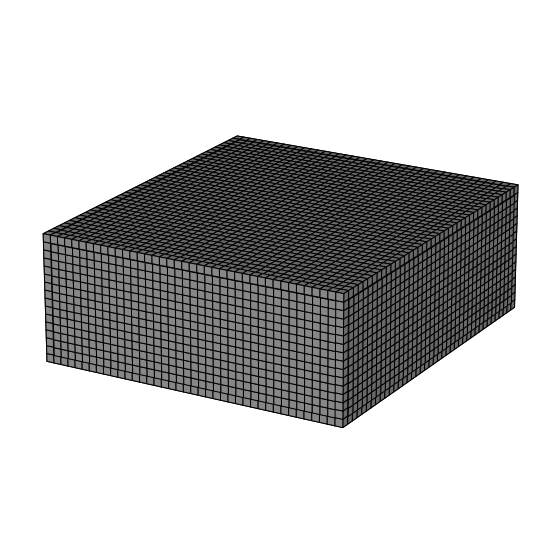

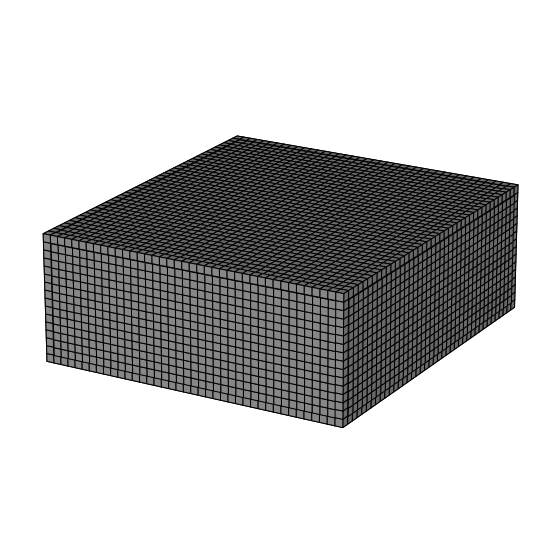

...

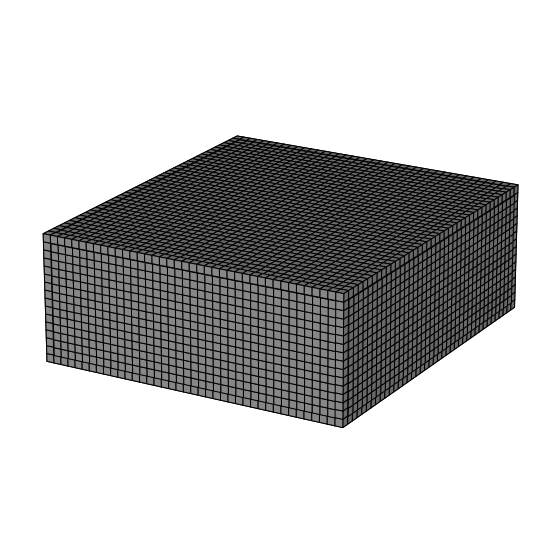

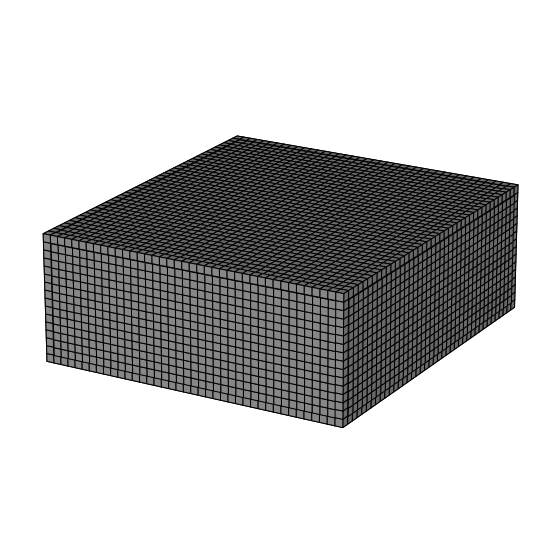

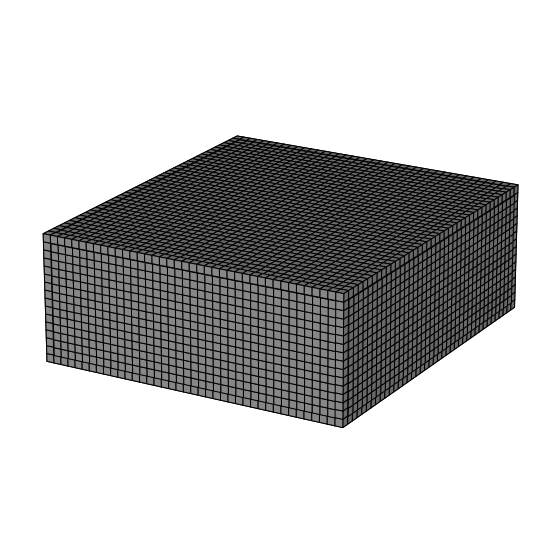

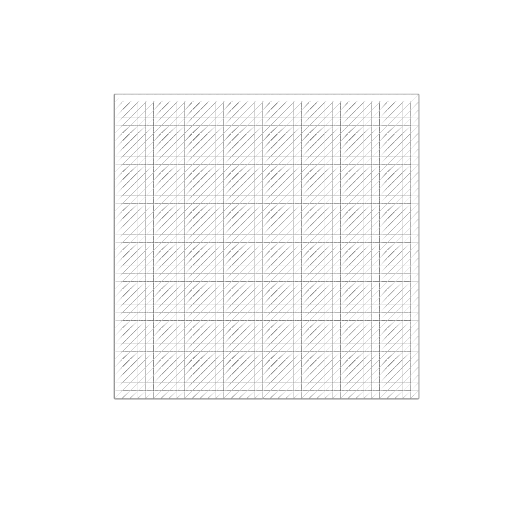

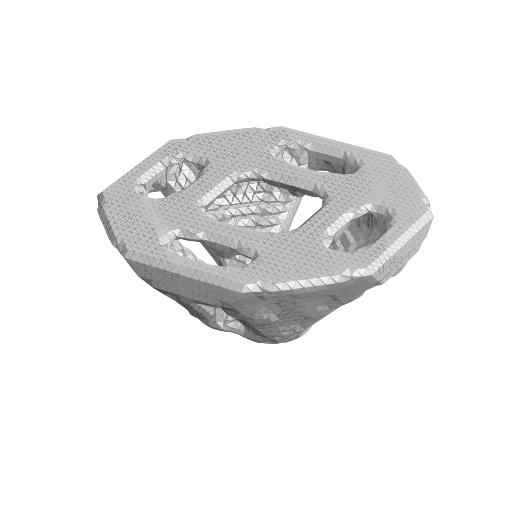

## Result Summary
VF:  tf.Tensor(0.2017366, shape=(), dtype=float32)
Mass: 85.536324 [kg]
Compliance: 6.439407e+00
Time: 87441.97 [min]
Cost: 175018.69 [$]
max d:  0.2915577952103133
comp:  6.439406871795654
vf: tf.Tensor(0.2017366, shape=(), dtype=float32)
0.5 vf: tf.Tensor(0.199296875, shape=(), dtype=float64)
0.2 mass: tf.Tensor(92.31937500000002, shape=(), dtype=float64)
cutoff 0.3938775510204082
cutoff mass:  tf.Tensor(85.81031250000001, shape=(), dtype=float64)
## Result Summary
VF:  tf.Tensor(0.2017366, shape=(), dtype=float32)
Mass: 85.536324 [kg]
Compliance: 6.439407e+00
Time: 87441.97 [min]
Cost: 175018.69 [$]
Max Disp: 0.29155783168843885 [mm]
9
vf_arr:  [[-1.39851935  1.          1.        ]
 [-0.16976478  1.          1.        ]]
mass_vf,time_vf,cost_vf 0.99999 -1.3985193548387096 -0.16976478494623648
cost_vf
opt1.time_con 89280.11228011698
opt1.cost_con 174999.37510226335
opt1.c_0 tf.Tensor(9.837997e-10, shape=(), dtype=float32)


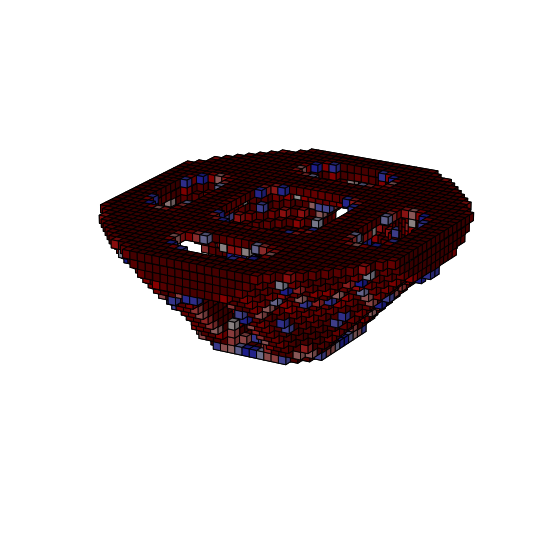

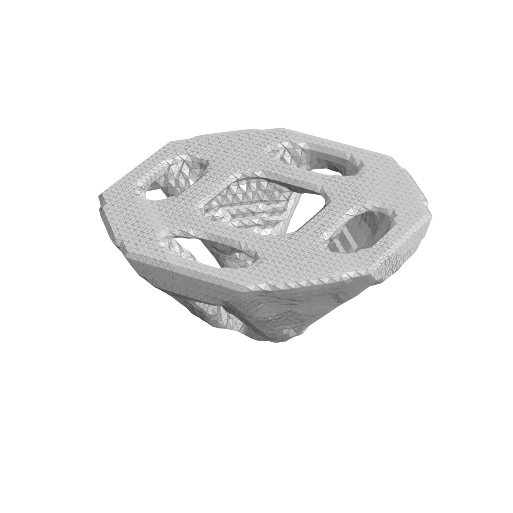

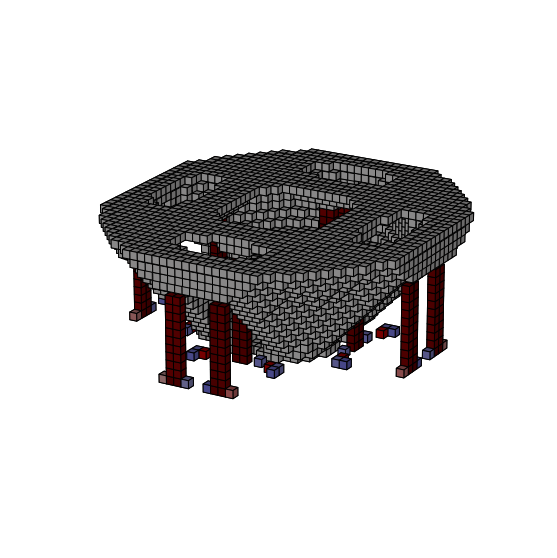

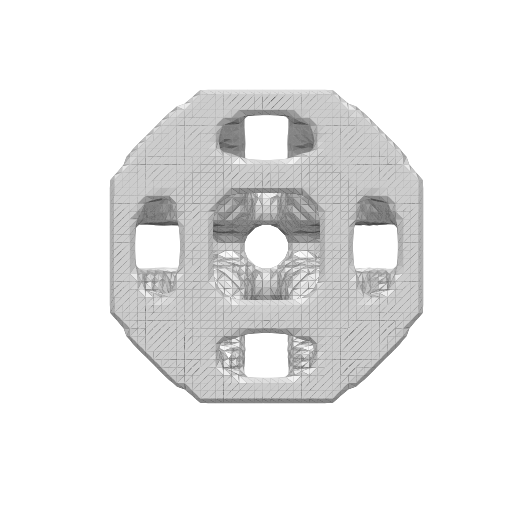

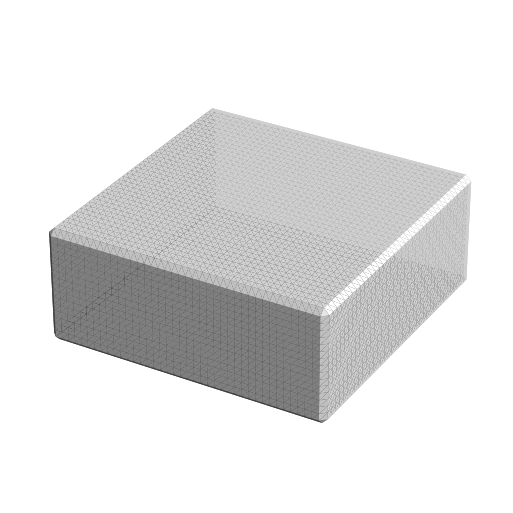

## Result Summary
VF:  tf.Tensor(0.99999017, shape=(), dtype=float32)
Mass: 423.995850 [kg]
Compliance: 2.203712e+00
Time: 329.97 [min]
Cost: 2037.86 [$]
max d:  0.08648784527978441
comp:  2.203712224960327
vf: tf.Tensor(0.99999017, shape=(), dtype=float32)
0.5 vf: tf.Tensor(1.0, shape=(), dtype=float64)
0.2 mass: tf.Tensor(424.00000000000006, shape=(), dtype=float64)
cutoff 0.9
cutoff mass:  tf.Tensor(424.00000000000006, shape=(), dtype=float64)
## Result Summary
VF:  tf.Tensor(0.99999017, shape=(), dtype=float32)
Mass: 423.995850 [kg]
Compliance: 2.203712e+00
Time: 329.97 [min]
Cost: 2037.86 [$]
Max Disp: 0.08648784518702483 [mm]
1
vf_arr:  [[-1.          0.04006652  0.04006652]
 [-1.          0.04110106  0.027387  ]]
mass_vf,time_vf,cost_vf 0.03703703703703703 0.04006652283351313 0.04110106418431051
cost_vf
opt1.time_con tf.Tensor(44639.996, shape=(), dtype=float32)
opt1.cost_con tf.Tensor(100000.0, shape=(), dtype=float32)


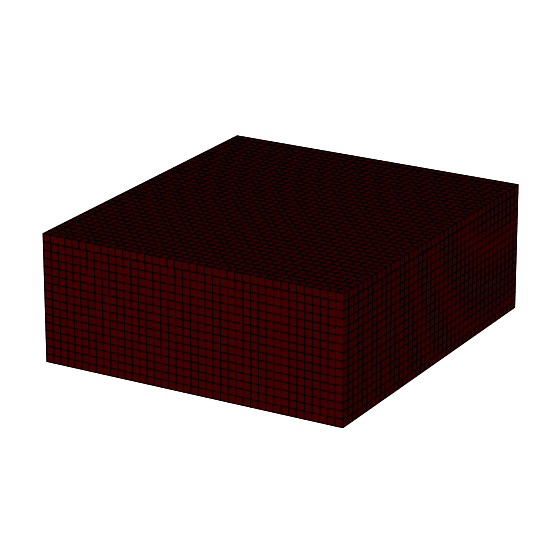

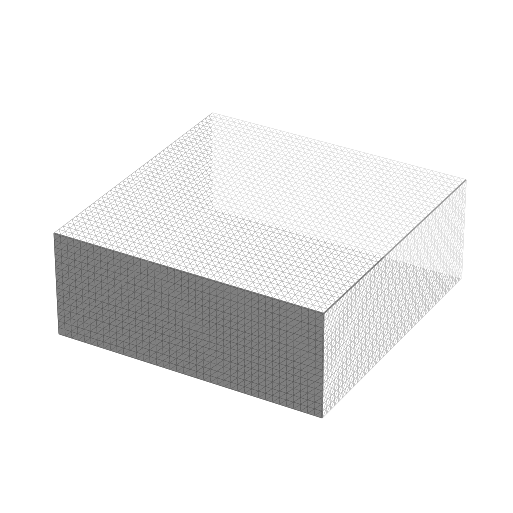

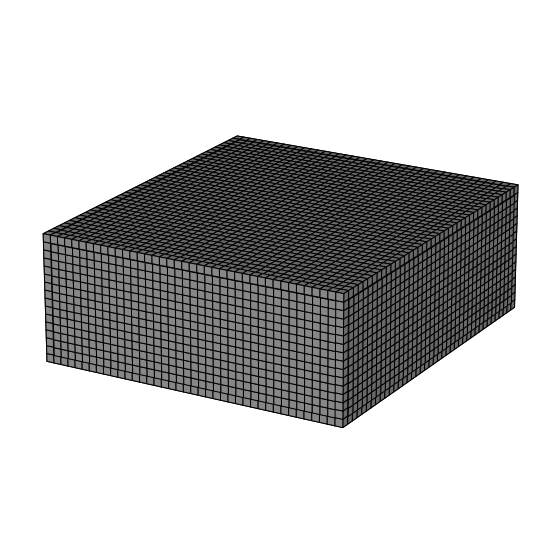

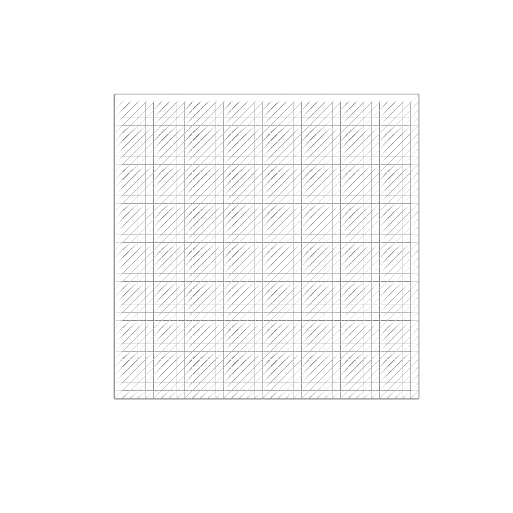

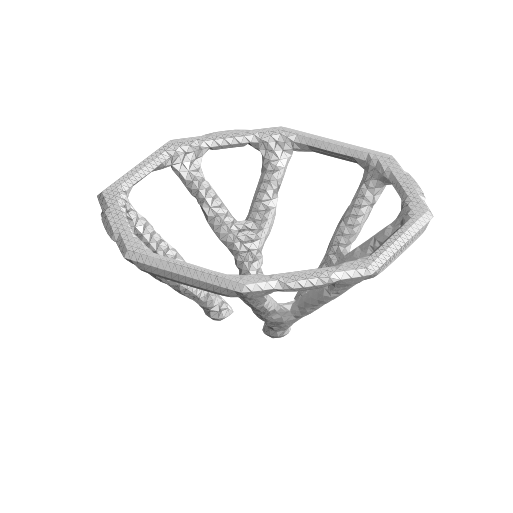

## Result Summary
VF:  tf.Tensor(0.036991943, shape=(), dtype=float32)
Mass: 39.951298 [kg]
Compliance: 1.378564e+00
Time: 40731.94 [min]
Cost: 88946.34 [$]
max d:  0.0899148980605213
comp:  1.3785635232925415
vf: tf.Tensor(0.036991943, shape=(), dtype=float32)
0.5 vf: tf.Tensor(0.0375390625, shape=(), dtype=float64)
0.2 mass: tf.Tensor(51.806250000000006, shape=(), dtype=float64)
cutoff 0.5081632653061224
cutoff mass:  tf.Tensor(40.16250000000001, shape=(), dtype=float64)
## Result Summary
VF:  tf.Tensor(0.036991943, shape=(), dtype=float32)
Mass: 39.951298 [kg]
Compliance: 1.378564e+00
Time: 40731.94 [min]
Cost: 88946.34 [$]
Max Disp: 0.08991496145662703 [mm]
2
vf_arr:  [[0.2074196  1.         0.2074196 ]
 [0.53178024 1.         0.69358053]]
mass_vf,time_vf,cost_vf 0.03703703703703703 0.2074196017014006 0.5317802368472141
cost_vf
opt1.time_con tf.Tensor(49597.16, shape=(), dtype=float32)
opt1.cost_con tf.Tensor(91205.29, shape=(), dtype=float32)
3
vf_arr:  [[-0.19851935  1.         -

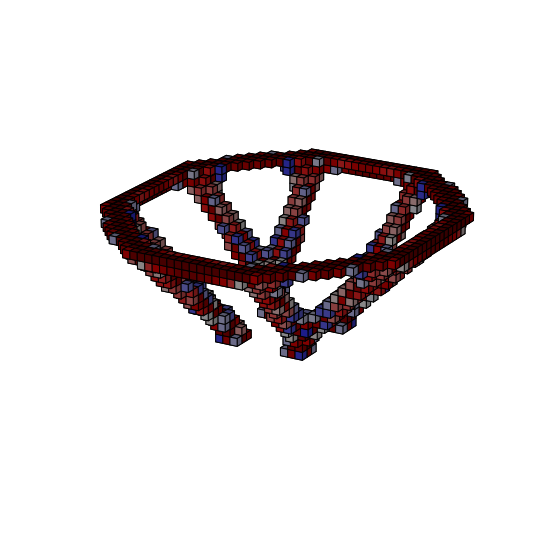

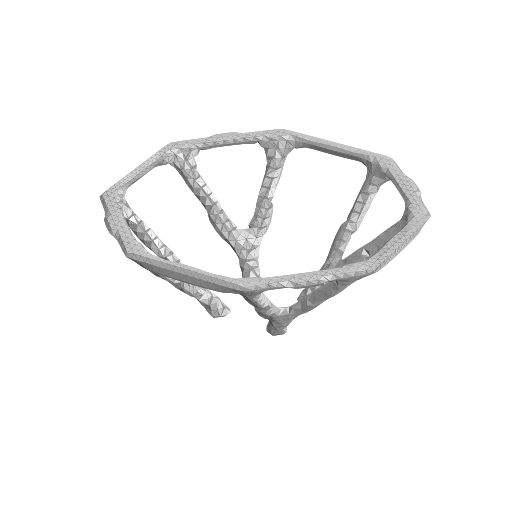

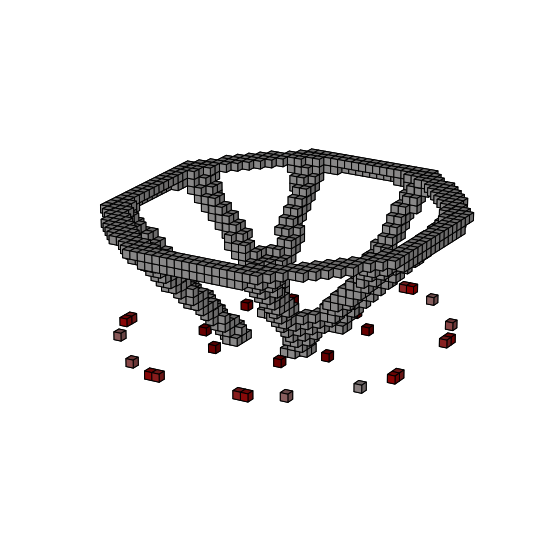

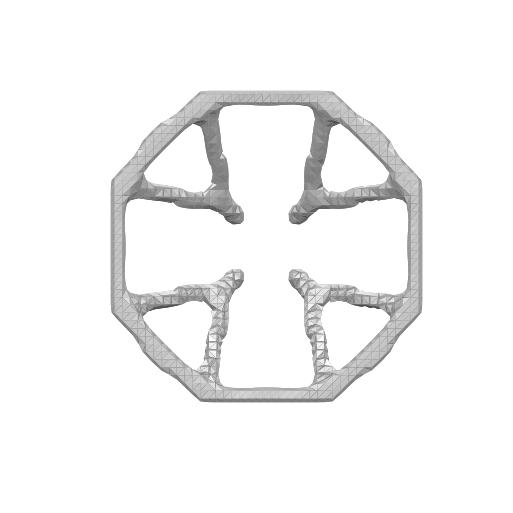

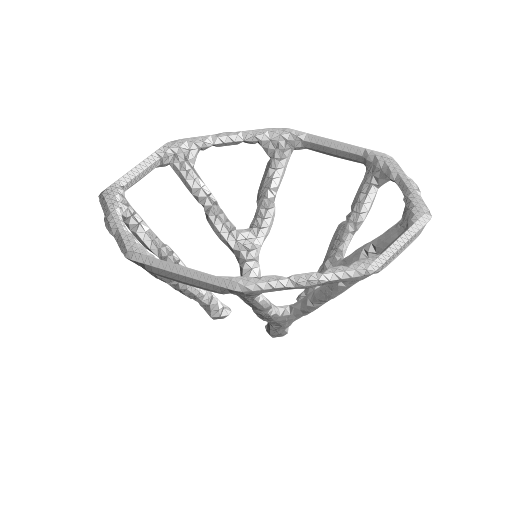

## Result Summary
VF:  tf.Tensor(0.022935553, shape=(), dtype=float32)
Mass: 40.641800 [kg]
Compliance: 1.372623e+00
Time: 41375.98 [min]
Cost: 100432.23 [$]
max d:  0.1033781496744067
comp:  1.3726228475570679
vf: tf.Tensor(0.022935553, shape=(), dtype=float32)
0.5 vf: tf.Tensor(0.0216015625, shape=(), dtype=float64)
0.2 mass: tf.Tensor(60.912500000000016, shape=(), dtype=float64)
cutoff 0.4755102040816327
cutoff mass:  tf.Tensor(42.707968750000006, shape=(), dtype=float64)
## Result Summary
VF:  tf.Tensor(0.022935553, shape=(), dtype=float32)
Mass: 40.641800 [kg]
Compliance: 1.372623e+00
Time: 41375.98 [min]
Cost: 100432.23 [$]
Max Disp: 0.10337799007551664 [mm]
5
con supplier
6
con supplier
7
vf_arr:  [[0.24502611 1.         1.        ]
 [0.54294303 1.         1.        ]]
mass_vf,time_vf,cost_vf 0.0943396226415094 0.24502610700481453 0.5429430262671107
cost_vf
opt1.time_con tf.Tensor(49597.152, shape=(), dtype=float32)
opt1.cost_con tf.Tensor(90986.66, shape=(), dtype=float32)
8
vf

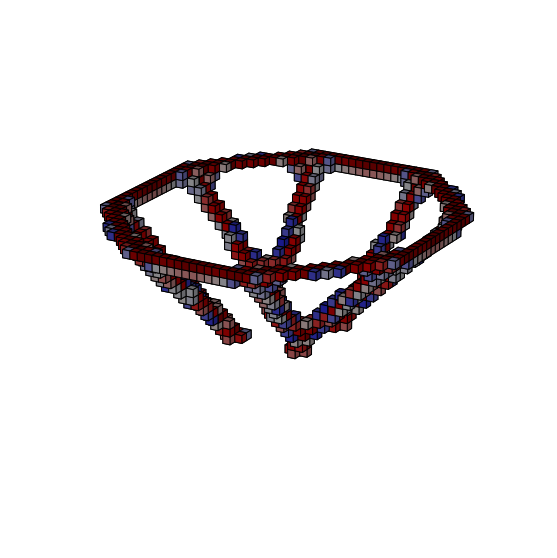

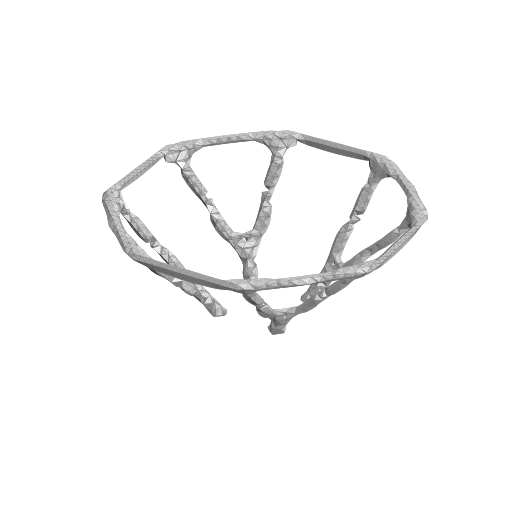

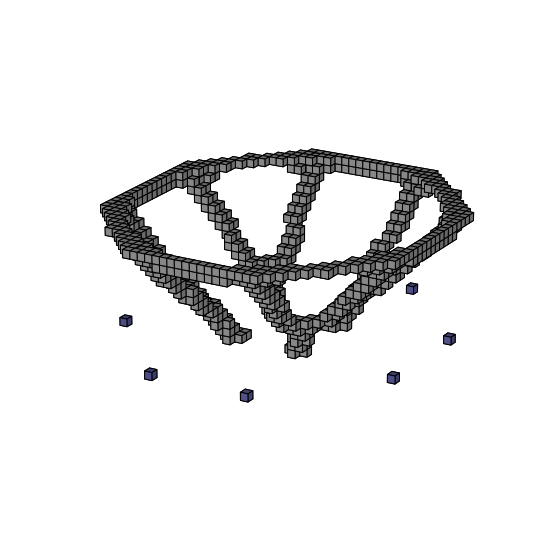

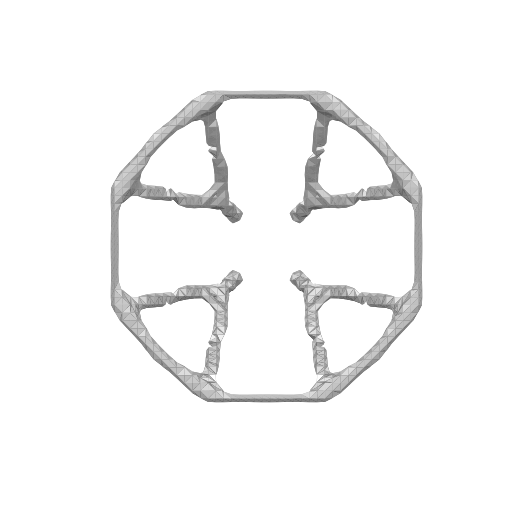

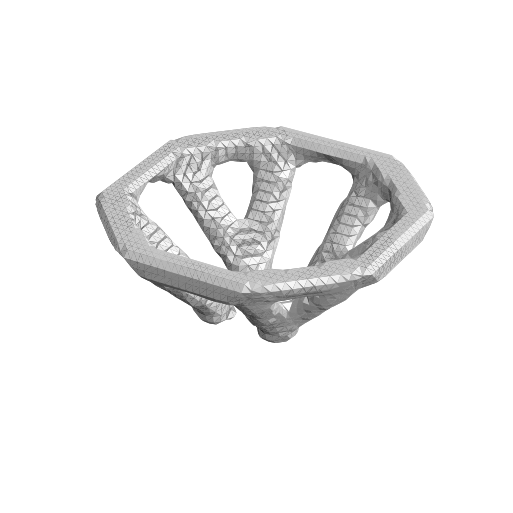

## Result Summary
VF:  tf.Tensor(0.09493715, shape=(), dtype=float32)
Mass: 40.253357 [kg]
Compliance: 1.473210e+01
Time: 44515.81 [min]
Cost: 89080.51 [$]
max d:  0.6990370236206218
comp:  14.732097625732422
vf: tf.Tensor(0.09493715, shape=(), dtype=float32)
0.5 vf: tf.Tensor(0.0933203125, shape=(), dtype=float64)
0.2 mass: tf.Tensor(46.755937500000016, shape=(), dtype=float64)
cutoff 0.44285714285714284
cutoff mass:  tf.Tensor(40.478750000000005, shape=(), dtype=float64)
## Result Summary
VF:  tf.Tensor(0.09493715, shape=(), dtype=float32)
Mass: 40.253357 [kg]
Compliance: 1.473210e+01
Time: 44515.81 [min]
Cost: 89080.51 [$]
Max Disp: 0.6990369933034207 [mm]
9
vf_arr:  [[-0.19851935  1.          1.        ]
 [ 0.33426747  1.          1.        ]]
mass_vf,time_vf,cost_vf 0.0943396226415094 -0.19851935483870964 0.3342674731182794
cost_vf
opt1.time_con 44640.01608070966
opt1.cost_con 99999.21347691507


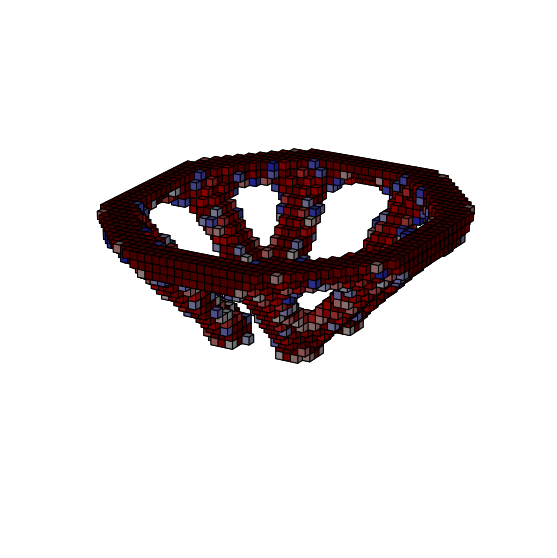

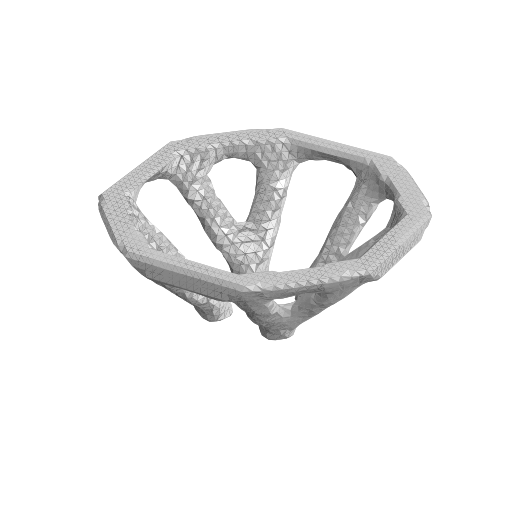

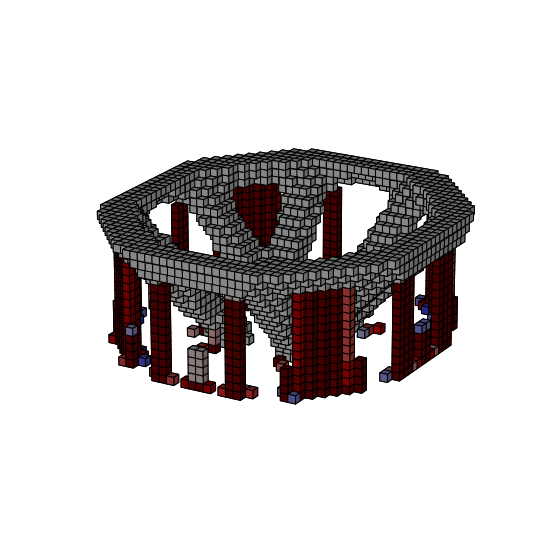

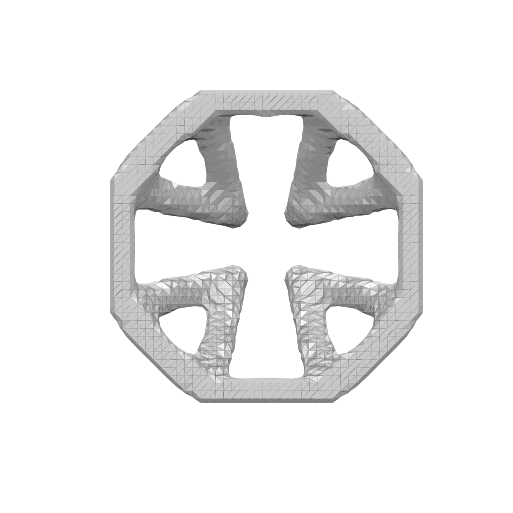

In [2]:
from optimization_sp import run_opt
from optimization_sp import run_batch_opt
import os

# run_batch_opt("Studies/MVP_format_test_1/request_header.json","Studies/MVP_format_test_1","Studies/MVP_format_test_1/bc.json","Resources/mat_lib.json",'Resources/machine.json')

study_folder = "Studies/EMB_Scenario_1"
for i in range(1,10):
    print(i)
    folder_name = "Past/Iter0/"+"config_{}".format(i)
    config_path = os.path.join(study_folder, folder_name)
    # run_opt(os.path.join(study_folder,"Past/Iter0/request_header.json"),os.path.join(config_path,"mmm.json"), os.path.join(study_folder,"bc.json"), "Resources/mat_lib.json",'Resources/machine.json',os.path.join(study_folder,"Past/Iter0/constraints.json"),probe = True, test = False)
    run_opt(os.path.join(study_folder,"Past/Iter0/request_header.json"),os.path.join(config_path,"mmm.json"), os.path.join(study_folder,"bc.json"), "Resources/mat_lib.json",'Resources/machine.json',os.path.join(study_folder,"Past/Iter0/constraints.json"),probe = False, test = True)

study_folder = "Studies/EMB_Scenario_1"
for i in range(1,10):
    print(i)
    folder_name = "config_{}".format(i)
    config_path = os.path.join(study_folder, folder_name)
    # run_opt(os.path.join(study_folder,"request_header.json"),os.path.join(config_path,"mmm.json"), os.path.join(study_folder,"bc.json"), "Resources/mat_lib.json",'Resources/machine.json',os.path.join(study_folder,"constraints.json"),probe = True, test = False)
    run_opt(os.path.join(study_folder,"request_header.json"),os.path.join(config_path,"mmm.json"), os.path.join(study_folder,"bc.json"), "Resources/mat_lib.json",'Resources/machine.json',os.path.join(study_folder,"constraints.json"),probe = False, test = True)



1
vf_arr:  [[-1.          0.06854549  0.06339446]
 [-1.          0.07195772  0.0479581 ]]
mass_vf,time_vf,cost_vf 0.46296296296296285 0.06854548723480765 0.07195771897733642
cost_vf
opt1.time_con tf.Tensor(76320.01, shape=(), dtype=float32)
opt1.cost_con tf.Tensor(175000.0, shape=(), dtype=float32)


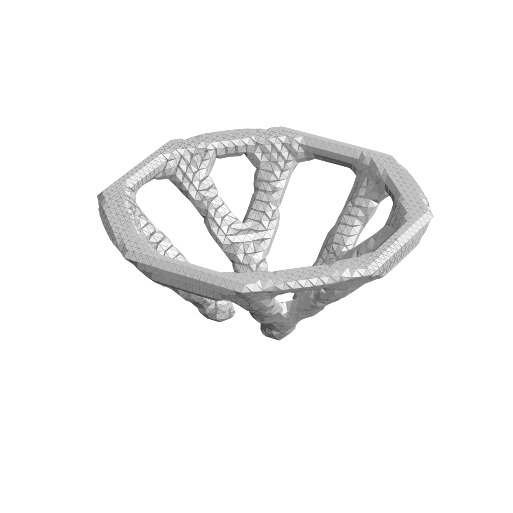

## Result Summary
VF:  tf.Tensor(0.06814876, shape=(), dtype=float32)
Mass: 73.600670 [kg]
Compliance: 6.953233e-01
Time: 76826.54 [min]
Cost: 167813.03 [$]
max d:  0.040870360410510675
comp:  0.6953232884407043
vf: tf.Tensor(0.06814876, shape=(), dtype=float32)
0.5 vf: tf.Tensor(0.06875, shape=(), dtype=float64)
0.2 mass: tf.Tensor(88.21406250000003, shape=(), dtype=float64)
cutoff 0.5081632653061224
cutoff mass:  tf.Tensor(73.99687500000002, shape=(), dtype=float64)
## Result Summary
VF:  tf.Tensor(0.06814876, shape=(), dtype=float32)
Mass: 73.600670 [kg]
Compliance: 6.953233e-01
Time: 76826.54 [min]
Cost: 167813.03 [$]
Max Disp: 0.040870375017514574 [mm]
2
vf_arr:  [[-0.47268186  1.         -0.49724733]
 [ 0.18143976  1.          0.45089968]]
mass_vf,time_vf,cost_vf 0.46296296296296285 -0.4726818595533091 0.18143975558525882
cost_vf
opt1.time_con tf.Tensor(92057.055, shape=(), dtype=float32)
opt1.cost_con tf.Tensor(156822.36, shape=(), dtype=float32)
opt1.c_0 tf.Tensor(2.4096467e-12

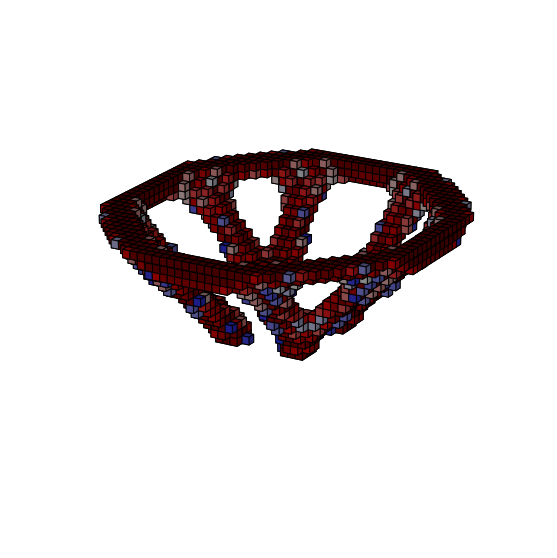

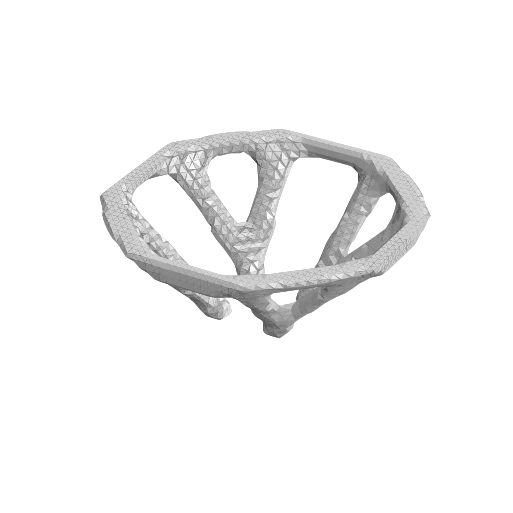

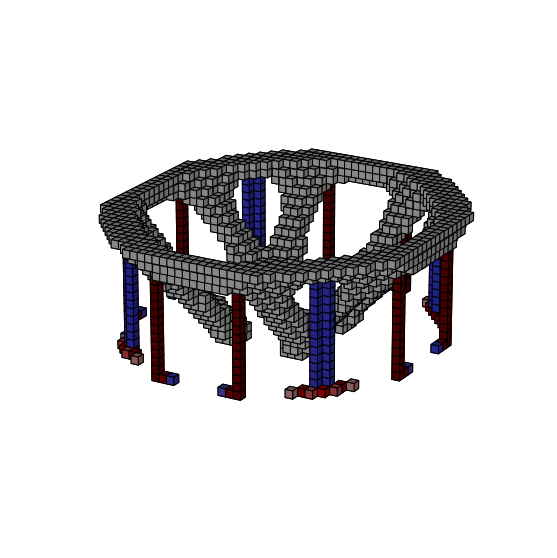

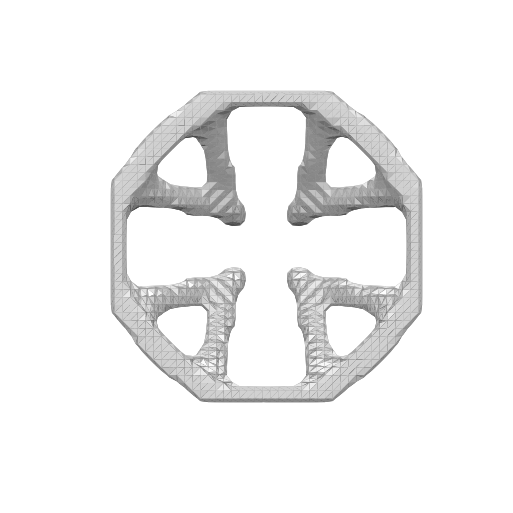

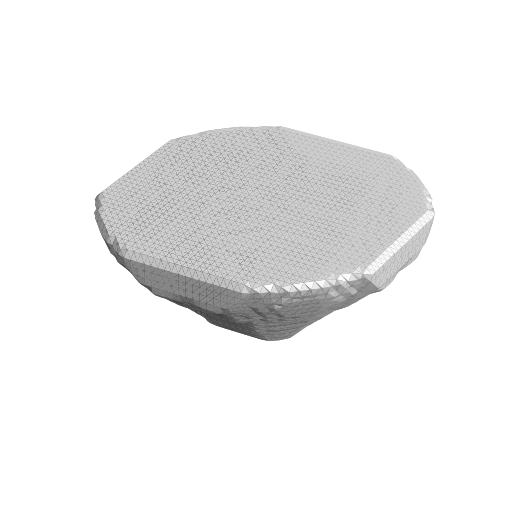

## Result Summary
VF:  tf.Tensor(0.46382752, shape=(), dtype=float32)
Mass: 500.933746 [kg]
Compliance: 9.901884e-02
Time: 33589.17 [min]
Cost: 103932.50 [$]
max d:  0.004300036965839641
comp:  0.09901884198188782
vf: tf.Tensor(0.46382752, shape=(), dtype=float32)
0.5 vf: tf.Tensor(0.48453125, shape=(), dtype=float64)
0.2 mass: tf.Tensor(544.3875000000002, shape=(), dtype=float64)
cutoff 0.5571428571428572
cutoff mass:  tf.Tensor(506.7562500000001, shape=(), dtype=float64)
## Result Summary
VF:  tf.Tensor(0.46382752, shape=(), dtype=float32)
Mass: 500.933746 [kg]
Compliance: 9.901885e-02
Time: 33589.17 [min]
Cost: 103932.50 [$]
Max Disp: 0.004300037538487837 [mm]
3
vf_arr:  [[-1.39851935  1.         -1.39851935]
 [-0.15368952  1.          0.23833333]]
mass_vf,time_vf,cost_vf 0.46296296296296285 -1.3985193548387096 -0.15368951612903214
cost_vf
opt1.time_con 89280.11228011698
opt1.cost_con 174999.36994749223
opt1.c_0 tf.Tensor(2.4096467e-12, shape=(), dtype=float32)


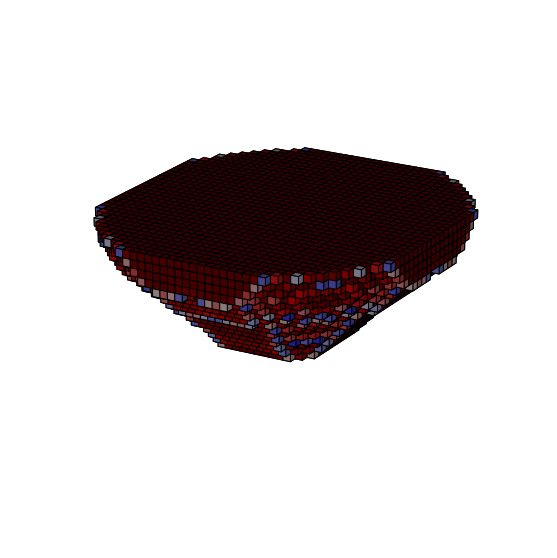

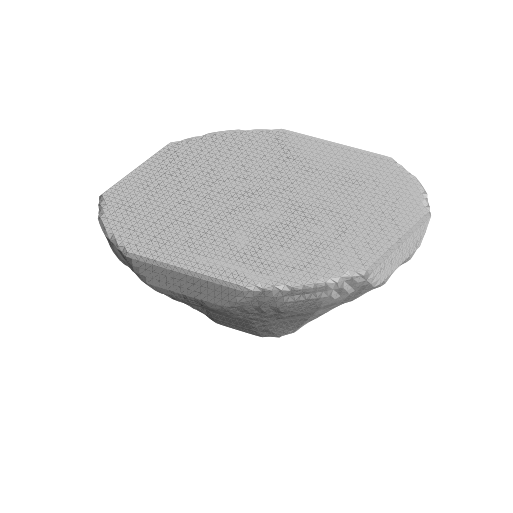

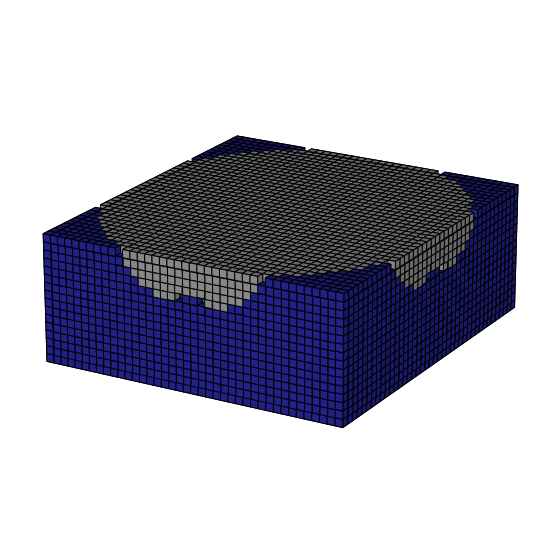

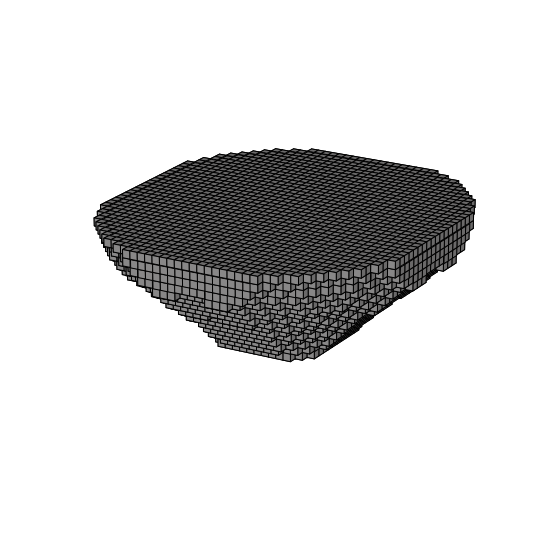

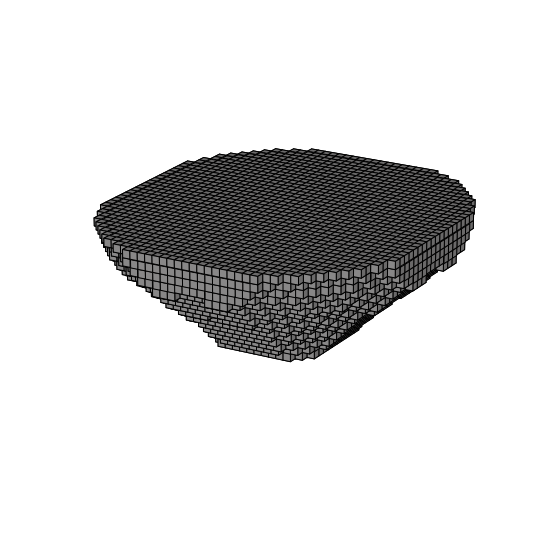

...

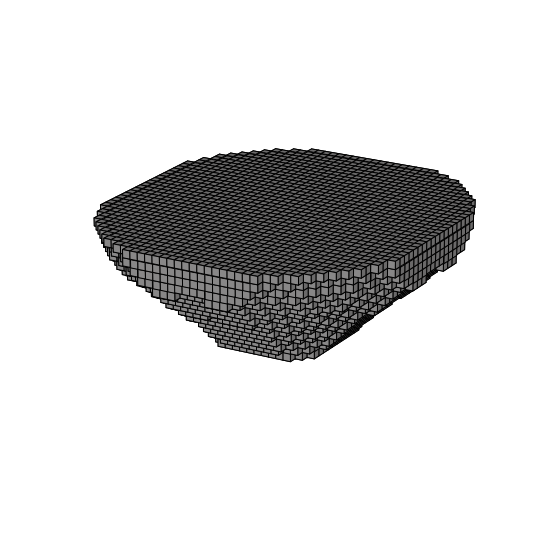

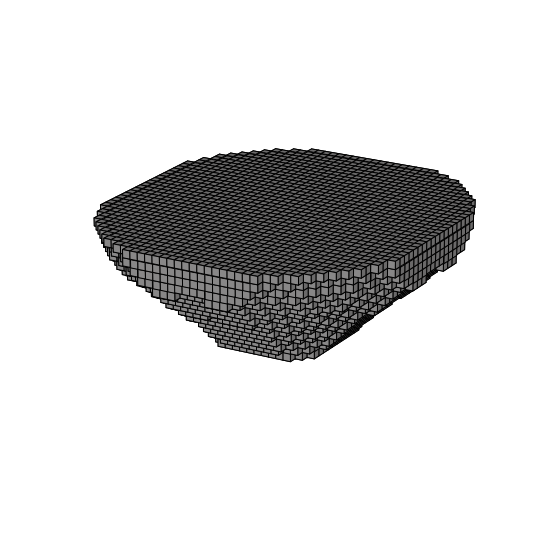

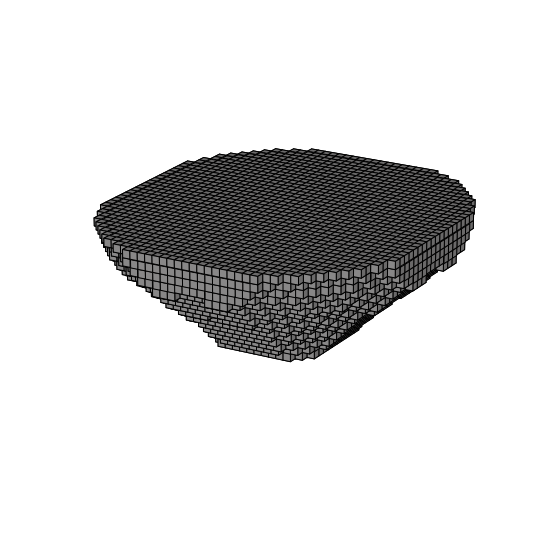

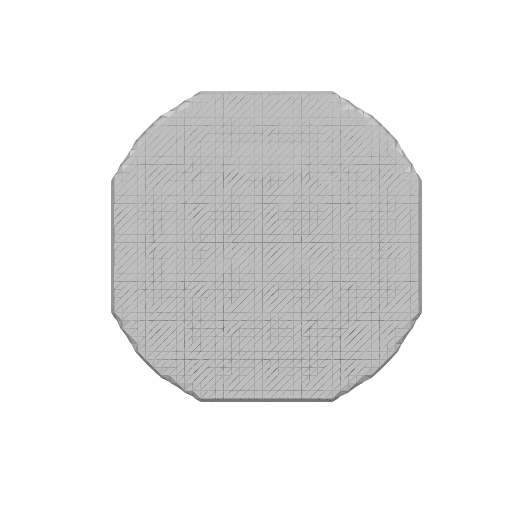

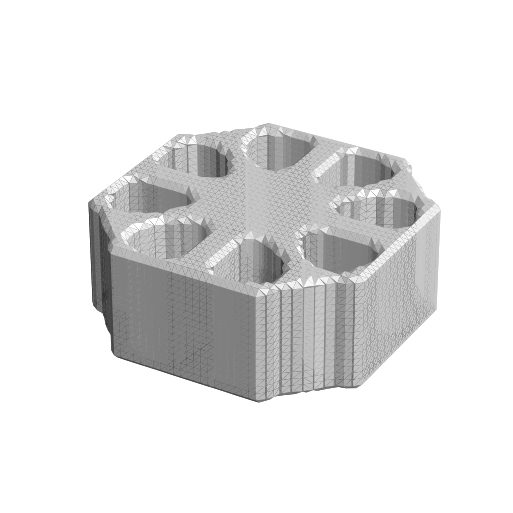

## Result Summary
VF:  tf.Tensor(0.46491477, shape=(), dtype=float32)
Mass: 502.108002 [kg]
Compliance: 1.250117e-01
Time: 10670.20 [min]
Cost: 45790.80 [$]
max d:  0.005317991409930231
comp:  0.12501168251037598
vf: tf.Tensor(0.46491477, shape=(), dtype=float32)
0.5 vf: tf.Tensor(0.4675, shape=(), dtype=float64)
0.2 mass: tf.Tensor(558.9000000000001, shape=(), dtype=float64)
cutoff 0.5244897959183674
cutoff mass:  tf.Tensor(504.90000000000015, shape=(), dtype=float64)
## Result Summary
VF:  tf.Tensor(0.46491477, shape=(), dtype=float32)
Mass: 502.108002 [kg]
Compliance: 1.250117e-01
Time: 10670.20 [min]
Cost: 45790.80 [$]
Max Disp: 0.005317991330533639 [mm]
4
vf_arr:  [[-1.          0.04177716 -1.        ]
 [-1.          0.03945125 -1.        ]]
mass_vf,time_vf,cost_vf 0.28216704288939043 0.041777159262749566 0.039451253935068036
cost_vf
opt1.time_con tf.Tensor(76320.01, shape=(), dtype=float32)
opt1.cost_con tf.Tensor(174999.78, shape=(), dtype=float32)


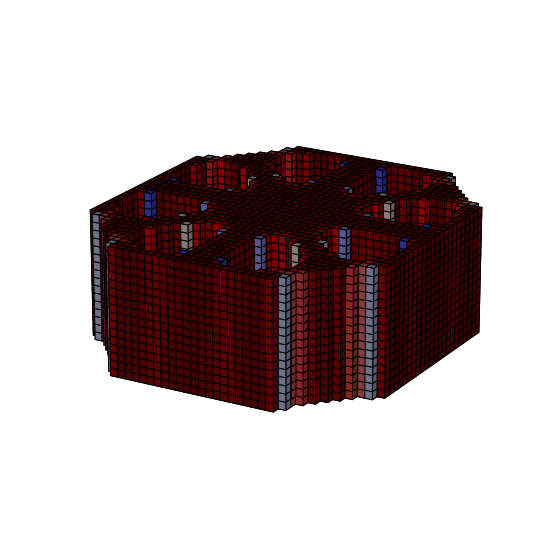

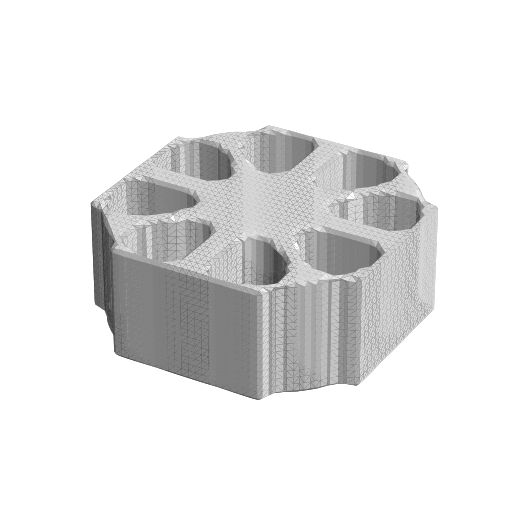

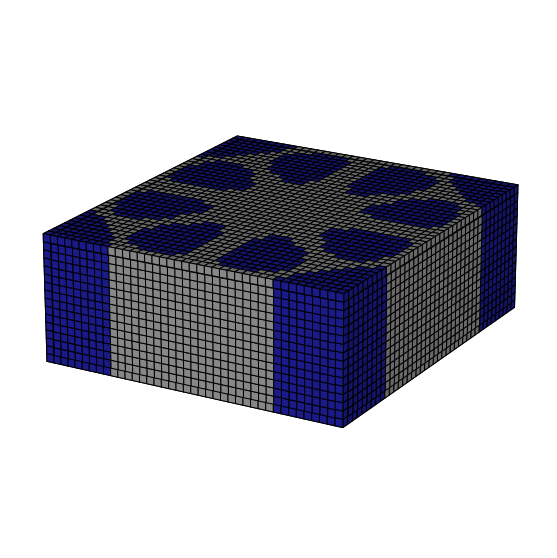

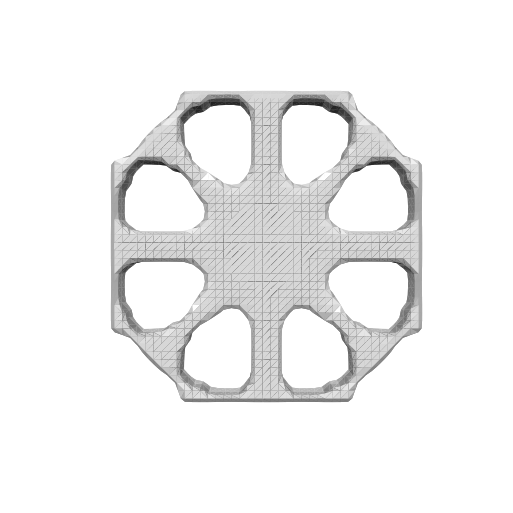

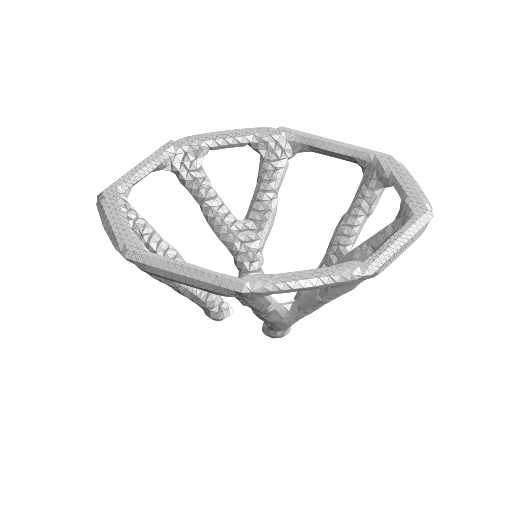

## Result Summary
VF:  tf.Tensor(0.04028778, shape=(), dtype=float32)
Mass: 71.389946 [kg]
Compliance: 7.379152e-01
Time: 71912.94 [min]
Cost: 174606.50 [$]
max d:  0.04645203661108568
comp:  0.7379151582717896
vf: tf.Tensor(0.04028778, shape=(), dtype=float32)
0.5 vf: tf.Tensor(0.0410546875, shape=(), dtype=float64)
0.2 mass: tf.Tensor(92.89156250000002, shape=(), dtype=float64)
cutoff 0.5081632653061224
cutoff mass:  tf.Tensor(72.33359375, shape=(), dtype=float64)
## Result Summary
VF:  tf.Tensor(0.04028778, shape=(), dtype=float32)
Mass: 71.389946 [kg]
Compliance: 7.379152e-01
Time: 71912.94 [min]
Cost: 174606.50 [$]
Max Disp: 0.04645202573997099 [mm]
5
con supplier
6
con supplier
7
vf_arr:  [[-0.40290641  1.          1.        ]
 [ 0.20941749  1.          1.        ]]
mass_vf,time_vf,cost_vf 0.99999 -0.40290641051297493 0.20941748897276158
cost_vf
opt1.time_con tf.Tensor(92063.66, shape=(), dtype=float32)
opt1.cost_con tf.Tensor(156565.97, shape=(), dtype=float32)
opt1.c_0 tf.Tenso

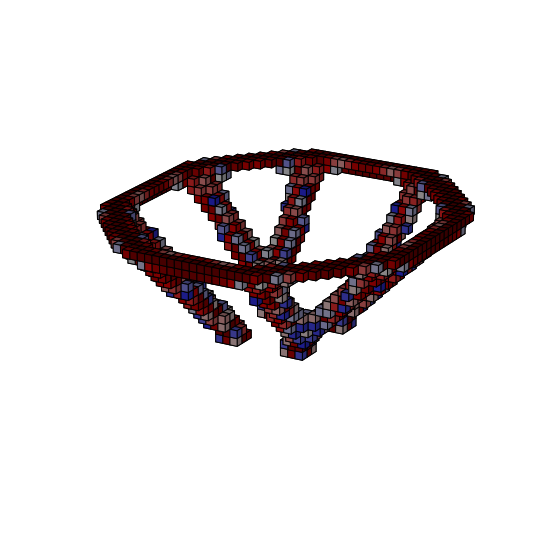

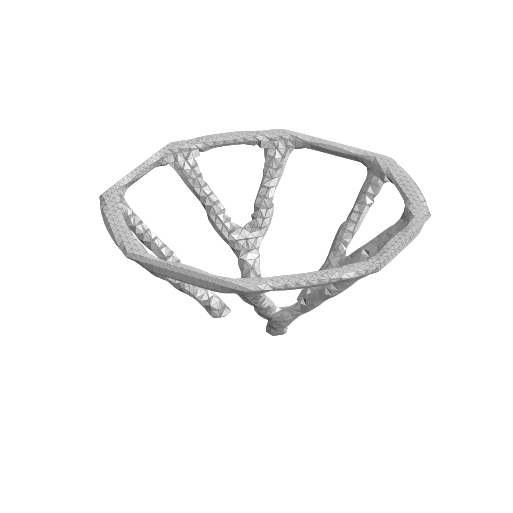

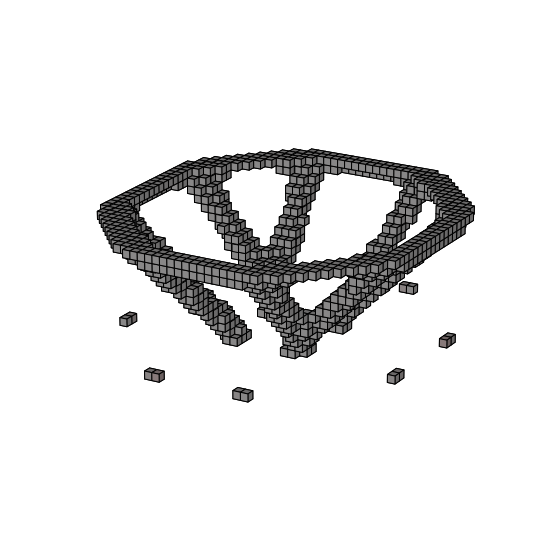

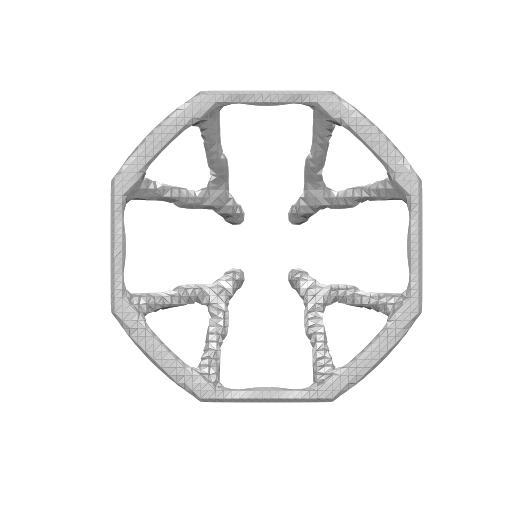

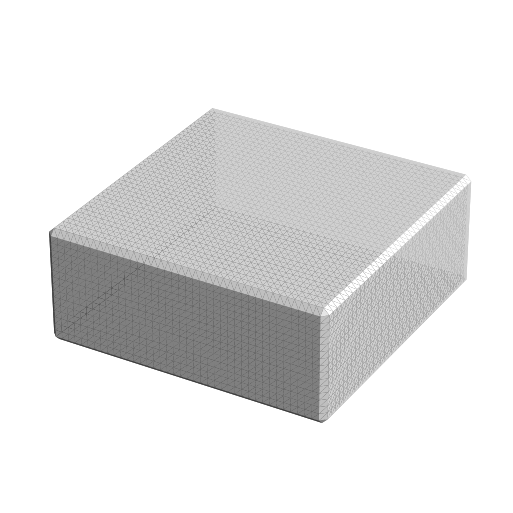

## Result Summary
VF:  tf.Tensor(0.9999997, shape=(), dtype=float32)
Mass: 423.999878 [kg]
Compliance: 2.203730e+00
Time: 115.02 [min]
Cost: 1118.06 [$]
max d:  0.086487816153266
comp:  2.203730344772339
vf: tf.Tensor(0.9999997, shape=(), dtype=float32)
0.5 vf: tf.Tensor(1.0, shape=(), dtype=float64)
0.2 mass: tf.Tensor(424.00000000000006, shape=(), dtype=float64)
cutoff 0.9
cutoff mass:  tf.Tensor(424.00000000000006, shape=(), dtype=float64)
## Result Summary
VF:  tf.Tensor(0.9999997, shape=(), dtype=float32)
Mass: 423.999878 [kg]
Compliance: 2.203730e+00
Time: 115.02 [min]
Cost: 1118.06 [$]
Max Disp: 0.08648781116549775 [mm]
8
vf_arr:  [[-1.          0.10534205  0.16147642]
 [-1.          0.20004153  0.13332289]]
mass_vf,time_vf,cost_vf 0.99999 0.16147641509433963 0.13332289466606978
cost_vf
opt1.time_con tf.Tensor(70589.99, shape=(), dtype=float32)
opt1.cost_con tf.Tensor(116665.99, shape=(), dtype=float32)


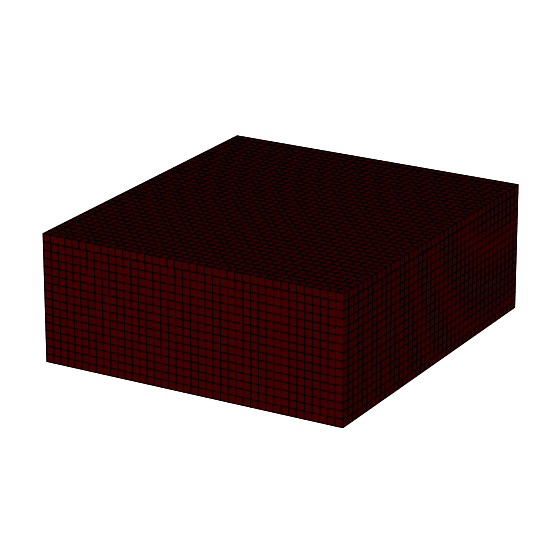

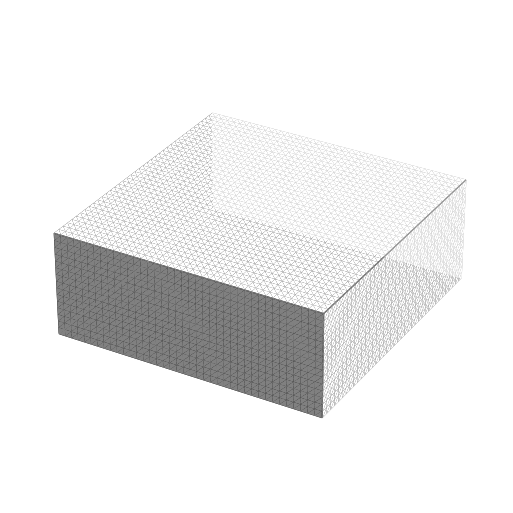

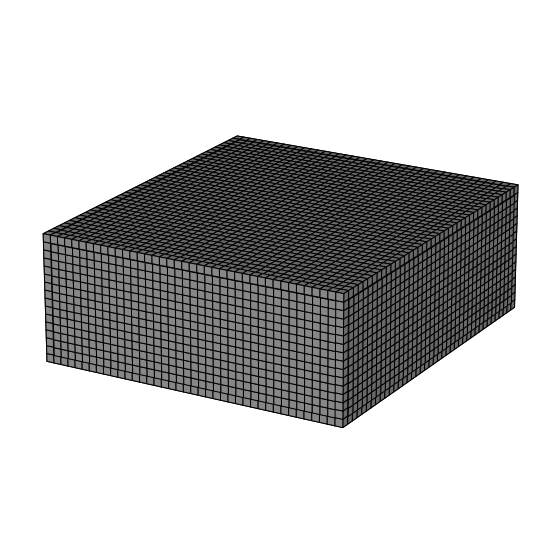

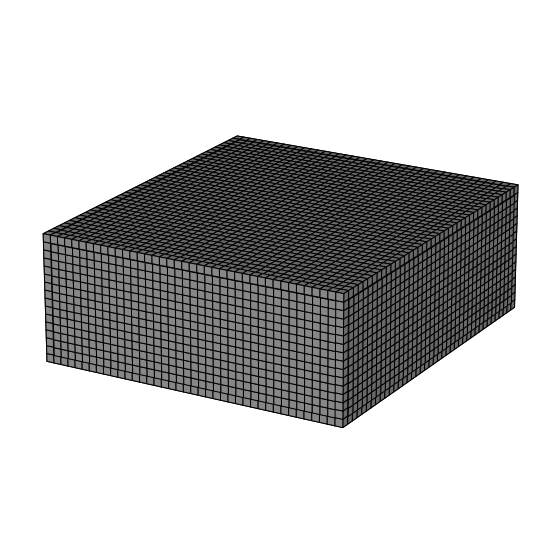

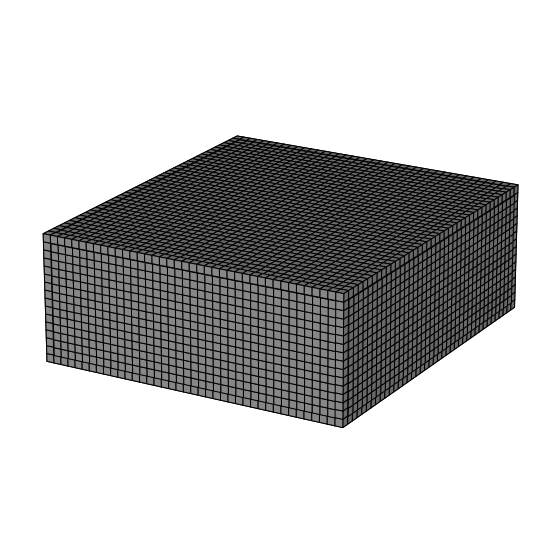

...

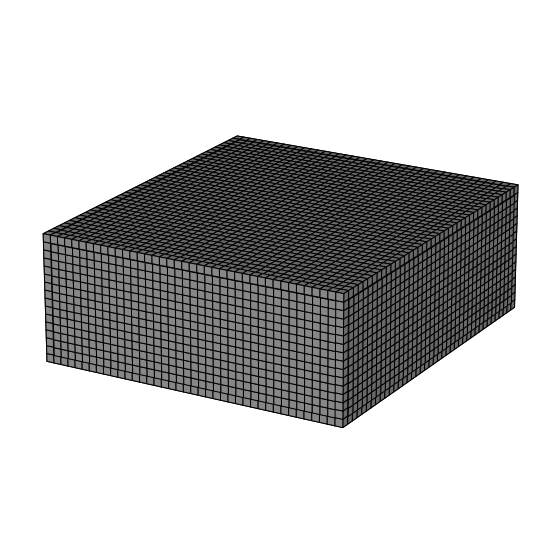

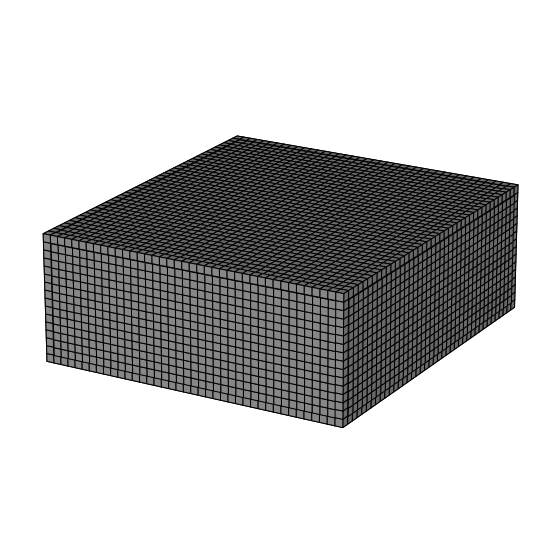

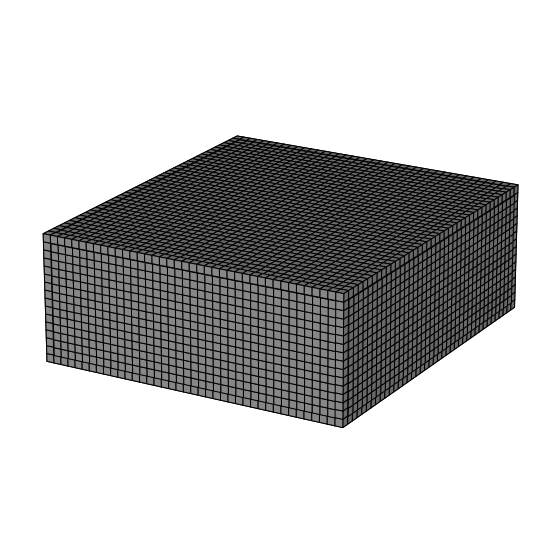

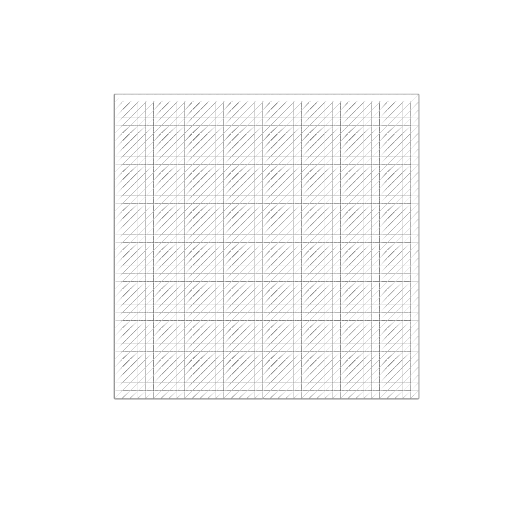

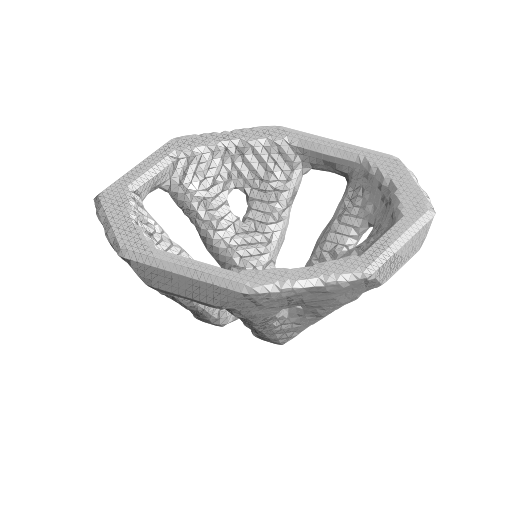

## Result Summary
VF:  tf.Tensor(0.13528222, shape=(), dtype=float32)
Mass: 57.359665 [kg]
Compliance: 1.044382e+01
Time: 58500.47 [min]
Cost: 117077.80 [$]
max d:  0.49878261821400083
comp:  10.443819046020508
vf: tf.Tensor(0.13528222, shape=(), dtype=float32)
0.5 vf: tf.Tensor(0.1326953125, shape=(), dtype=float64)
0.2 mass: tf.Tensor(65.00781250000001, shape=(), dtype=float64)
cutoff 0.44285714285714284
cutoff mass:  tf.Tensor(57.37250000000002, shape=(), dtype=float64)
## Result Summary
VF:  tf.Tensor(0.13528222, shape=(), dtype=float32)
Mass: 57.359665 [kg]
Compliance: 1.044382e+01
Time: 58500.47 [min]
Cost: 117077.80 [$]
Max Disp: 0.49878260413238706 [mm]
9
vf_arr:  [[-1.39851935  1.          1.        ]
 [-0.16976478  1.          1.        ]]
mass_vf,time_vf,cost_vf 0.99999 -1.3985193548387096 -0.16976478494623648
cost_vf
opt1.time_con 89280.11228011698
opt1.cost_con 174999.37510226335
opt1.c_0 tf.Tensor(9.837997e-10, shape=(), dtype=float32)


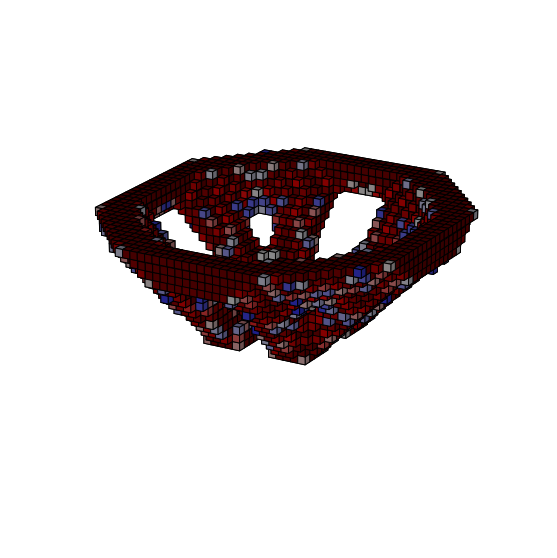

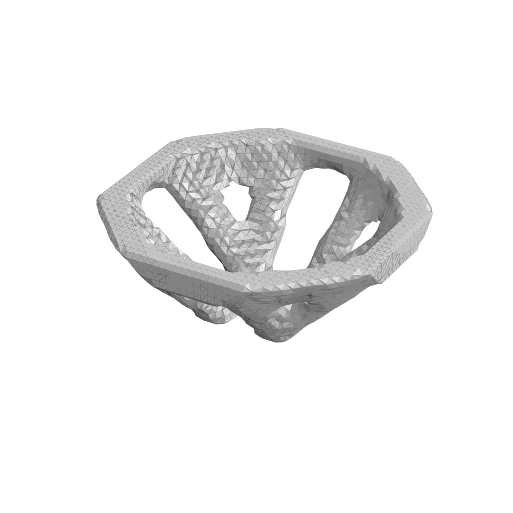

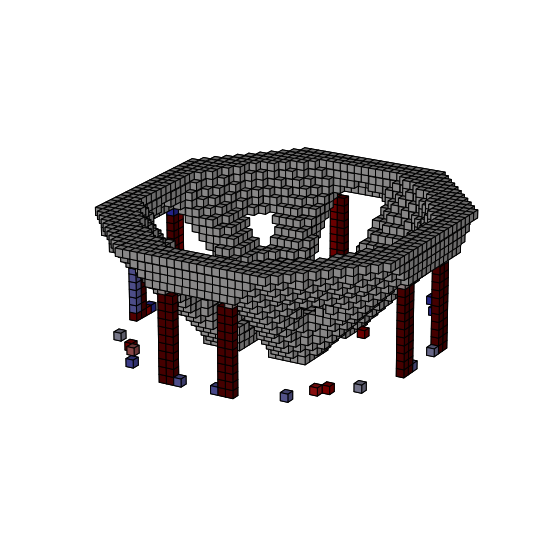

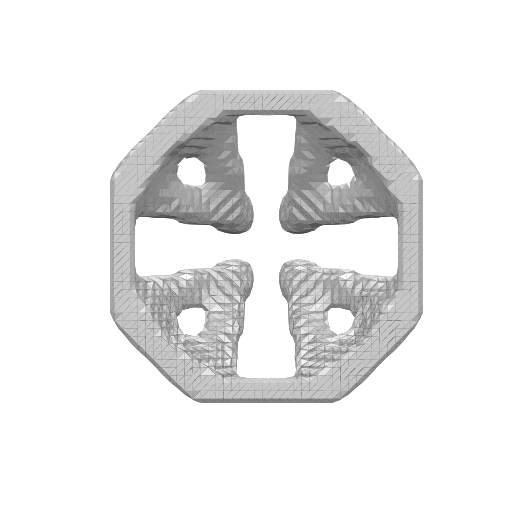

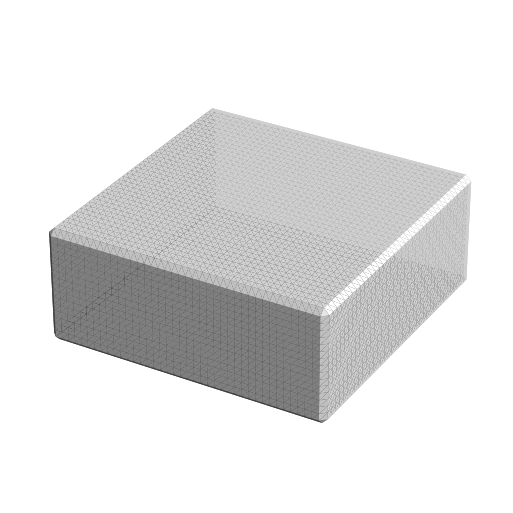

## Result Summary
VF:  tf.Tensor(0.99999017, shape=(), dtype=float32)
Mass: 423.995850 [kg]
Compliance: 2.203712e+00
Time: 329.97 [min]
Cost: 2037.86 [$]
max d:  0.08648784527978441
comp:  2.203712224960327
vf: tf.Tensor(0.99999017, shape=(), dtype=float32)
0.5 vf: tf.Tensor(1.0, shape=(), dtype=float64)
0.2 mass: tf.Tensor(424.00000000000006, shape=(), dtype=float64)
cutoff 0.9
cutoff mass:  tf.Tensor(424.00000000000006, shape=(), dtype=float64)
## Result Summary
VF:  tf.Tensor(0.99999017, shape=(), dtype=float32)
Mass: 423.995850 [kg]
Compliance: 2.203712e+00
Time: 329.97 [min]
Cost: 2037.86 [$]
Max Disp: 0.08648784518702483 [mm]
1
vf_arr:  [[-1.          0.06854549  0.06339446]
 [-1.          0.03081551  0.02052996]]
mass_vf,time_vf,cost_vf 0.03703703703703703 0.06854548723480765 0.030815512586635205
cost_vf
opt1.time_con tf.Tensor(76320.01, shape=(), dtype=float32)
opt1.cost_con tf.Tensor(75000.0, shape=(), dtype=float32)


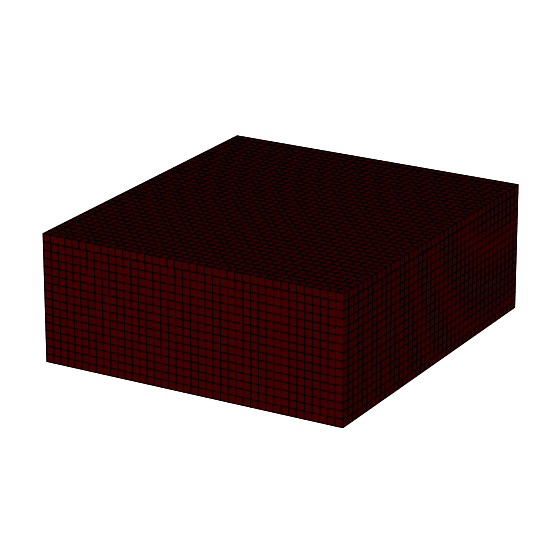

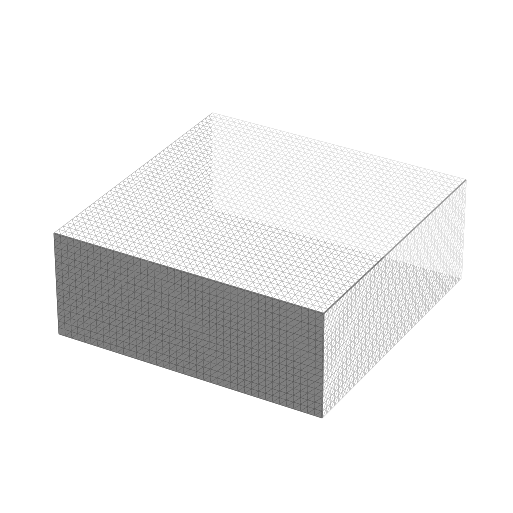

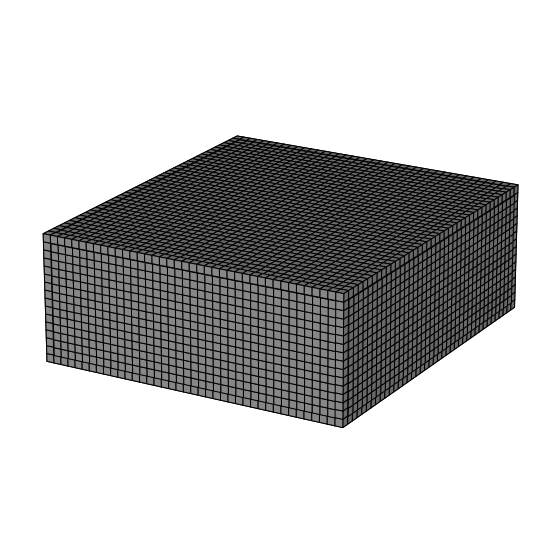

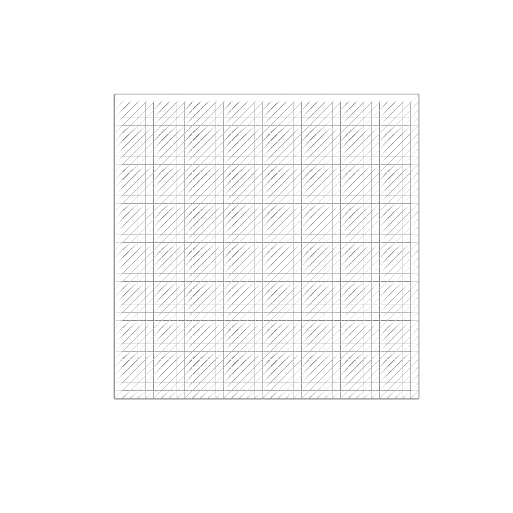

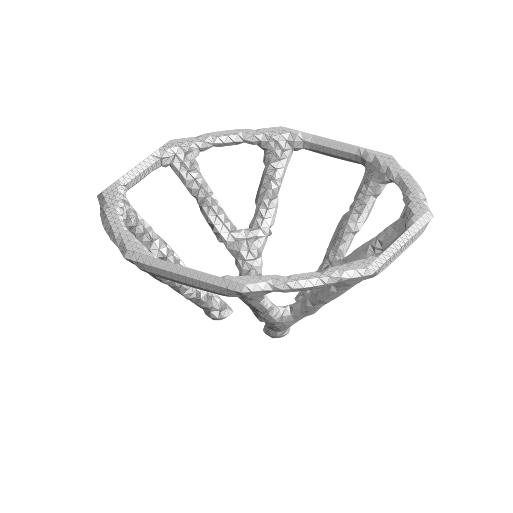

## Result Summary
VF:  tf.Tensor(0.0325701, shape=(), dtype=float32)
Mass: 35.175713 [kg]
Compliance: 1.616635e+00
Time: 35379.79 [min]
Cost: 77251.90 [$]
max d:  0.11482475050048618
comp:  1.6166346073150635
vf: tf.Tensor(0.0325701, shape=(), dtype=float32)
0.5 vf: tf.Tensor(0.03046875, shape=(), dtype=float64)
0.2 mass: tf.Tensor(46.23750000000001, shape=(), dtype=float64)
cutoff 0.42653061224489797
cutoff mass:  tf.Tensor(35.94375000000001, shape=(), dtype=float64)
## Result Summary
VF:  tf.Tensor(0.0325701, shape=(), dtype=float32)
Mass: 35.175713 [kg]
Compliance: 1.616635e+00
Time: 35379.79 [min]
Cost: 77251.90 [$]
Max Disp: 0.11482449333496662 [mm]
2
vf_arr:  [[-0.47268186  1.         -0.49724733]
 [ 0.66439444  1.          0.77448544]]
mass_vf,time_vf,cost_vf 0.03703703703703703 -0.4726818595533091 0.6643944376585548
cost_vf
opt1.time_con tf.Tensor(92057.055, shape=(), dtype=float32)
opt1.cost_con tf.Tensor(66367.29, shape=(), dtype=float32)
3
vf_arr:  [[-1.39851935  1.         

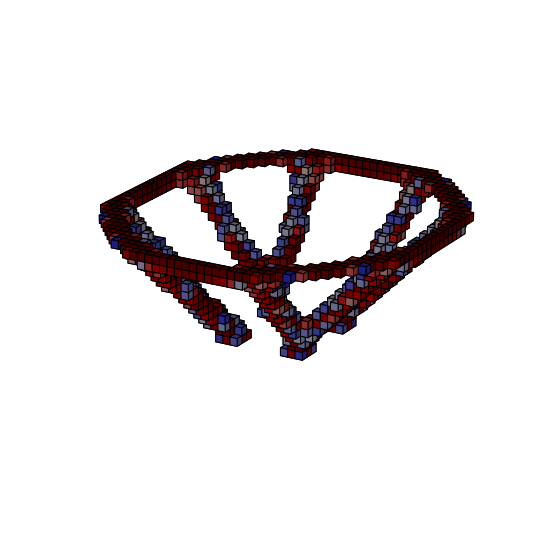

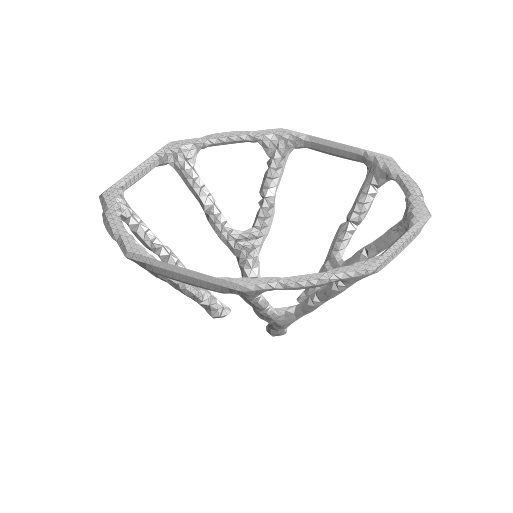

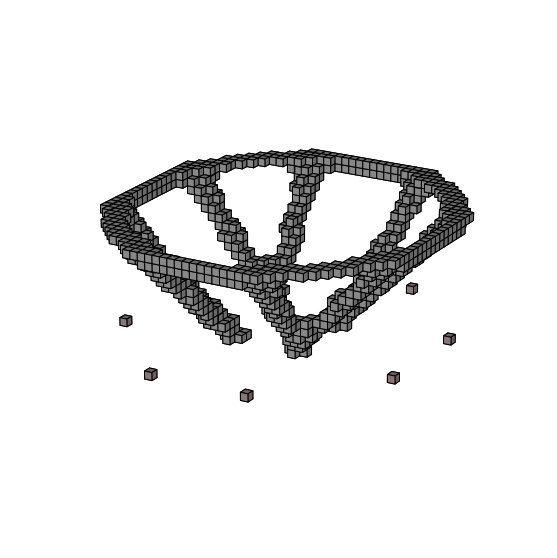

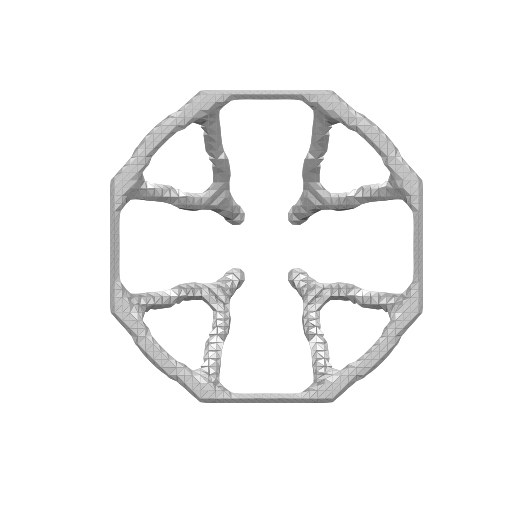

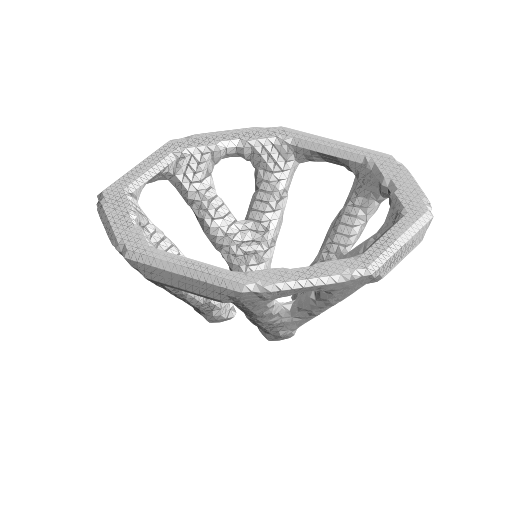

## Result Summary
VF:  tf.Tensor(0.08651966, shape=(), dtype=float32)
Mass: 36.684338 [kg]
Compliance: 1.642086e+01
Time: 37423.80 [min]
Cost: 74882.30 [$]
max d:  0.8740445786066856
comp:  16.42085838317871
vf: tf.Tensor(0.08651966, shape=(), dtype=float32)
0.5 vf: tf.Tensor(0.0859375, shape=(), dtype=float64)
0.2 mass: tf.Tensor(41.10812500000001, shape=(), dtype=float64)
cutoff 0.4755102040816327
cutoff mass:  tf.Tensor(36.85156250000001, shape=(), dtype=float64)
## Result Summary
VF:  tf.Tensor(0.08651966, shape=(), dtype=float32)
Mass: 36.684338 [kg]
Compliance: 1.642086e+01
Time: 37423.80 [min]
Cost: 74882.30 [$]
Max Disp: 0.8740445290305393 [mm]
9
vf_arr:  [[-1.39851935  1.          1.        ]
 [ 0.50227823  1.          1.        ]]
mass_vf,time_vf,cost_vf 0.0943396226415094 -1.3985193548387096 0.5022782258064517
cost_vf
opt1.time_con 89280.11228011698
opt1.cost_con 74999.15960179895


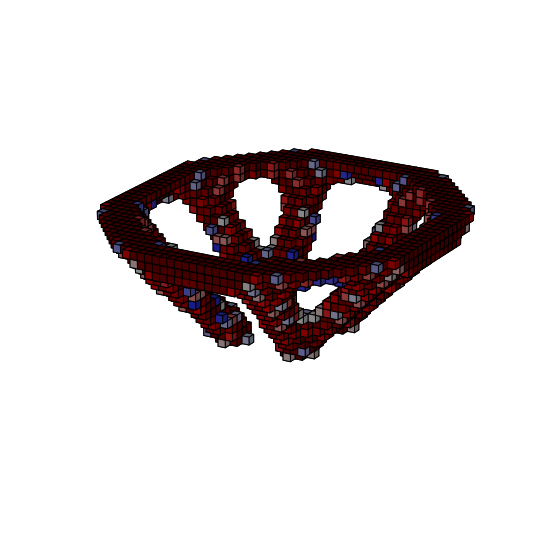

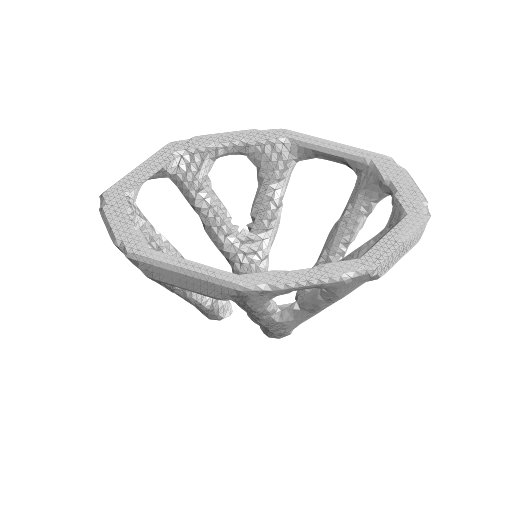

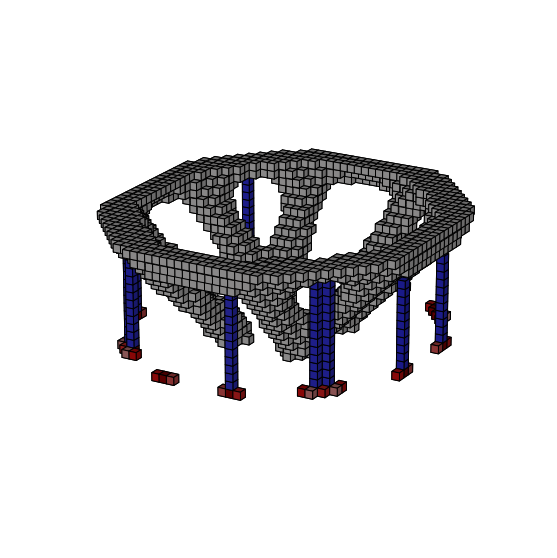

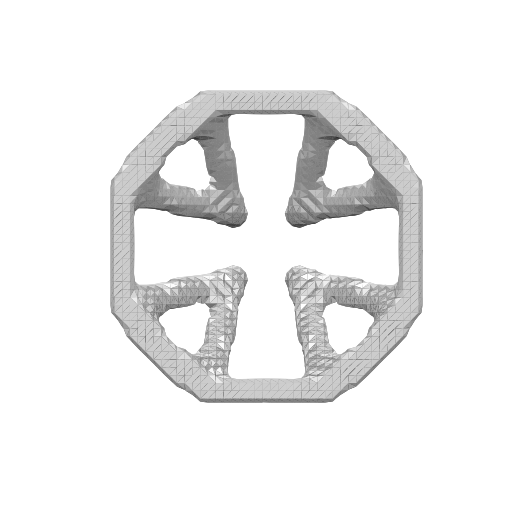

In [3]:
from optimization_sp import run_opt
from optimization_sp import run_batch_opt
import os

# run_batch_opt("Studies/MVP_format_test_1/request_header.json","Studies/MVP_format_test_1","Studies/MVP_format_test_1/bc.json","Resources/mat_lib.json",'Resources/machine.json')

study_folder = "Studies/EMB_Scenario_2"
for i in range(1,10):
    print(i)
    folder_name = "Past/Iter0/"+"config_{}".format(i)
    config_path = os.path.join(study_folder, folder_name)
    # run_opt(os.path.join(study_folder,"Past/Iter0/request_header.json"),os.path.join(config_path,"mmm.json"), os.path.join(study_folder,"bc.json"), "Resources/mat_lib.json",'Resources/machine.json',os.path.join(study_folder,"Past/Iter0/constraints.json"),probe = True, test = False)
    run_opt(os.path.join(study_folder,"Past/Iter0/request_header.json"),os.path.join(config_path,"mmm.json"), os.path.join(study_folder,"bc.json"), "Resources/mat_lib.json",'Resources/machine.json',os.path.join(study_folder,"Past/Iter0/constraints.json"),probe = False, test = True)

study_folder = "Studies/EMB_Scenario_2"
for i in range(1,10):
    print(i)
    folder_name = "config_{}".format(i)
    config_path = os.path.join(study_folder, folder_name)
    # run_opt(os.path.join(study_folder,"request_header.json"),os.path.join(config_path,"mmm.json"), os.path.join(study_folder,"bc.json"), "Resources/mat_lib.json",'Resources/machine.json',os.path.join(study_folder,"constraints.json"),probe = True, test = False)
    run_opt(os.path.join(study_folder,"request_header.json"),os.path.join(config_path,"mmm.json"), os.path.join(study_folder,"bc.json"), "Resources/mat_lib.json",'Resources/machine.json',os.path.join(study_folder,"constraints.json"),probe = False, test = True)

1
con supplier
2
vf_arr:  [[-1.64199288  1.          0.82676325]
 [-0.05367647  1.          0.93627127]]
mass_vf,time_vf,cost_vf 0.06944444444444443 -1.6419928825623098 -0.0536764705882351
cost_vf
opt1.time_con tf.Tensor(165059.17, shape=(), dtype=float32)
opt1.cost_con tf.Tensor(200858.5, shape=(), dtype=float32)


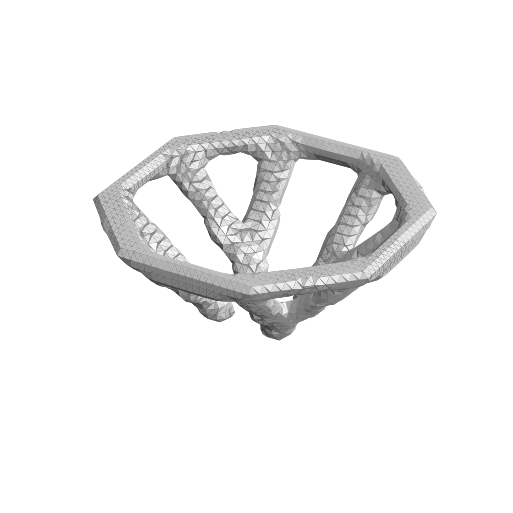

## Result Summary
VF:  tf.Tensor(0.06939053, shape=(), dtype=float32)
Mass: 74.941772 [kg]
Compliance: 6.772662e-01
Time: 58214.55 [min]
Cost: 177808.64 [$]
max d:  0.03624487539742117
comp:  0.6772662997245789
vf: tf.Tensor(0.06939053, shape=(), dtype=float32)
0.5 vf: tf.Tensor(0.06875, shape=(), dtype=float64)
0.2 mass: tf.Tensor(91.63125000000002, shape=(), dtype=float64)
cutoff 0.4755102040816327
cutoff mass:  tf.Tensor(75.26250000000002, shape=(), dtype=float64)
## Result Summary
VF:  tf.Tensor(0.06939053, shape=(), dtype=float32)
Mass: 74.941772 [kg]
Compliance: 6.772662e-01
Time: 58214.55 [min]
Cost: 177808.64 [$]
Max Disp: 0.03624488011543418 [mm]
3
vf_arr:  [[0.6014793  1.         0.6014793 ]
 [0.854375   1.         0.91037588]]
mass_vf,time_vf,cost_vf 0.06944444444444443 0.6014793010752687 0.8543750000000001
cost_vf
opt1.time_con 14880.001947879206
opt1.cost_con 24999.04669679562
4
con supplier
5
con supplier
6
con supplier
7
vf_arr:  [[-1.51662712  1.          1.        ]
 [

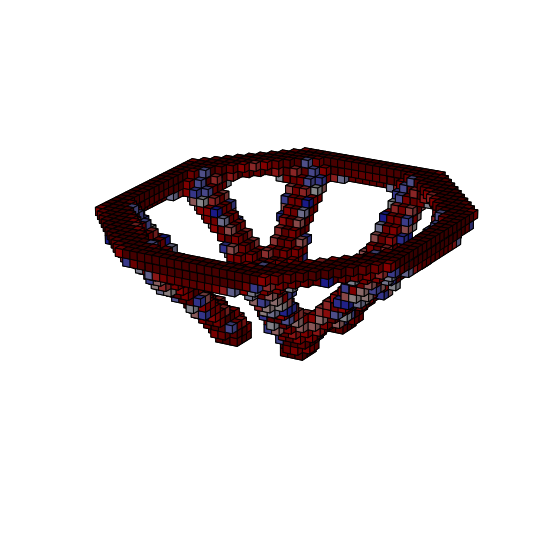

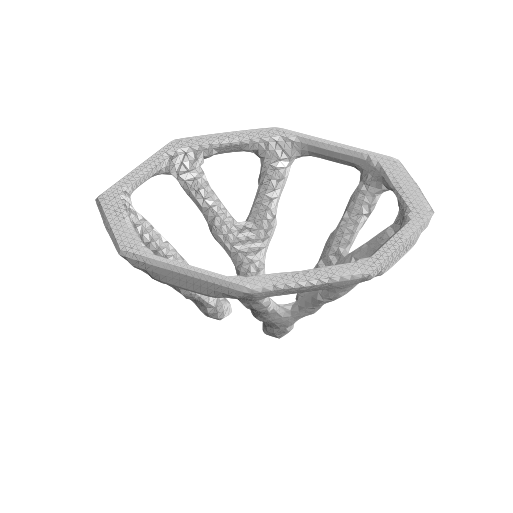

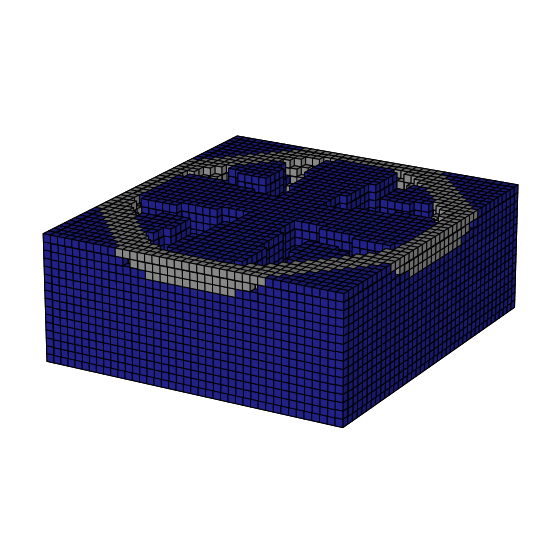

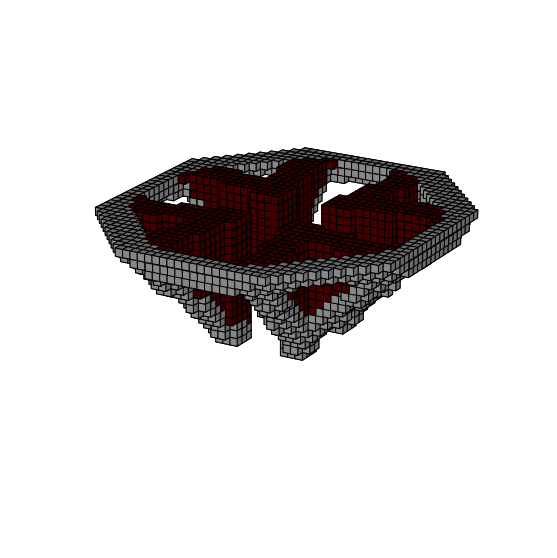

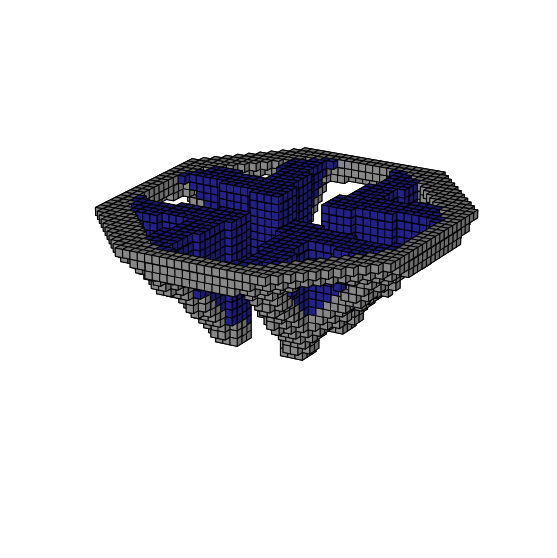

...

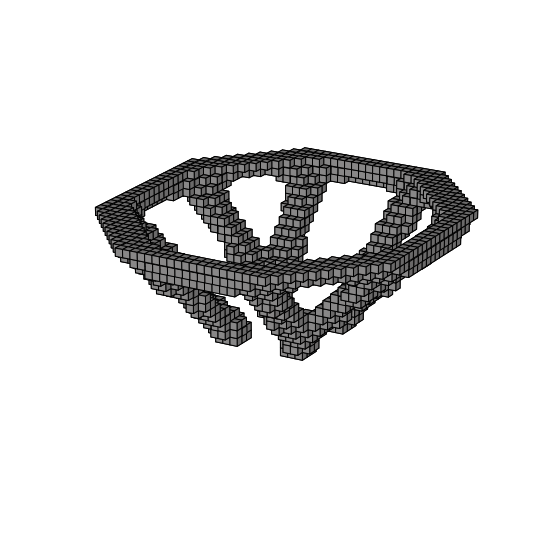

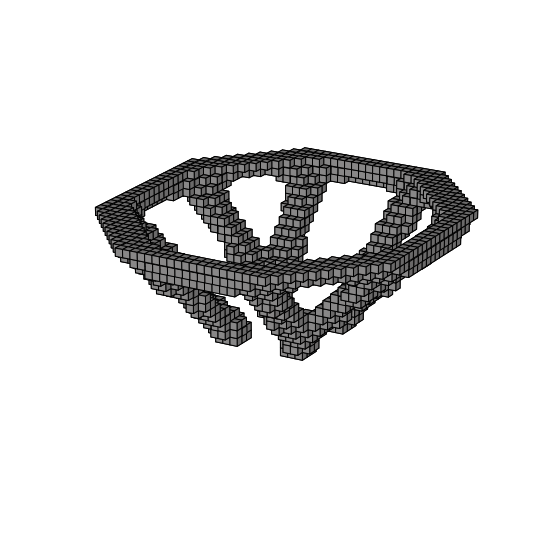

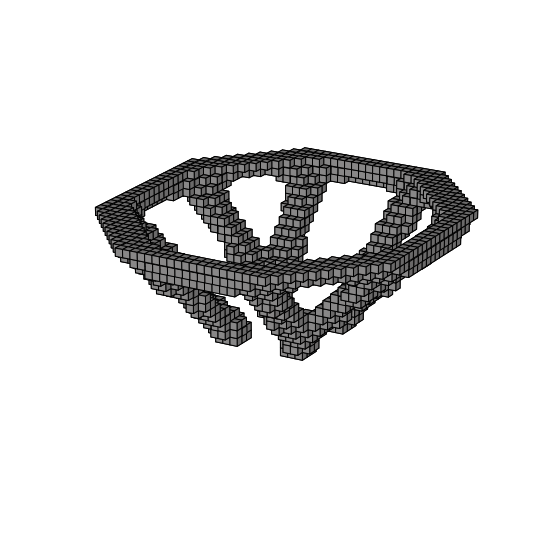

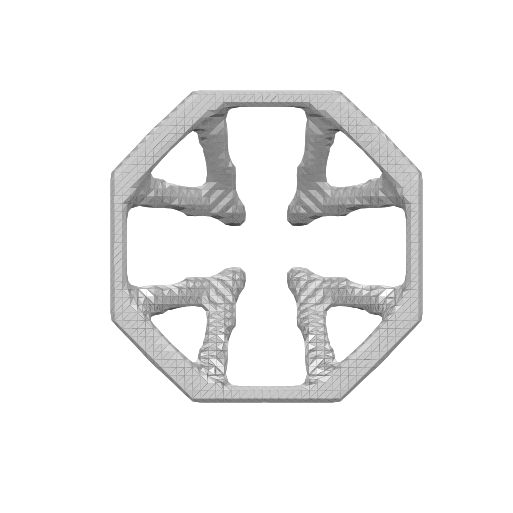

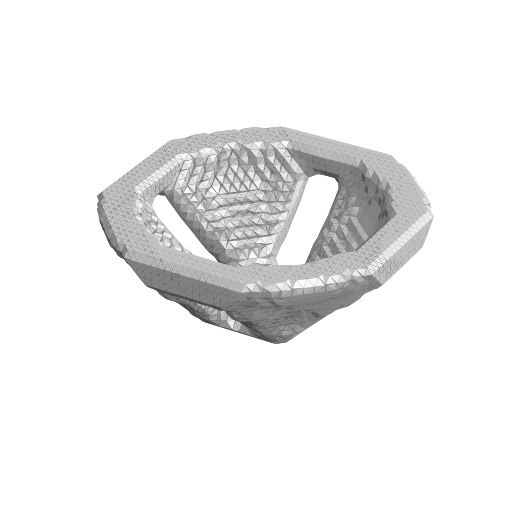

## Result Summary
VF:  tf.Tensor(0.17703731, shape=(), dtype=float32)
Mass: 75.063828 [kg]
Compliance: 7.806809e+00
Time: 54053.24 [min]
Cost: 162932.72 [$]
max d:  0.34826793039859555
comp:  7.806809425354004
vf: tf.Tensor(0.17703731, shape=(), dtype=float32)
0.5 vf: tf.Tensor(0.1753125, shape=(), dtype=float64)
0.2 mass: tf.Tensor(81.09000000000002, shape=(), dtype=float64)
cutoff 0.44285714285714284
cutoff mass:  tf.Tensor(75.47531250000002, shape=(), dtype=float64)
## Result Summary
VF:  tf.Tensor(0.17703731, shape=(), dtype=float32)
Mass: 75.063828 [kg]
Compliance: 7.806809e+00
Time: 54053.24 [min]
Cost: 162932.72 [$]
Max Disp: 0.3482680464124342 [mm]
8
vf_arr:  [[-1.          0.00423612  0.02237131]
 [-1.          0.0284786   0.01894763]]
mass_vf,time_vf,cost_vf 0.17688679245283015 0.022371313427367645 0.01894762525638386
cost_vf
opt1.time_con tf.Tensor(9839.998, shape=(), dtype=float32)
opt1.cost_con tf.Tensor(16666.162, shape=(), dtype=float32)
9
vf_arr:  [[0.6014793  1.       

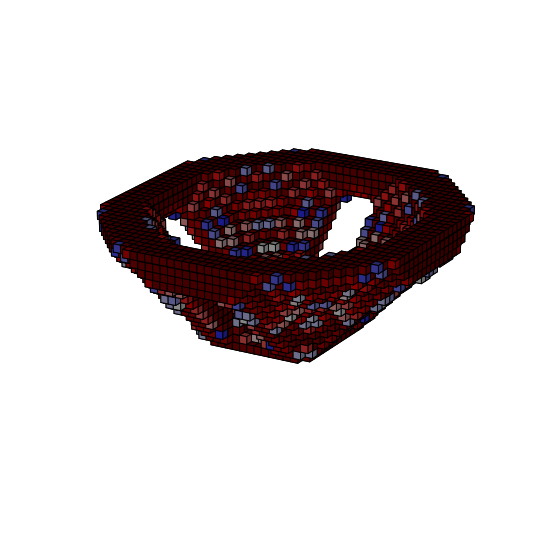

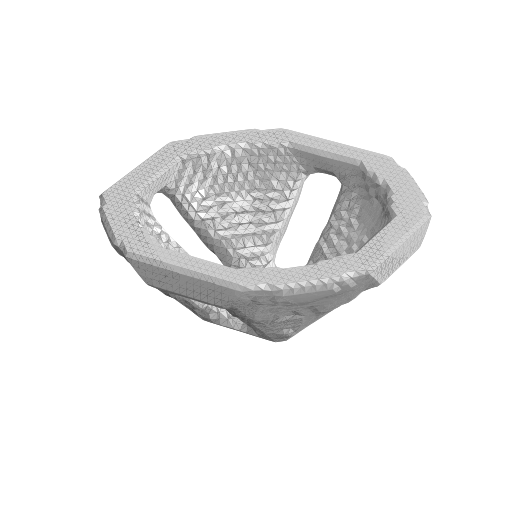

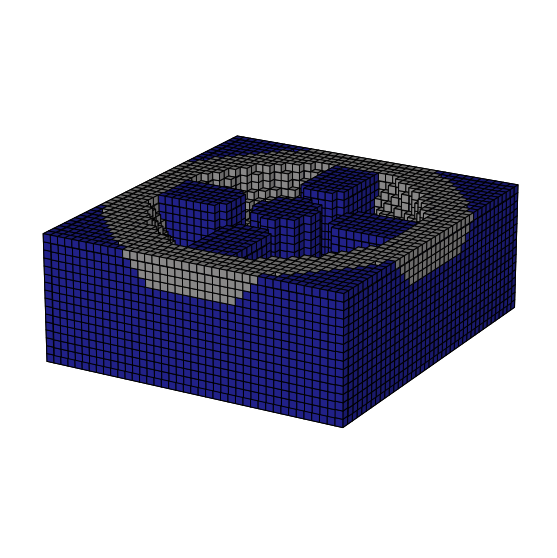

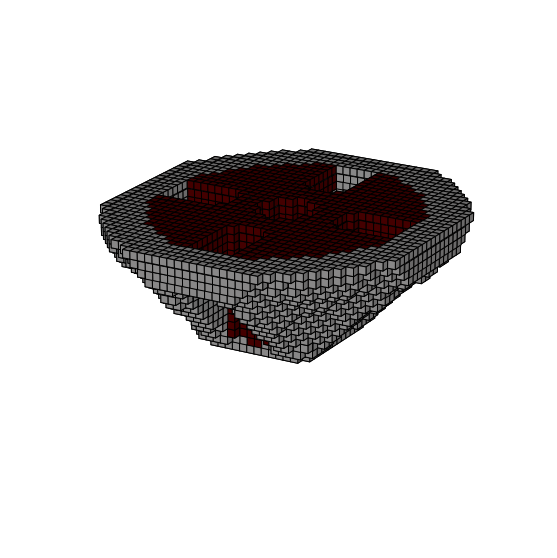

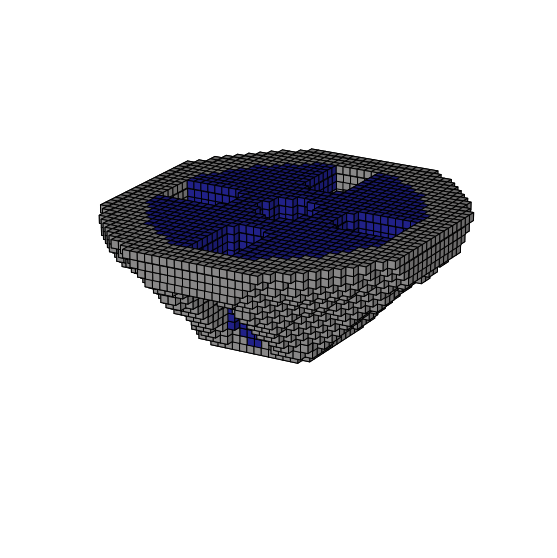

...

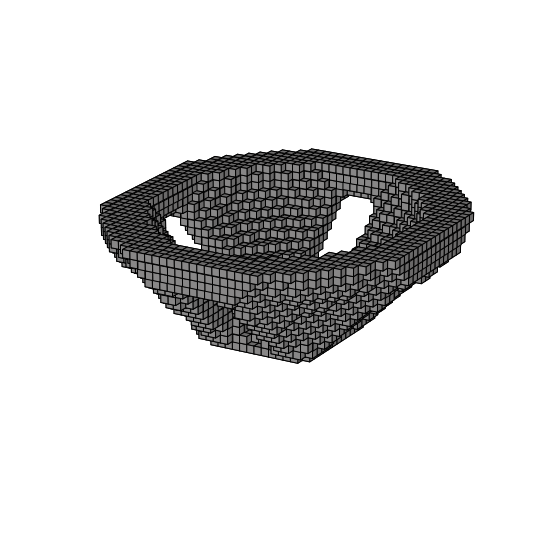

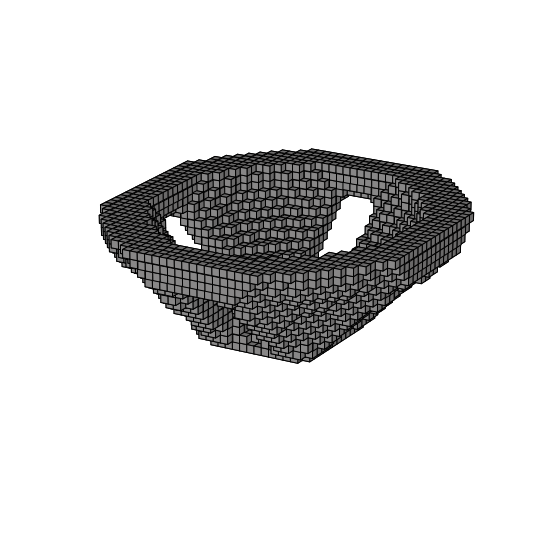

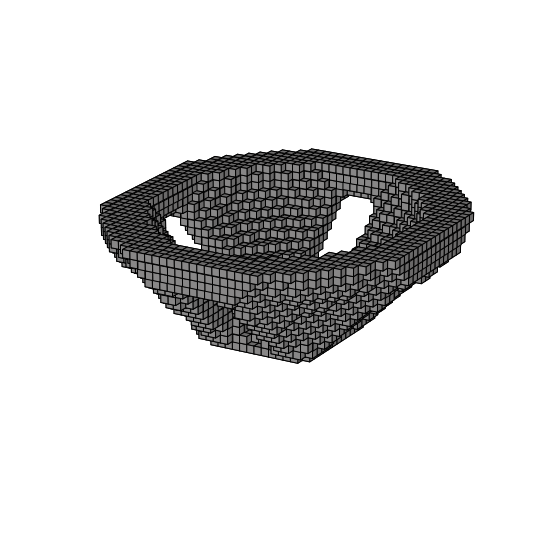

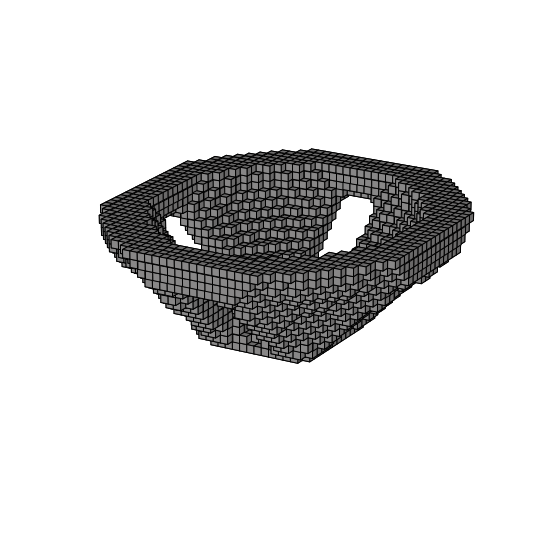

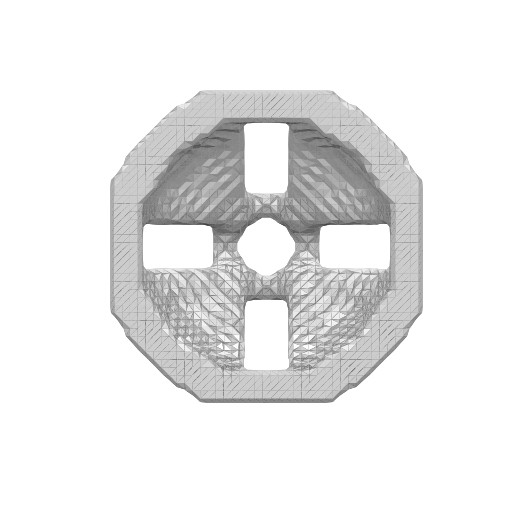

In [4]:
from optimization_sp import run_opt
from optimization_sp import run_batch_opt
import os

# run_batch_opt("Studies/MVP_format_test_1/request_header.json","Studies/MVP_format_test_1","Studies/MVP_format_test_1/bc.json","Resources/mat_lib.json",'Resources/machine.json')

# study_folder = "Studies/EMB_Scenario_1"
# for i in range(1,10):
#     print(i)
#     folder_name = "Past/Iter0/"+"config_{}".format(i)
#     config_path = os.path.join(study_folder, folder_name)
#     # run_opt(os.path.join(study_folder,"Past/Iter0/request_header.json"),os.path.join(config_path,"mmm.json"), os.path.join(study_folder,"bc.json"), "Resources/mat_lib.json",'Resources/machine.json',os.path.join(study_folder,"Past/Iter0/constraints.json"),probe = True, test = False)
#     run_opt(os.path.join(study_folder,"Past/Iter0/request_header.json"),os.path.join(config_path,"mmm.json"), os.path.join(study_folder,"bc.json"), "Resources/mat_lib.json",'Resources/machine.json',os.path.join(study_folder,"Past/Iter0/constraints.json"),probe = False, test = True)

study_folder = "Studies/EMB_Scenario_3"
for i in range(1,10):
    print(i)
    folder_name = "config_{}".format(i)
    config_path = os.path.join(study_folder, folder_name)
    # run_opt(os.path.join(study_folder,"request_header.json"),os.path.join(config_path,"mmm.json"), os.path.join(study_folder,"bc.json"), "Resources/mat_lib.json",'Resources/machine.json',os.path.join(study_folder,"constraints.json"),probe = True, test = False)
    run_opt(os.path.join(study_folder,"request_header.json"),os.path.join(config_path,"mmm.json"), os.path.join(study_folder,"bc.json"), "Resources/mat_lib.json",'Resources/machine.json',os.path.join(study_folder,"constraints.json"),probe = False, test = True)

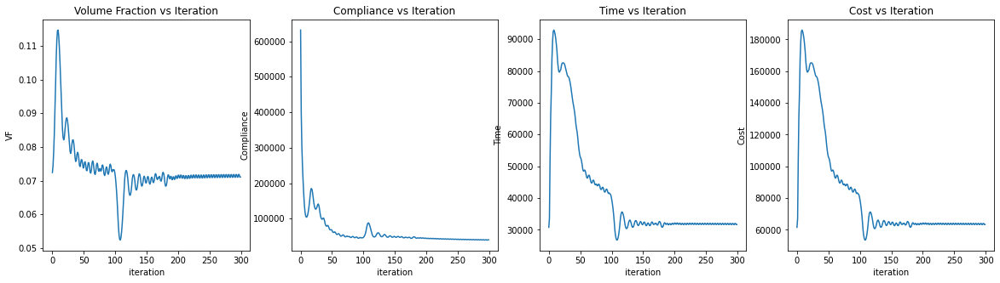

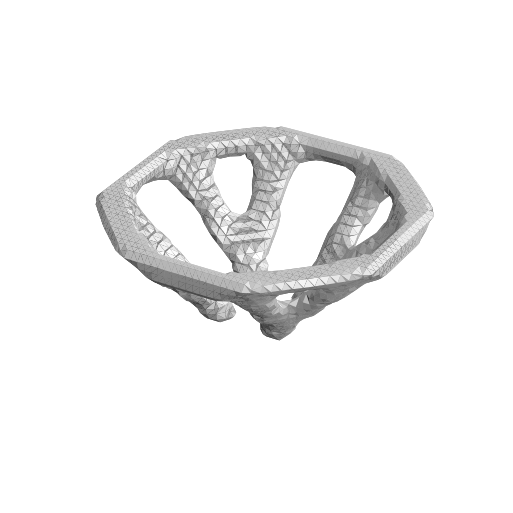

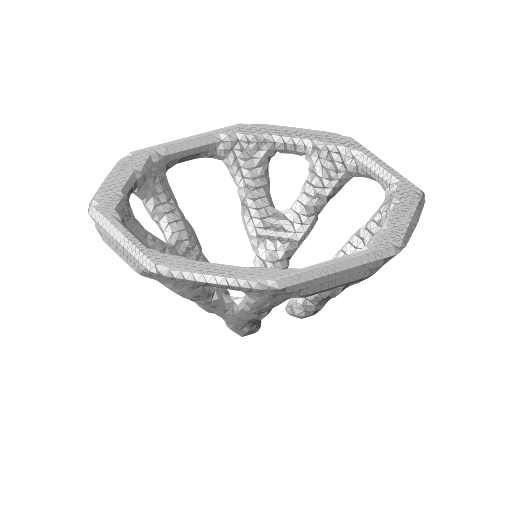

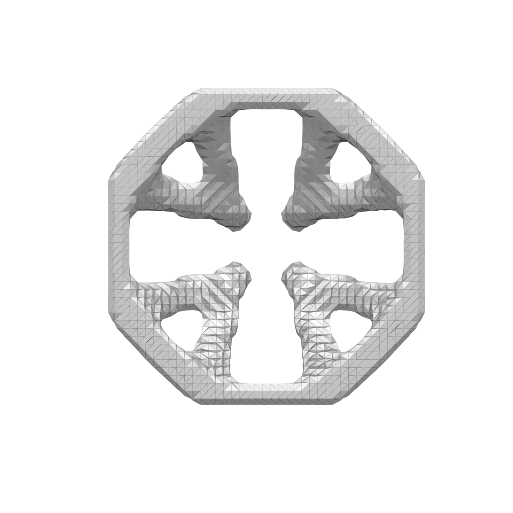

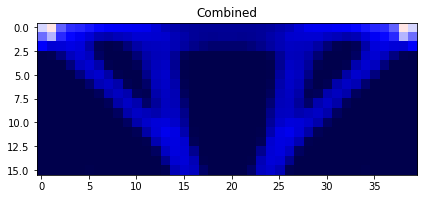

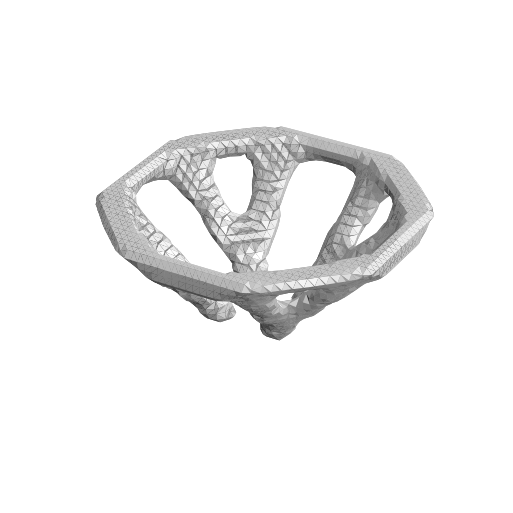

## Result Summary
VF:  tf.Tensor(0.07184918, shape=(), dtype=float32)
Mass: 30.464056 [kg]
Compliance: 2.610382e+01
Time: 31980.06 [min]
Cost: 63983.93 [$]
max d:  2.0623307514370692
comp:  21.20095443725586
Status Code: 200, Response: {'status': 'success', 'data': [{'id': 1, 'suppliers': 'Supplier-B', 'order': 'Request-A', 'processPlan': 'SLM-Additive-1', 'leadTime': 4511104, 'earliestStartTime': '2023-12-06T00:05:00+0000', 'earliestFinishTime': '2023-12-28T05:05:04+0000', 'cost': 63984.82}, {'id': 2, 'suppliers': 'Supplier-C', 'order': 'Request-A', 'processPlan': 'SLM-Additive-1', 'leadTime': 3040204, 'earliestStartTime': '2023-11-09T12:00:00+0000', 'earliestFinishTime': '2023-12-11T04:30:04+0000', 'cost': 95976.73}]}


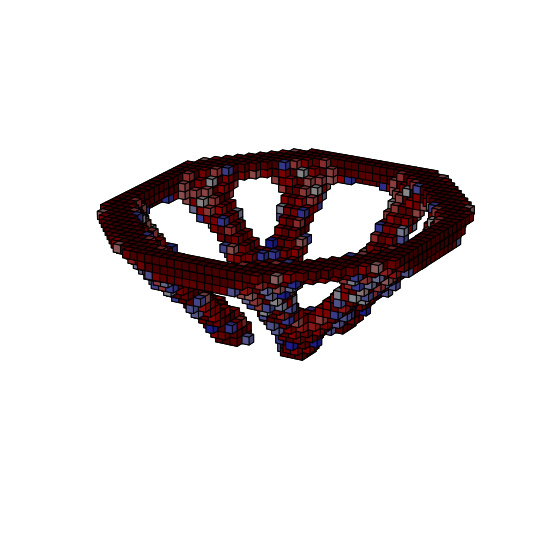

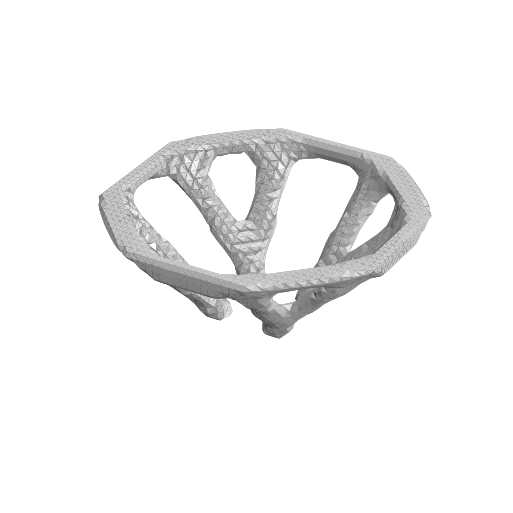

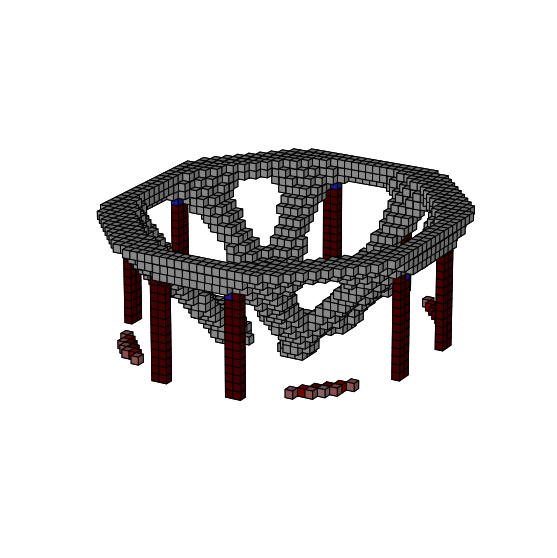

In [1]:
from optimization_sp import run_opt
from optimization_sp import run_batch_opt
import os

# run_batch_opt("Studies/MVP_format_test_1/request_header.json","Studies/MVP_format_test_1","Studies/MVP_format_test_1/bc.json","Resources/mat_lib.json",'Resources/machine.json')

study_folder = "Studies/EMB_Scenario_2"
for i in range(8,9):
    # if i%3 == 0:
    print(i)
    folder_name = "config_{}".format(i)
    config_path = os.path.join(study_folder, folder_name)
    # run_opt(os.path.join(study_folder,"request_header.json"),os.path.join(config_path,"mmm.json"), os.path.join(study_folder,"bc.json"), "Resources/mat_lib.json",'Resources/machine.json',os.path.join(study_folder,"constraints.json"),probe = True, test = False)
    run_opt(os.path.join(study_folder,"request_header.json"),os.path.join(config_path,"mmm.json"), os.path.join(study_folder,"bc.json"), "Resources/mat_lib.json",'Resources/machine.json',os.path.join(study_folder,"constraints.json"),probe = False, test = False)



In [7]:
import os
import json
import requests
#Supply Chain Scheduler Call
directory_path = 'Studies/EMB_Scenario_2/Past/Iter0/config_2'
request = json.load(open(os.path.join(directory_path,"PartProcessPlans.json")))
r = requests.post('http://localhost:9090/generate-bid-and-graph', data=json.dumps(request))
print(f"Status Code: {r.status_code}, Response: {r.json()}")
data = r.json()["data"]

Status Code: 200, Response: {'status': 'success', 'data': [{'id': 1, 'suppliers': 'Supplier-A', 'order': 'Request-A', 'processPlan': '3-Axis-Subtractive-1', 'leadTime': 182577, 'earliestStartTime': '2023-11-06T00:00:00+0000', 'earliestFinishTime': '2023-11-08T02:42:57+0000', 'cost': 14340.0}, {'id': 2, 'suppliers': 'Supplier-C', 'order': 'Request-A', 'processPlan': '3-Axis-Subtractive-1', 'leadTime': 2114652, 'earliestStartTime': '2023-11-09T12:00:00+0000', 'earliestFinishTime': '2023-11-30T11:24:12+0000', 'cost': 170847.0}]}


1
mass_vf,time_vf,cost_vf 0.46296296296296285 0.08019597267170084 0.07861380798274004
opt1.cost_con tf.Tensor(191178.25, shape=(), dtype=float32)
vf: tf.Tensor(0.07393169, shape=(), dtype=float32)
0.5 vf: tf.Tensor(0.07296875, shape=(), dtype=float64)
0.2 mass: tf.Tensor(95.55468750000003, shape=(), dtype=float64)
cutoff 0.44285714285714284
cutoff mass:  tf.Tensor(80.15625000000001, shape=(), dtype=float64)


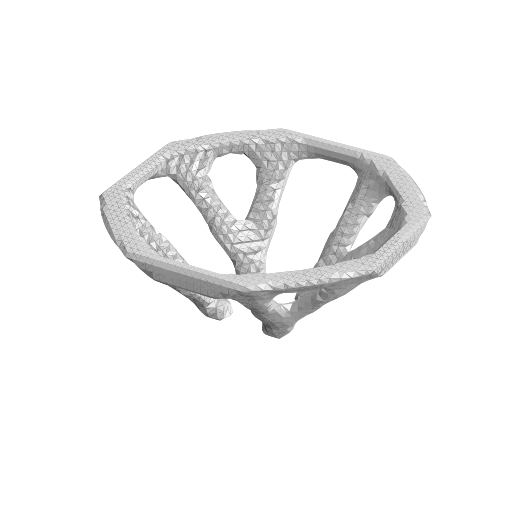

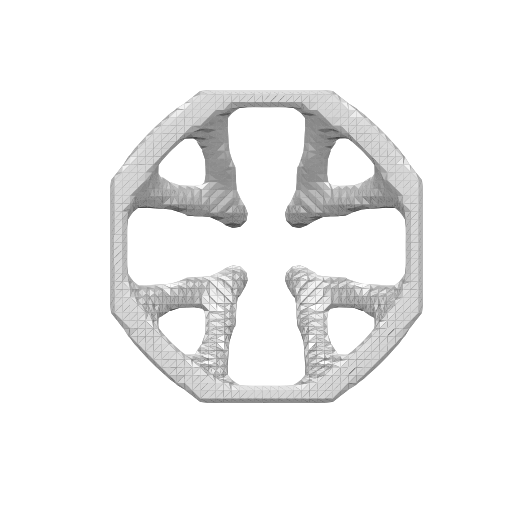

## Result Summary
VF:  tf.Tensor(0.07393169, shape=(), dtype=float32)
Mass: 79.846222 [kg]
Compliance: 8.636348e-01
Time: 85857.19 [min]
Cost: 187545.00 [$]
Max Disp: 0.07318365912608513 [mm]
comp2 tf.Tensor(0.8636348, shape=(), dtype=float32)
2
mass_vf,time_vf,cost_vf 0.46296296296296285 -0.5869270462633451 0.15201902543195478
opt1.cost_con tf.Tensor(162332.72, shape=(), dtype=float32)
vf: tf.Tensor(0.4638382, shape=(), dtype=float32)
0.5 vf: tf.Tensor(0.48421875, shape=(), dtype=float64)
0.2 mass: tf.Tensor(544.0500000000001, shape=(), dtype=float64)
cutoff 0.5571428571428572
cutoff mass:  tf.Tensor(506.41875000000016, shape=(), dtype=float64)


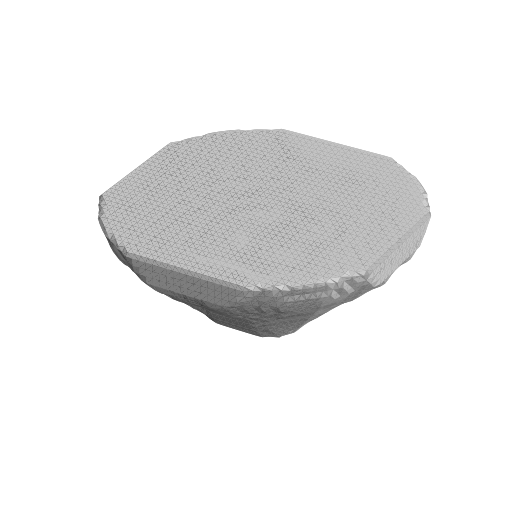

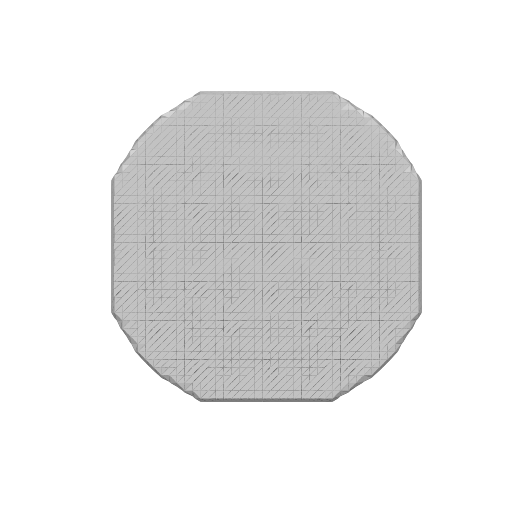

## Result Summary
VF:  tf.Tensor(0.4638382, shape=(), dtype=float32)
Mass: 500.945251 [kg]
Compliance: 1.048407e-01
Time: 33588.50 [min]
Cost: 103930.52 [$]
Max Disp: 0.013628831211592586 [mm]
comp2 tf.Tensor(0.104840726, shape=(), dtype=float32)
3
mass_vf,time_vf,cost_vf 0.46296296296296285 -1.3985193548387096 -0.1754637096774192
opt1.cost_con 178239.37692970727
vf: tf.Tensor(0.46278873, shape=(), dtype=float32)
0.5 vf: tf.Tensor(0.4625, shape=(), dtype=float64)
0.2 mass: tf.Tensor(585.9000000000001, shape=(), dtype=float64)
cutoff 0.4755102040816327
cutoff mass:  tf.Tensor(504.22500000000014, shape=(), dtype=float64)


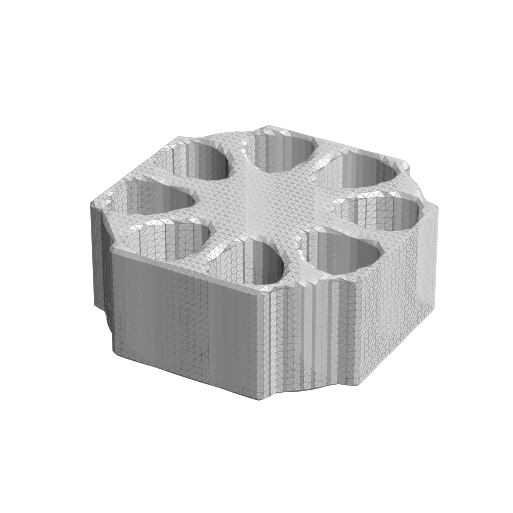

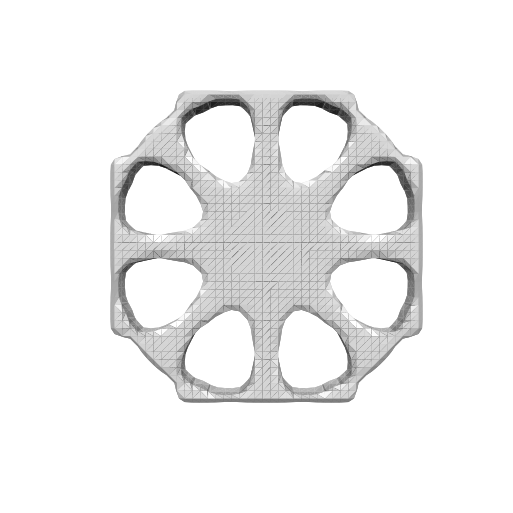

## Result Summary
VF:  tf.Tensor(0.46278873, shape=(), dtype=float32)
Mass: 499.811859 [kg]
Compliance: 1.541121e-01
Time: 12253.71 [min]
Cost: 52124.83 [$]
Max Disp: 0.013671036190906644 [mm]
comp2 tf.Tensor(0.15411215, shape=(), dtype=float32)
4
mass_vf,time_vf,cost_vf 0.28216704288939043 0.0465499302053662 0.04791359614278279
opt1.cost_con tf.Tensor(212516.03, shape=(), dtype=float32)
vf: tf.Tensor(0.046278626, shape=(), dtype=float32)
0.5 vf: tf.Tensor(0.0471875, shape=(), dtype=float64)
0.2 mass: tf.Tensor(101.75156250000003, shape=(), dtype=float64)
cutoff 0.5244897959183674
cutoff mass:  tf.Tensor(82.09343750000002, shape=(), dtype=float64)


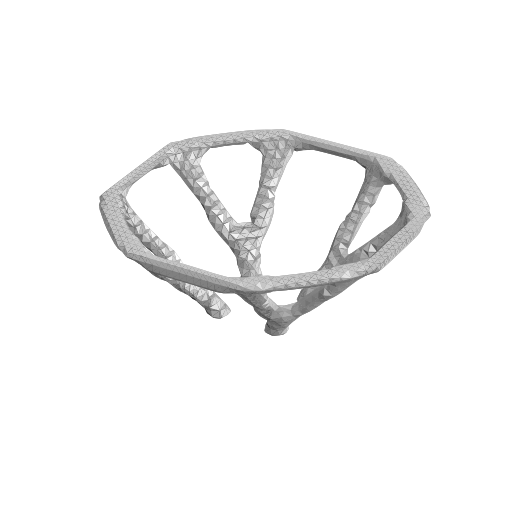

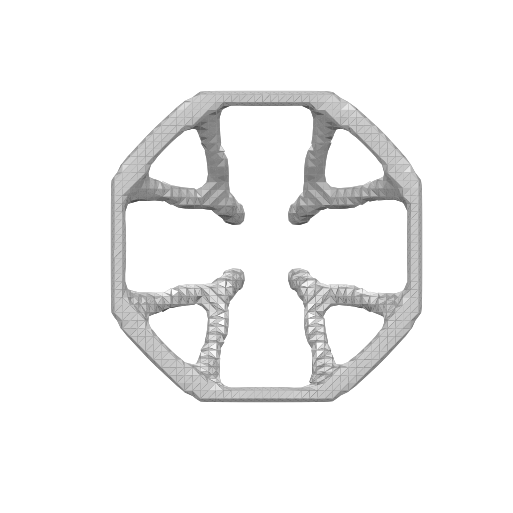

## Result Summary
VF:  tf.Tensor(0.046278626, shape=(), dtype=float32)
Mass: 82.005722 [kg]
Compliance: 9.760221e-01
Time: 83891.98 [min]
Cost: 203703.59 [$]
Max Disp: 0.06242886085049051 [mm]
comp2 tf.Tensor(0.9760222, shape=(), dtype=float32)
5
mass_vf,time_vf,cost_vf 0.28216704288939043 0.8382483647801025 0.913574347253965
opt1.cost_con tf.Tensor(336292.12, shape=(), dtype=float32)
6
mass_vf,time_vf,cost_vf 0.28216704288939043 -1.3985193548387096 -0.1754637096774192
opt1.cost_con 352199.37692970736
vf: tf.Tensor(0.28257778, shape=(), dtype=float32)
0.5 vf: tf.Tensor(0.3, shape=(), dtype=float64)
0.2 mass: tf.Tensor(620.2000000000002, shape=(), dtype=float64)
cutoff 0.5244897959183674
cutoff mass:  tf.Tensor(522.7400000000001, shape=(), dtype=float64)


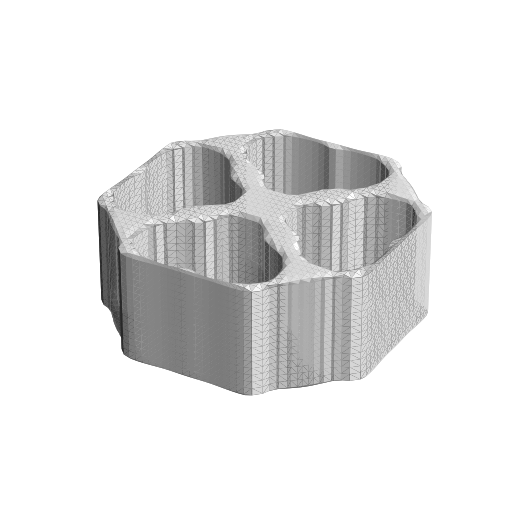

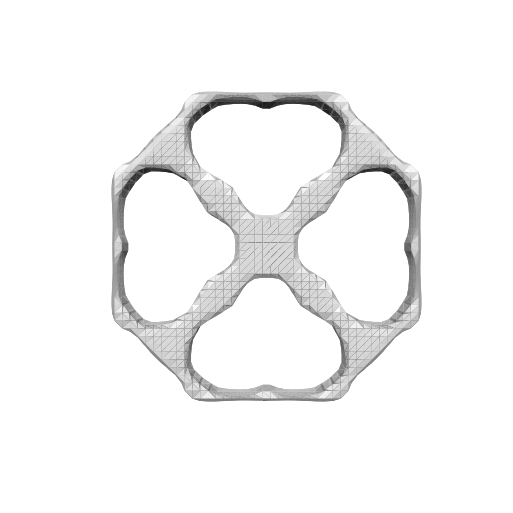

## Result Summary
VF:  tf.Tensor(0.28257778, shape=(), dtype=float32)
Mass: 500.727844 [kg]
Compliance: 2.286607e-01
Time: 12685.12 [min]
Cost: 227810.48 [$]
Max Disp: 0.020614848206953182 [mm]
comp2 tf.Tensor(0.22866075, shape=(), dtype=float32)
7
mass_vf,time_vf,cost_vf 0.99999 -0.5118107833163756 0.19226999537679157
opt1.cost_con tf.Tensor(159937.6, shape=(), dtype=float32)
vf: tf.Tensor(0.9999997, shape=(), dtype=float32)
0.5 vf: tf.Tensor(1.0, shape=(), dtype=float64)
0.2 mass: tf.Tensor(424.00000000000006, shape=(), dtype=float64)
cutoff 0.9
cutoff mass:  tf.Tensor(424.00000000000006, shape=(), dtype=float64)


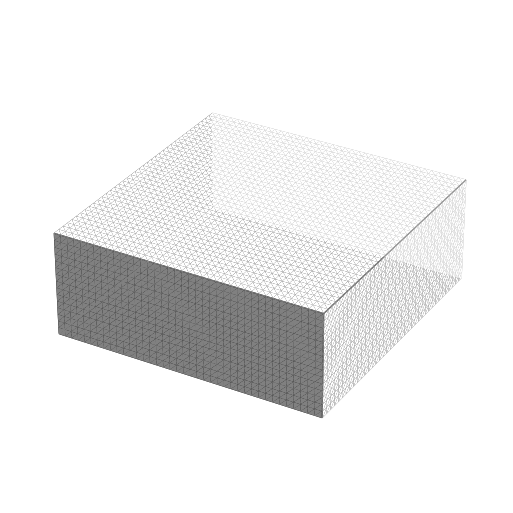

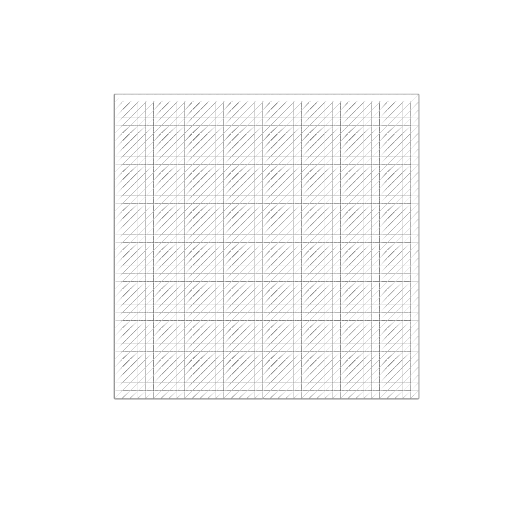

## Result Summary
VF:  tf.Tensor(0.9999997, shape=(), dtype=float32)
Mass: 423.999878 [kg]
Compliance: 2.203766e+00
Time: 115.02 [min]
Cost: 1118.06 [$]
Max Disp: 0.08648851012737017 [mm]
comp2 tf.Tensor(2.2037656, shape=(), dtype=float32)
8
mass_vf,time_vf,cost_vf 0.99999 0.19423860767352344 0.2002415763140721
opt1.cost_con tf.Tensor(175173.92, shape=(), dtype=float32)
vf: tf.Tensor(0.1962698, shape=(), dtype=float32)
0.5 vf: tf.Tensor(0.1909765625, shape=(), dtype=float64)
0.2 mass: tf.Tensor(91.16000000000003, shape=(), dtype=float64)
cutoff 0.3938775510204082
cutoff mass:  tf.Tensor(83.87250000000002, shape=(), dtype=float64)


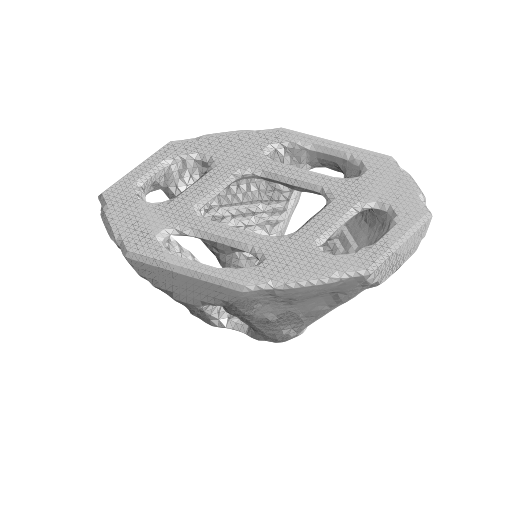

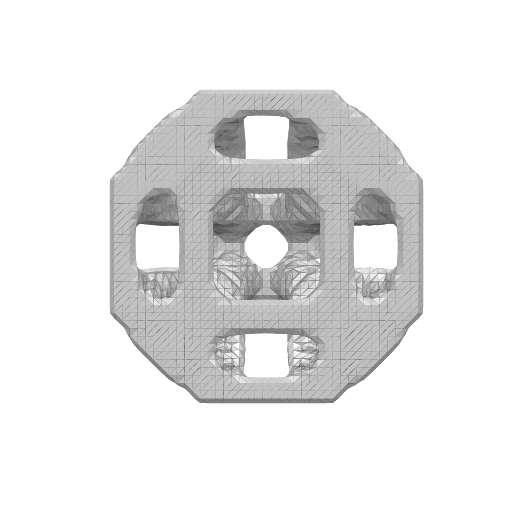

## Result Summary
VF:  tf.Tensor(0.1962698, shape=(), dtype=float32)
Mass: 83.218399 [kg]
Compliance: 7.799273e+00
Time: 85307.13 [min]
Cost: 170744.73 [$]
Max Disp: 0.3524531004921416 [mm]
comp2 tf.Tensor(7.7992725, shape=(), dtype=float32)
9
mass_vf,time_vf,cost_vf 0.99999 -1.3985193548387096 -0.1754637096774192
opt1.cost_con 175847.37692970727
vf: tf.Tensor(0.99999017, shape=(), dtype=float32)
0.5 vf: tf.Tensor(1.0, shape=(), dtype=float64)
0.2 mass: tf.Tensor(424.00000000000006, shape=(), dtype=float64)
cutoff 0.9
cutoff mass:  tf.Tensor(424.00000000000006, shape=(), dtype=float64)


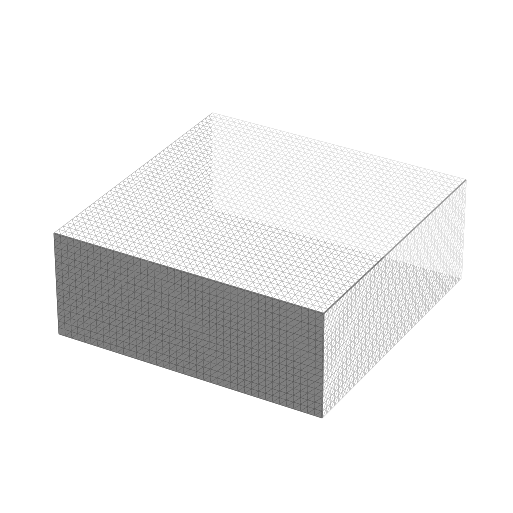

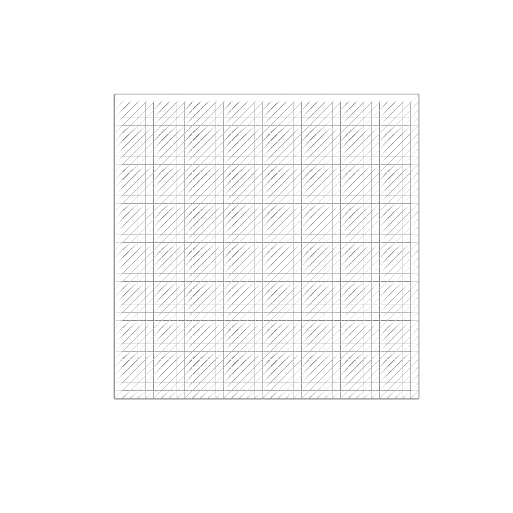

## Result Summary
VF:  tf.Tensor(0.99999017, shape=(), dtype=float32)
Mass: 423.995850 [kg]
Compliance: 2.203717e+00
Time: 329.97 [min]
Cost: 2037.86 [$]
Max Disp: 0.08648873257321821 [mm]
comp2 tf.Tensor(2.2037168, shape=(), dtype=float32)
1
mass_vf,time_vf,cost_vf 0.03703703703703703 0.04006652283351313 0.03366594750089896
opt1.cost_con tf.Tensor(81928.26, shape=(), dtype=float32)
vf: tf.Tensor(0.034570787, shape=(), dtype=float32)
0.5 vf: tf.Tensor(0.034375, shape=(), dtype=float64)
0.2 mass: tf.Tensor(49.95000000000002, shape=(), dtype=float64)
cutoff 0.4591836734693878
cutoff mass:  tf.Tensor(37.46250000000001, shape=(), dtype=float64)


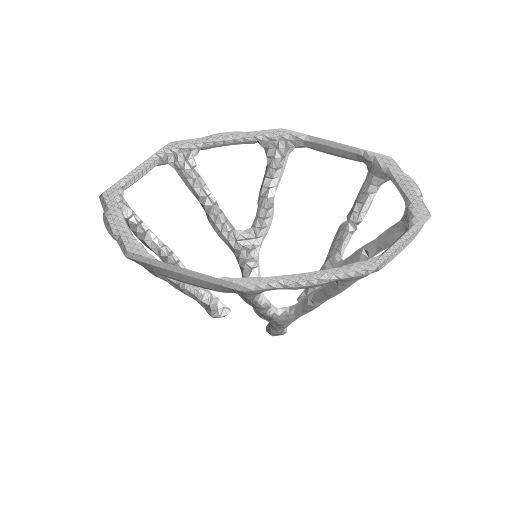

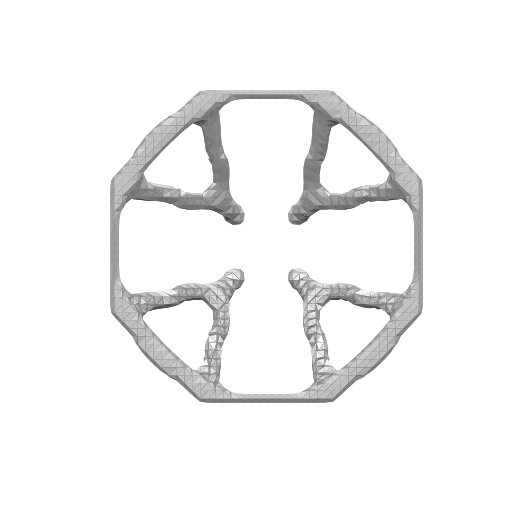

## Result Summary
VF:  tf.Tensor(0.034570787, shape=(), dtype=float32)
Mass: 37.336452 [kg]
Compliance: 2.588863e+00
Time: 37555.95 [min]
Cost: 82006.80 [$]
Max Disp: 0.1816304215005874 [mm]
comp2 tf.Tensor(2.5888631, shape=(), dtype=float32)
2
mass_vf,time_vf,cost_vf 0.03703703703703703 0.2074196017014006 0.6374016894844159
opt1.cost_con tf.Tensor(71422.914, shape=(), dtype=float32)
3
mass_vf,time_vf,cost_vf 0.03703703703703703 -0.19851935483870964 0.4965793010752688
opt1.cost_con 78239.16142924289
4
mass_vf,time_vf,cost_vf 0.022573363431151235 0.024419776896272102 0.02051829936445321
opt1.cost_con tf.Tensor(91064.055, shape=(), dtype=float32)
vf: tf.Tensor(0.021314586, shape=(), dtype=float32)
0.5 vf: tf.Tensor(0.0198828125, shape=(), dtype=float64)
0.2 mass: tf.Tensor(57.24390625000001, shape=(), dtype=float64)
cutoff 0.4591836734693878
cutoff mass:  tf.Tensor(39.24703125000001, shape=(), dtype=float64)


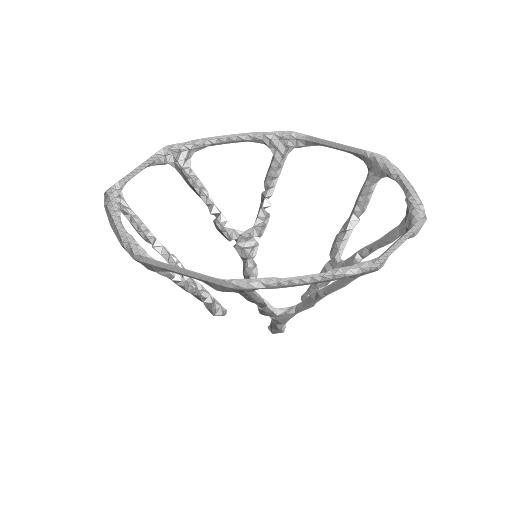

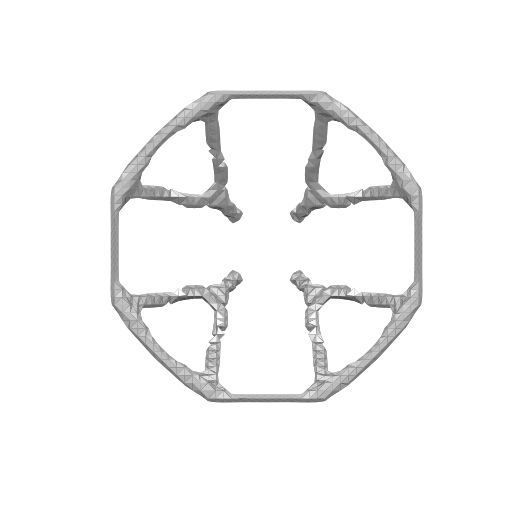

## Result Summary
VF:  tf.Tensor(0.021314586, shape=(), dtype=float32)
Mass: 37.769447 [kg]
Compliance: 3.737313e+00
Time: 38249.24 [min]
Cost: 92837.38 [$]
Max Disp: 0.24403975188875388 [mm]
comp2 tf.Tensor(3.7373128, shape=(), dtype=float32)
5
mass_vf,time_vf,cost_vf 0.022573363431151235 0.9192203184461512 0.9630435427859072
opt1.cost_con tf.Tensor(245383.9, shape=(), dtype=float32)
6
mass_vf,time_vf,cost_vf 0.022573363431151235 -0.19851935483870964 0.4965793010752688
opt1.cost_con 252199.16142924293
7
mass_vf,time_vf,cost_vf 0.0943396226415094 0.24502610700481453 0.6546185852981969
opt1.cost_con tf.Tensor(69028.5, shape=(), dtype=float32)
8
mass_vf,time_vf,cost_vf 0.0943396226415094 0.10205619161018503 0.08575174024546622
opt1.cost_con tf.Tensor(75073.91, shape=(), dtype=float32)
vf: tf.Tensor(0.08498604, shape=(), dtype=float32)
0.5 vf: tf.Tensor(0.0851953125, shape=(), dtype=float64)
0.2 mass: tf.Tensor(41.80375000000001, shape=(), dtype=float64)
cutoff 0.5081632653061224
cutoff m

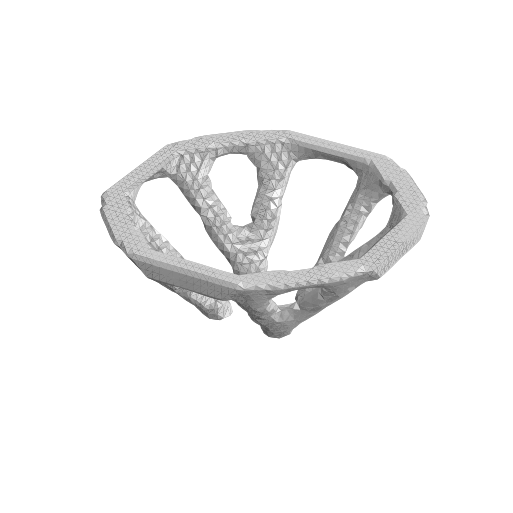

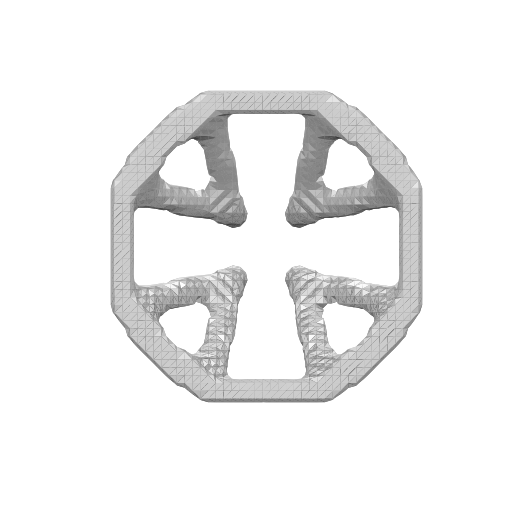

## Result Summary
VF:  tf.Tensor(0.08498604, shape=(), dtype=float32)
Mass: 36.034084 [kg]
Compliance: 2.105843e+01
Time: 37502.85 [min]
Cost: 75040.56 [$]
Max Disp: 2.116936693653057 [mm]
comp2 tf.Tensor(21.058434, shape=(), dtype=float32)
9
mass_vf,time_vf,cost_vf 0.0943396226415094 -0.19851935483870964 0.4965793010752688
opt1.cost_con 75847.16142924289


In [1]:
from optimization_sp import run_opt
from optimization_sp import run_batch_opt
import os

# run_batch_opt("Studies/MVP_format_test_1/request_header.json","Studies/MVP_format_test_1","Studies/MVP_format_test_1/bc.json","Resources/mat_lib.json",'Resources/machine.json')

study_folder = "Studies/Engine_Mounting_Bracket_MVP"
for i in range(1,10):
    print(i)
    folder_name = "Past/Iter0/"+"config_{}".format(i)
    config_path = os.path.join(study_folder, folder_name)
    # run_opt(os.path.join(study_folder,"Past/Iter0/request_header.json"),os.path.join(config_path,"mmm.json"), os.path.join(study_folder,"bc.json"), "Resources/mat_lib.json",'Resources/machine.json',os.path.join(study_folder,"Past/Iter0/constraints.json"),probe = True, test = False)
    run_opt(os.path.join(study_folder,"Past/Iter0/request_header.json"),os.path.join(config_path,"mmm.json"), os.path.join(study_folder,"bc.json"), "Resources/mat_lib.json",'Resources/machine.json',os.path.join(study_folder,"Past/Iter0/constraints.json"),probe = False, test = True)

study_folder = "Studies/Engine_Mounting_Bracket_MVP"
for i in range(1,10):
    print(i)
    folder_name = "config_{}".format(i)
    config_path = os.path.join(study_folder, folder_name)
    # run_opt(os.path.join(study_folder,"request_header.json"),os.path.join(config_path,"mmm.json"), os.path.join(study_folder,"bc.json"), "Resources/mat_lib.json",'Resources/machine.json',os.path.join(study_folder,"constraints.json"),probe = True, test = False)
    run_opt(os.path.join(study_folder,"request_header.json"),os.path.join(config_path,"mmm.json"), os.path.join(study_folder,"bc.json"), "Resources/mat_lib.json",'Resources/machine.json',os.path.join(study_folder,"constraints.json"),probe = False, test = True)



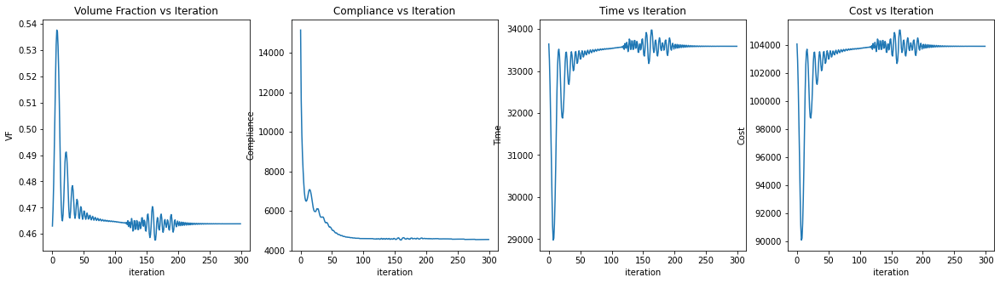

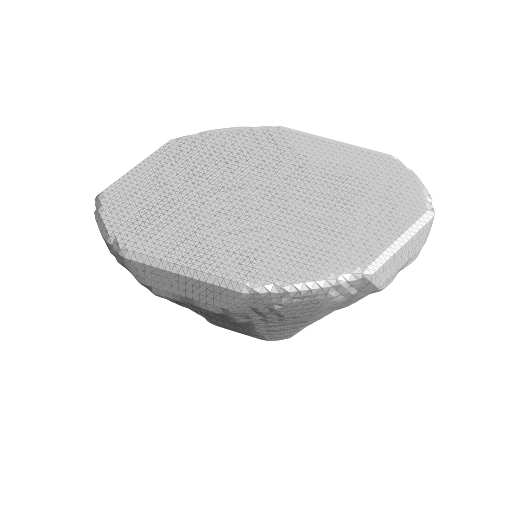

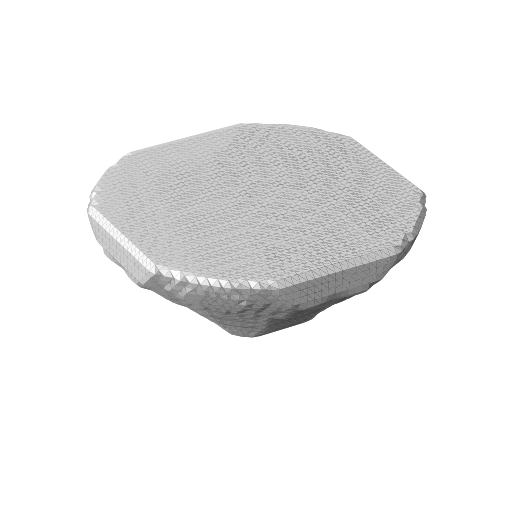

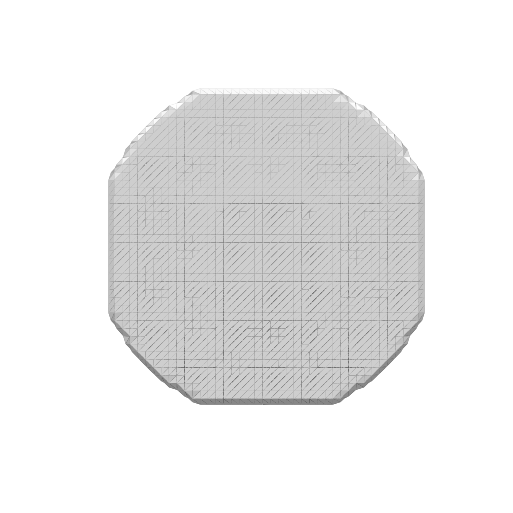

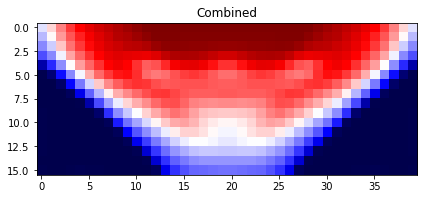

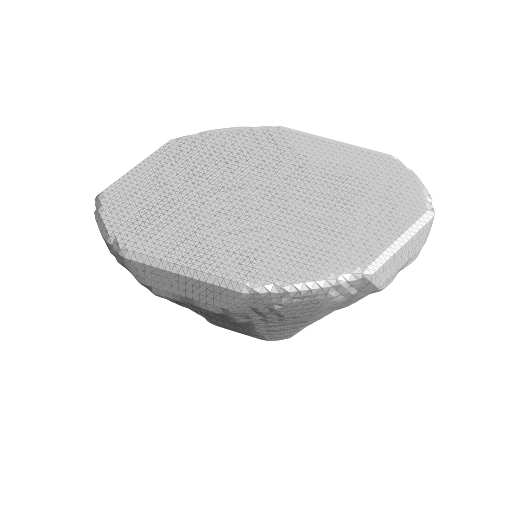

## Result Summary
VF:  tf.Tensor(0.4638412, shape=(), dtype=float32)
Mass: 500.948517 [kg]
Compliance: 1.048245e-01
Time: 33588.32 [min]
Cost: 103929.95 [$]
Status Code: 200, Response: {'status': 'success', 'data': [{'id': 1, 'suppliers': ['Supplier-A'], 'order': 'Request-A', 'processPlan': '3-Axis-Subtractive-1', 'leadTime': 1812188, 'earliestStartTime': '2022-02-05T08:00:00+0000', 'earliestFinishTime': '2022-02-26T07:23:08+0000', 'cost': 110652}]}


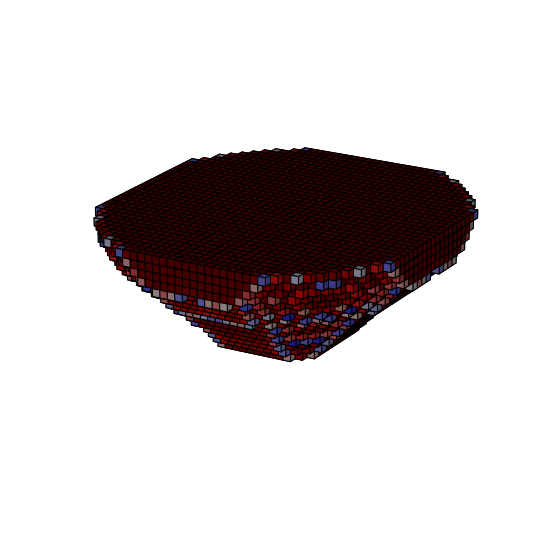

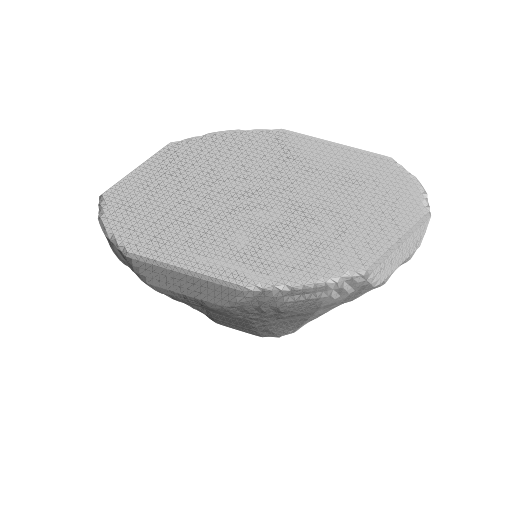

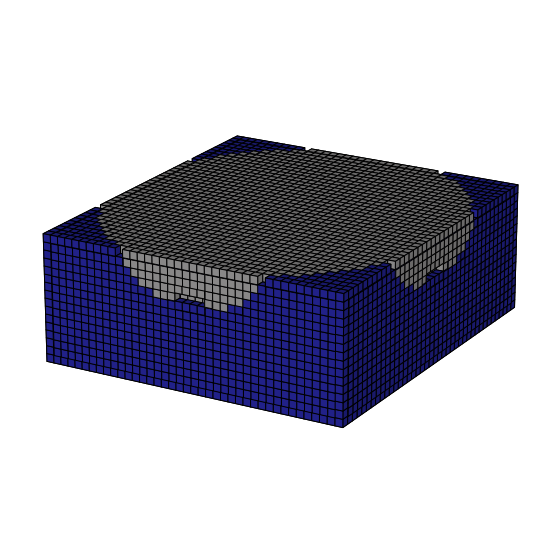

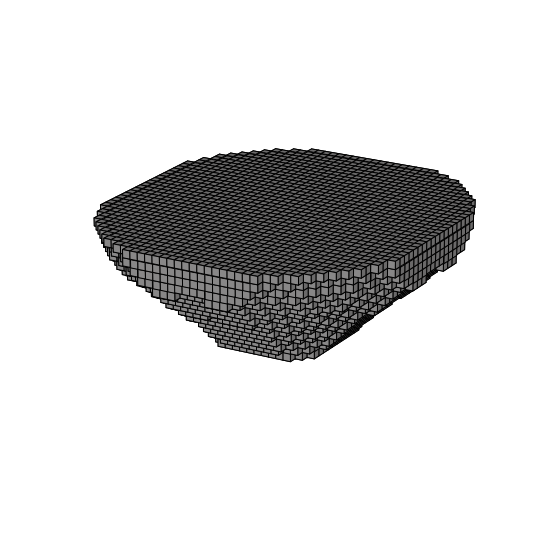

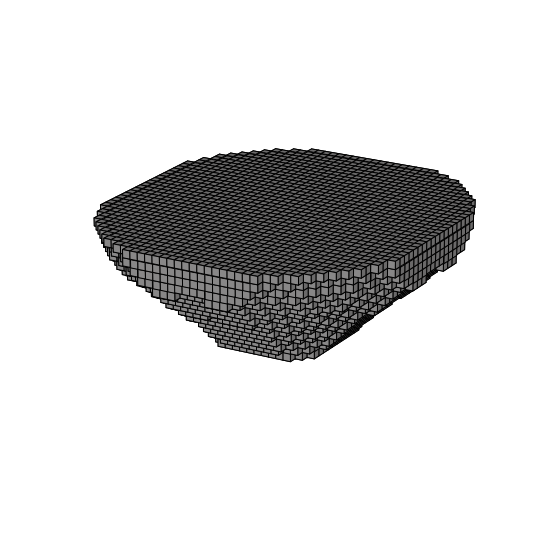

...

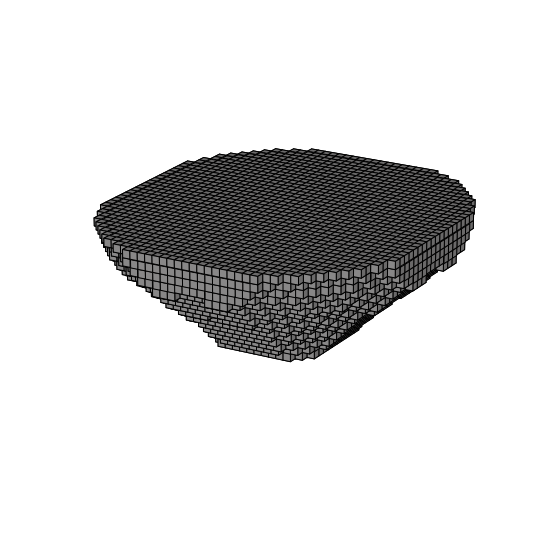

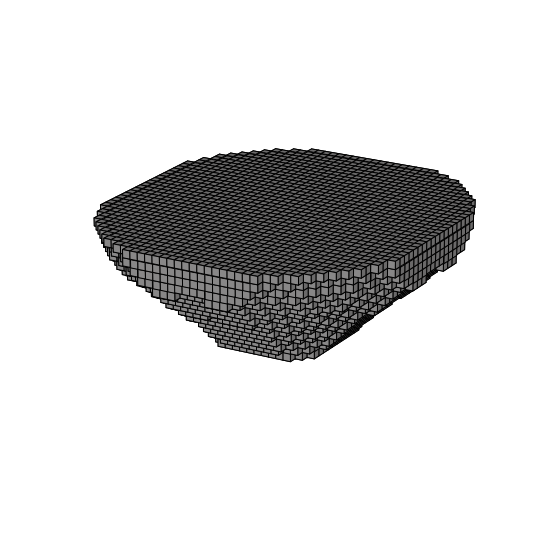

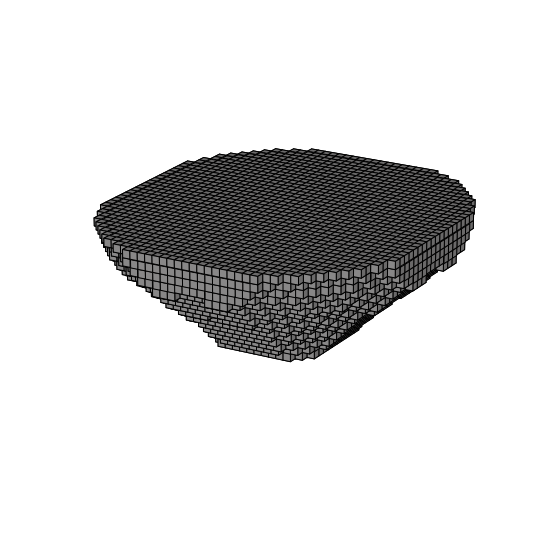

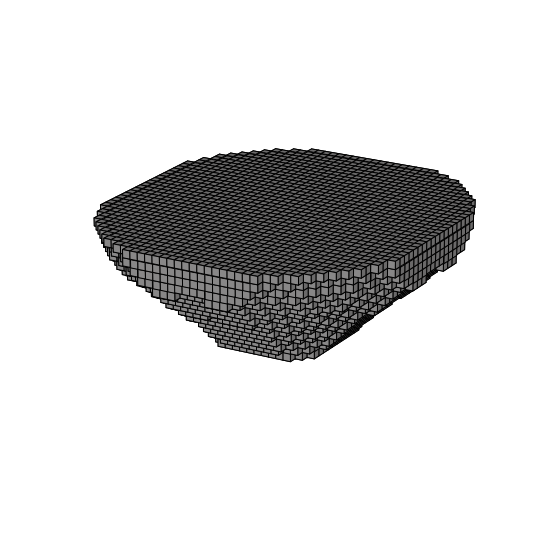

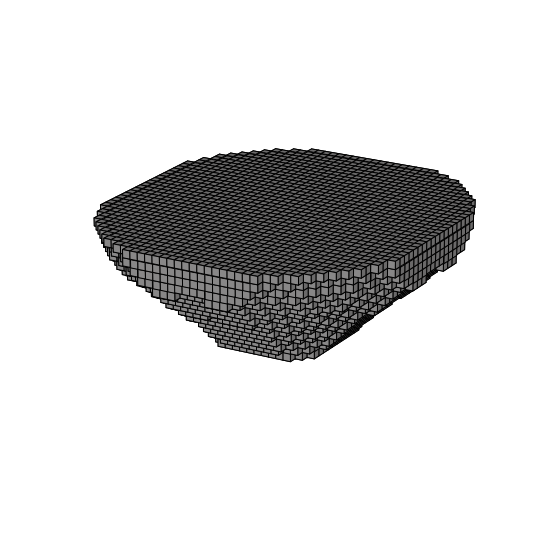

In [1]:
from optimization_sp import run_opt
from optimization_sp import run_batch_opt
import os

# run_batch_opt("Studies/MVP_format_test_1/request_header.json","Studies/MVP_format_test_1","Studies/MVP_format_test_1/bc.json","Resources/mat_lib.json",'Resources/machine.json')

study_folder = "Studies/Engine_Mounting_Bracket_MVP_test"
for i in range(2,3):
    print(i)
    folder_name = "Past/Iter0/"+"config_{}".format(i)
    config_path = os.path.join(study_folder, folder_name)
    run_opt(os.path.join(study_folder,"Past/Iter0/request_header.json"),os.path.join(config_path,"mmm.json"), os.path.join(study_folder,"bc.json"), "Resources/mat_lib.json",'Resources/machine.json',os.path.join(study_folder,"Past/Iter0/constraints.json"),probe = True, test = False)
    run_opt(os.path.join(study_folder,"Past/Iter0/request_header.json"),os.path.join(config_path,"mmm.json"), os.path.join(study_folder,"bc.json"), "Resources/mat_lib.json",'Resources/machine.json',os.path.join(study_folder,"Past/Iter0/constraints.json"),probe = False, test = False)

# study_folder = "Studies/Engine_Mounting_Bracket_MVP_test"
# for i in range(4,5):
#     print(i)
#     folder_name = "config_{}".format(i)
#     config_path = os.path.join(study_folder, folder_name)
#     run_opt(os.path.join(study_folder,"request_header.json"),os.path.join(config_path,"mmm.json"), os.path.join(study_folder,"bc.json"), "Resources/mat_lib.json",'Resources/machine.json',os.path.join(study_folder,"constraints.json"),probe = True, test = False)
#     run_opt(os.path.join(study_folder,"request_header.json"),os.path.join(config_path,"mmm.json"), os.path.join(study_folder,"bc.json"), "Resources/mat_lib.json",'Resources/machine.json',os.path.join(study_folder,"constraints.json"),probe = False, test = False)



In [3]:
import pandas as pd

data_dict = {'Manufacturing Method':[],'Material':[],'mass constraint':[],'cost constraint':[],'time constraint':[],'mass':[],'compliance':[],'nominal time':[],'nominal cost':[]}
design_ai_data = pd.DataFrame(data = data_dict)
folders = os.listdir("Studies/CB")
for folder in folders:
    if "config" in folder:
        if '3' not in folder and '6' not in folder and '9' not in folder:
            df = pd.read_csv("Studies/CB/" + folder + '/final_results.csv')
            design_ai_data = pd.concat([design_ai_data,df])
for folder in folders:
    if "config_3" in folder:
        if 'config_3_3' not in folder and 'config_3_6' not in folder and 'config_3_9' not in folder:
            df = pd.read_csv("Studies/CB/" + folder + '/final_results.csv')
            design_ai_data = pd.concat([design_ai_data,df])
print(design_ai_data)
design_ai_data.to_csv(os.path.join("Studies/CB/" + 'final_results.csv'),index = False)

  Manufacturing Method    Material  mass constraint  cost constraint  \
0          Additive y+      Al6061              0.5            500.0   
0       Subtractive x+      Al6061              0.5            500.0   
0          Additive y+     Ti6Al4V              0.5            500.0   
0       Subtractive x+     Ti6Al4V              0.5            500.0   
0       Subtractive x+  ABSplastic              0.5            500.0   
0          Additive y+  ABSplastic              0.5            500.0   
0          Additive y+      Al6061              0.2            500.0   
0       Subtractive x+      Al6061              0.2            500.0   
0       Subtractive x+     Ti6Al4V              0.2            500.0   
0          Additive y+     Ti6Al4V              0.2            500.0   
0       Subtractive x+  ABSplastic              0.2            500.0   
0          Additive y+  ABSplastic              0.2            500.0   
0          Additive y+      Al6061            100.0           50

In [2]:
import pandas as pd

probe_dict = {'Manufacturing Method':[], 'Material':[], 'mass low':[],'mass high':[],'comp low':[],'comp high':[],'time low':[],'time high':[],'cost low':[],'cost high':[]}
design_ai_data = pd.DataFrame(data = probe_dict)
folders = os.listdir("Studies/CB")
for folder in folders:
    if "config_1" in folder:
        # if '3' not in folder and '6' not in folder and '9' not in folder:
        df = pd.read_csv("Studies/CB/" + folder + '/probe_results.csv')
        design_ai_data = pd.concat([design_ai_data,df])
print(design_ai_data)
design_ai_data.to_csv(os.path.join("Studies/CB/" + 'probe_results.csv'),index = False)

  Manufacturing Method    Material   mass low  mass high      comp low  \
0          Additive y+      Al6061  55.296011   1105.920  3.062603e-08   
0       Subtractive x+      Al6061  55.296011   1105.920  3.062260e-08   
0                EDM z      Al6061  55.296011   1105.920  3.062434e-08   
0          Additive y+     Ti6Al4V  90.726417   1814.528  1.825706e-08   
0       Subtractive x+     Ti6Al4V  90.726417   1814.528  1.825917e-08   
0                EDM z     Ti6Al4V  90.726417   1814.528  1.825670e-08   
0       Subtractive x+  ABSplastic  21.708804    434.176  9.186795e-07   
0          Additive y+  ABSplastic  21.708804    434.176  9.185391e-07   
0                EDM z  ABSplastic  21.708804    434.176  9.185507e-07   

   comp high    time low    time high    cost low    cost high  
0   0.000012  126.954880  1209.097534  224.446411  2588.928223  
0   0.000012  115.000000   175.733566  273.317749   455.518463  
0   0.000012   55.000000   281.176487   93.317760   998.023710  

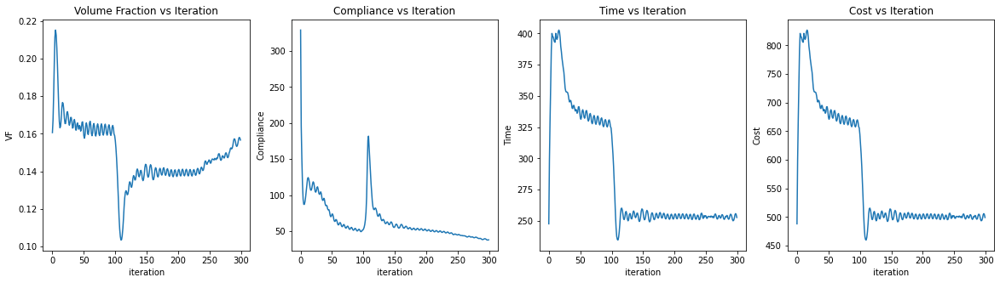

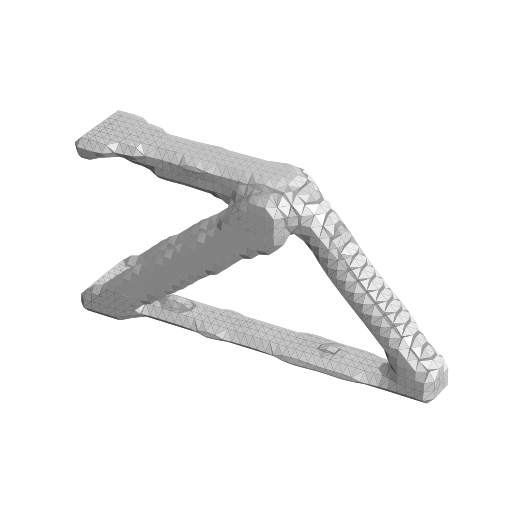

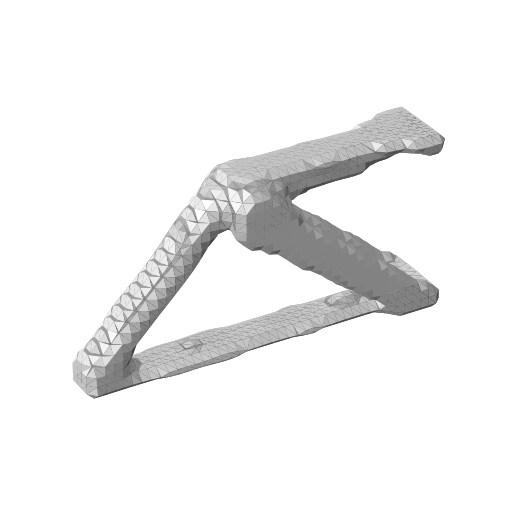

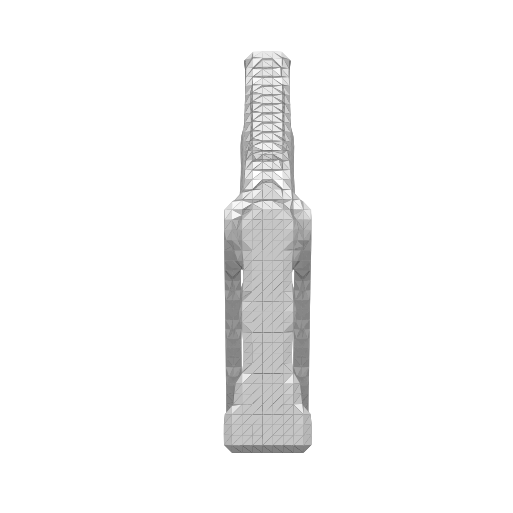

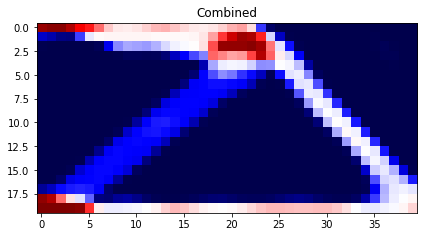

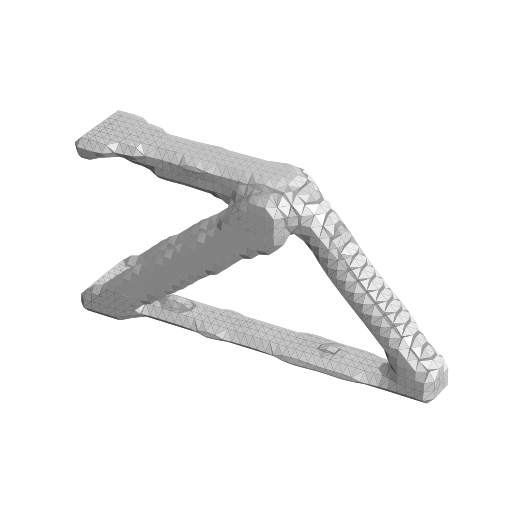

## Result Summary
VF:  tf.Tensor(0.15664467, shape=(), dtype=float32)
Mass: 0.173236 [kg]
Compliance: 1.337267e-01
Time: 253.74 [min]
Cost: 501.48 [$]
max d:  0.10633802925228918
comp:  0.11736050993204117
Status Code: 200, Response: {'status': 'success', 'data': [{'id': 1, 'suppliers': 'Supplier-B', 'order': 'Request-A', 'processPlan': 'SLM-Additive-1', 'leadTime': 1522458, 'earliestStartTime': '2015-11-06T00:00:00+0000', 'earliestFinishTime': '2015-11-23T14:54:18+0000', 'cost': 50199.24}, {'id': 2, 'suppliers': 'Supplier-C', 'order': 'Request-A', 'processPlan': 'SLM-Additive-1', 'leadTime': 1522458, 'earliestStartTime': '2015-11-06T00:00:00+0000', 'earliestFinishTime': '2015-11-23T14:54:18+0000', 'cost': 75298.86}]}


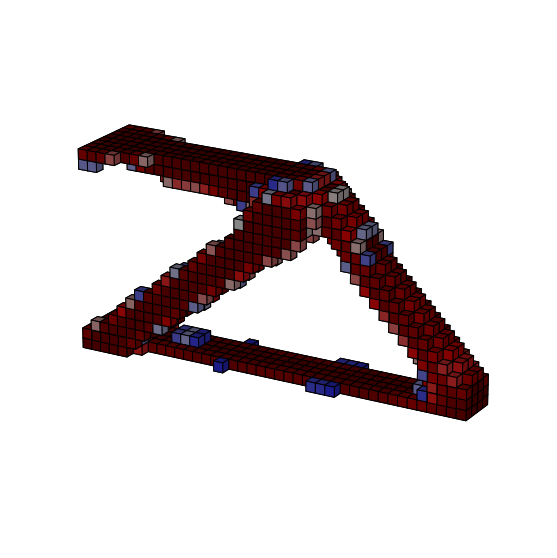

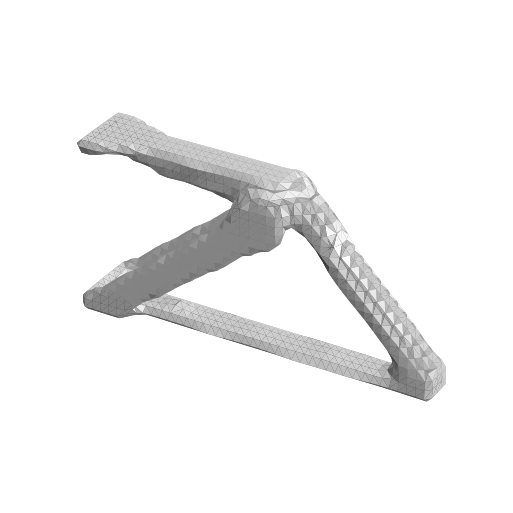

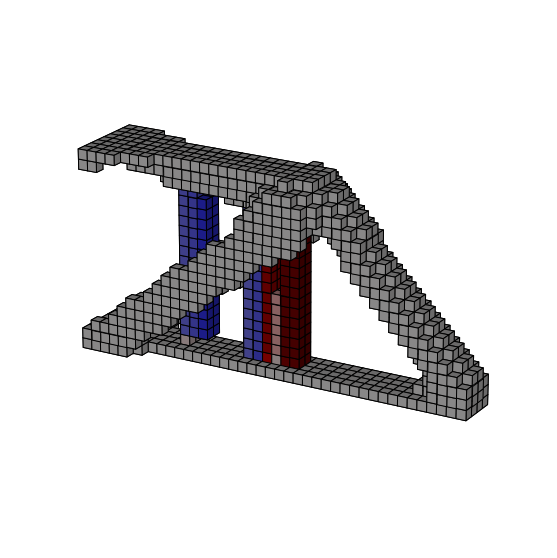

In [1]:
from optimization_sp import run_opt
from optimization_sp import run_batch_opt
import os

# run_batch_opt("Studies/MVP_format_test_1/request_header.json","Studies/MVP_format_test_1","Studies/MVP_format_test_1/bc.json","Resources/mat_lib.json",'Resources/machine.json')

study_folder = "Studies/CB_Scenario_1"
for i in range(1,2):
    print(i)
    folder_name = "Past/Iter0/"+"config_{}".format(i)
    config_path = os.path.join(study_folder, folder_name)
    # run_opt(os.path.join(study_folder,"Past/Iter0/request_header.json"),os.path.join(config_path,"mmm.json"), os.path.join(study_folder,"bc.json"), "Resources/mat_lib.json",'Resources/machine.json',os.path.join(study_folder,"Past/Iter0/constraints.json"),probe = True, test = False)
    run_opt(os.path.join(study_folder,"Past/Iter0/request_header.json"),os.path.join(config_path,"mmm.json"), os.path.join(study_folder,"bc.json"), "Resources/mat_lib.json",'Resources/machine.json',os.path.join(study_folder,"Past/Iter0/constraints.json"),probe = False, test = False)


1
vf_arr:  [[-1.          0.33043695  0.33043695]
 [-1.          0.16059529  0.09368058]]
mass_vf,time_vf,cost_vf 0.45211226851851855 0.33043695060745376 0.16059529463816474
cost_vf
opt1.time_con tf.Tensor(446.3999, shape=(), dtype=float32)
opt1.cost_con tf.Tensor(499.71017, shape=(), dtype=float32)


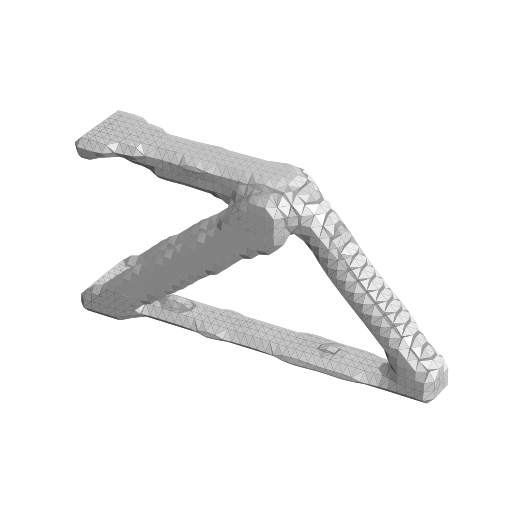

## Result Summary
VF:  tf.Tensor(0.15664467, shape=(), dtype=float32)
Mass: 0.173236 [kg]
Compliance: 1.120862e-01
Time: 253.74 [min]
Cost: 501.48 [$]
max d:  0.10102604110867933
comp:  0.112086221575737
vf: tf.Tensor(0.15664467, shape=(), dtype=float32)
0.5 vf: tf.Tensor(0.1546875, shape=(), dtype=float64)
0.2 mass: tf.Tensor(0.195264, shape=(), dtype=float64)
cutoff 0.42653061224489797
cutoff mass:  tf.Tensor(0.17383679999999999, shape=(), dtype=float64)
## Result Summary
VF:  tf.Tensor(0.15664467, shape=(), dtype=float32)
Mass: 0.173236 [kg]
Compliance: 1.120862e-01
Time: 253.74 [min]
Cost: 501.48 [$]
Max Disp: 0.10102604114624629 [mm]
2
vf_arr:  [[-4.91079861  1.         -4.91079861]
 [ 0.05878533  1.          0.849922  ]]
mass_vf,time_vf,cost_vf 0.45211226851851855 -4.910798611111235 0.058785333333333245
cost_vf
opt1.time_con tf.Tensor(492.87778, shape=(), dtype=float32)
opt1.cost_con tf.Tensor(453.83353, shape=(), dtype=float32)
opt1.c_0 tf.Tensor(9.965824e-13, shape=(), dtype=fl

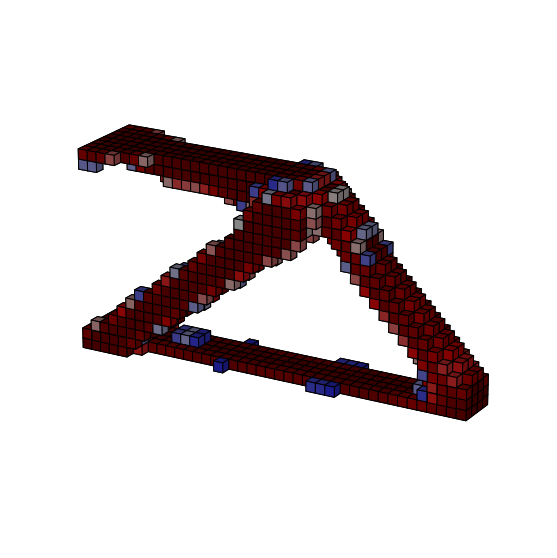

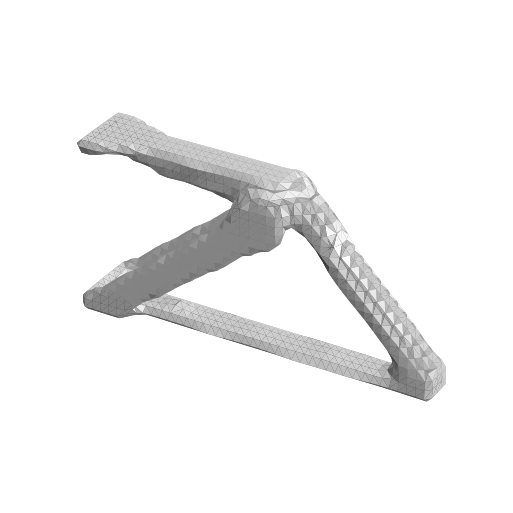

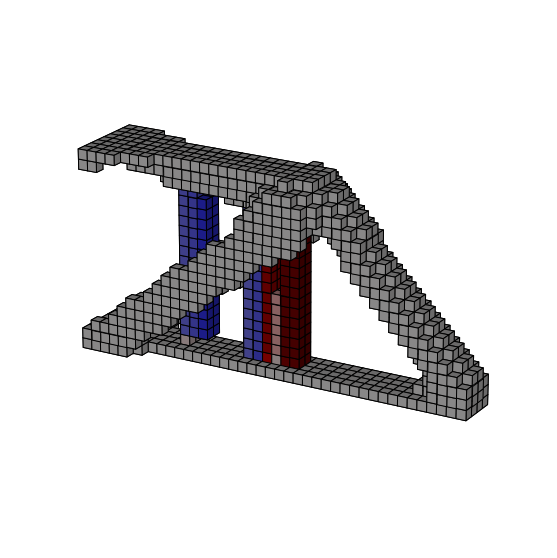

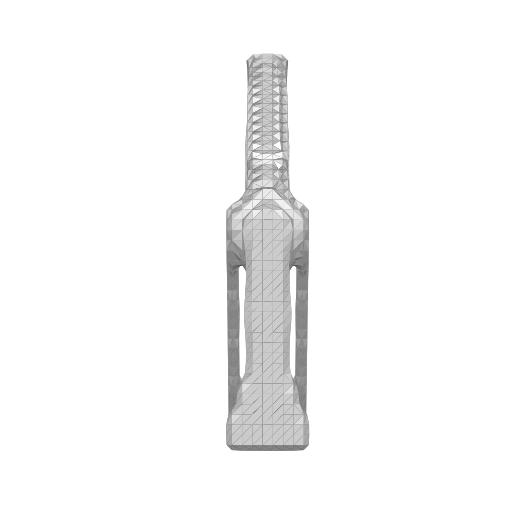

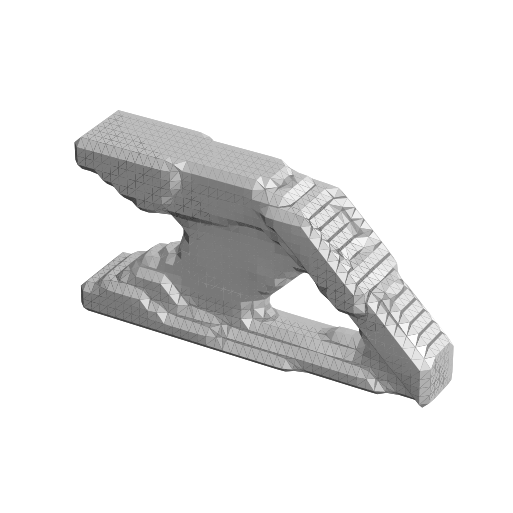

## Result Summary
VF:  tf.Tensor(0.45258176, shape=(), dtype=float32)
Mass: 0.500519 [kg]
Compliance: 4.326856e-02
Time: 150.00 [min]
Cost: 378.31 [$]
max d:  0.03298312313085212
comp:  0.043268561363220215
vf: tf.Tensor(0.45258176, shape=(), dtype=float32)
0.5 vf: tf.Tensor(0.4521875, shape=(), dtype=float64)
0.2 mass: tf.Tensor(0.5128704000000001, shape=(), dtype=float64)
cutoff 0.4591836734693878
cutoff mass:  tf.Tensor(0.5021568000000001, shape=(), dtype=float64)
## Result Summary
VF:  tf.Tensor(0.45258176, shape=(), dtype=float32)
Mass: 0.500519 [kg]
Compliance: 4.326856e-02
Time: 150.00 [min]
Cost: 378.31 [$]
Max Disp: 0.032983122938275385 [mm]
3
vf_arr:  [[-0.64398269  1.         -0.64398269]
 [ 0.57324771  1.          0.74823538]]
mass_vf,time_vf,cost_vf 0.45211226851851855 -0.6439826948924683 0.5732477083333334
cost_vf
opt1.time_con 446.40024346752347
opt1.cost_con 499.7233782041071
4
vf_arr:  [[-1.          0.201395   -1.        ]
 [-1.          0.08807108 -1.        ]]
mass_

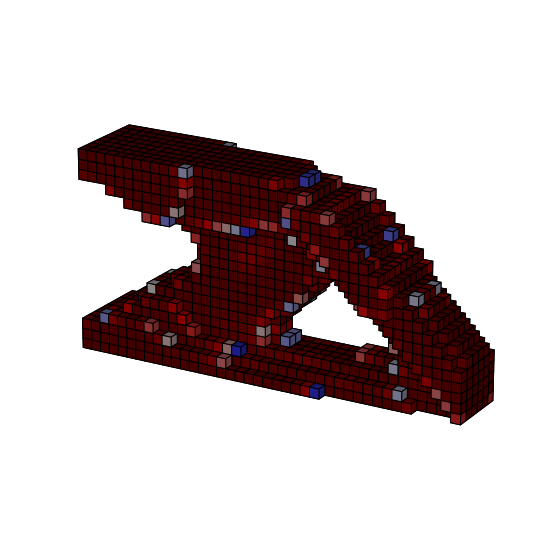

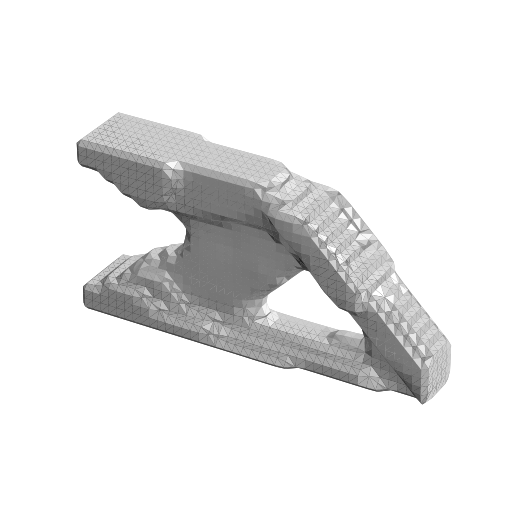

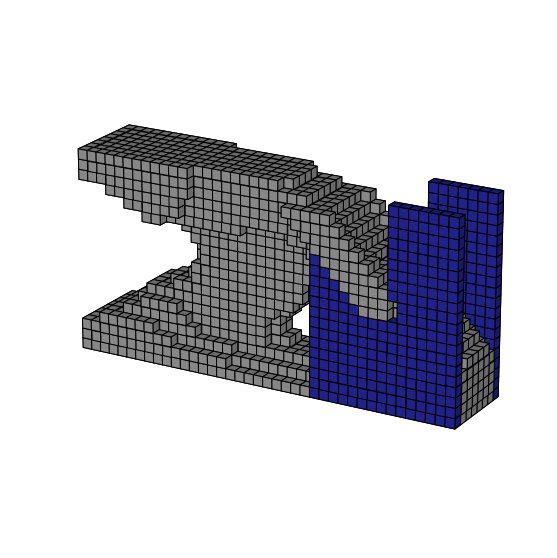

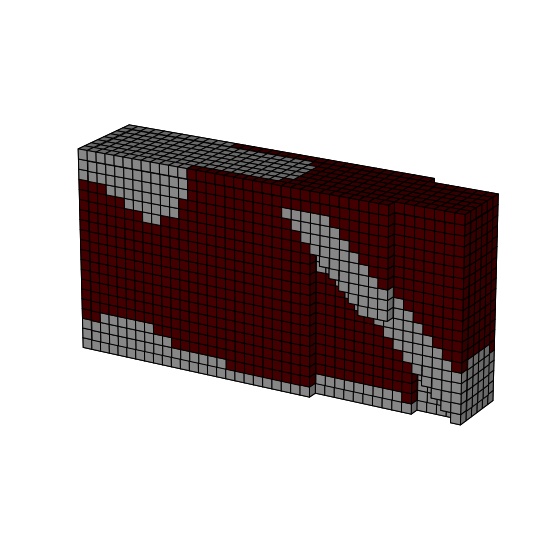

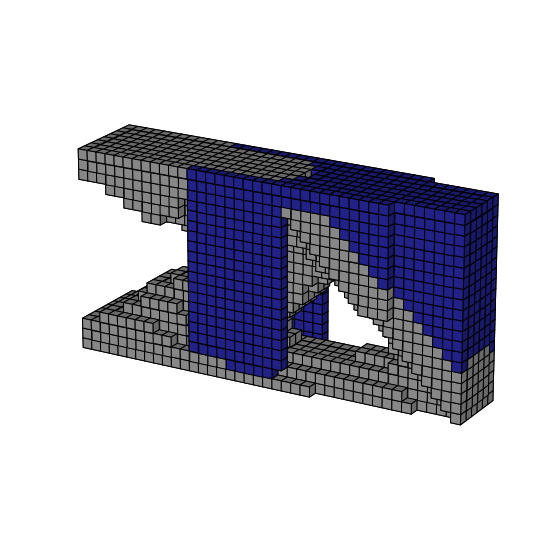

...

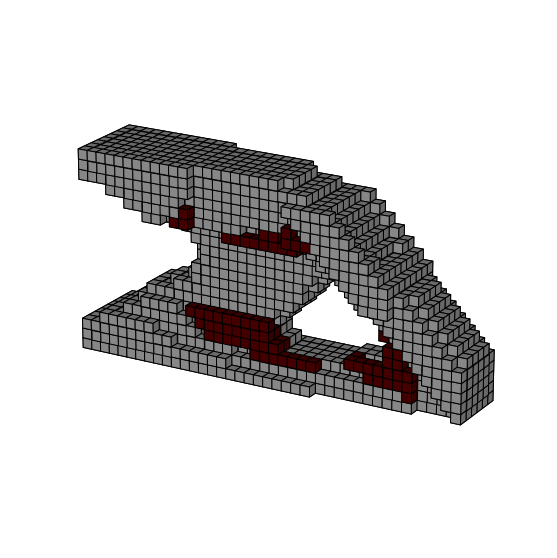

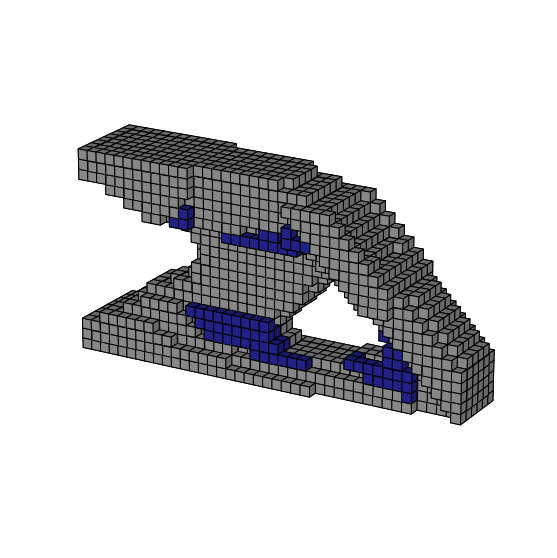

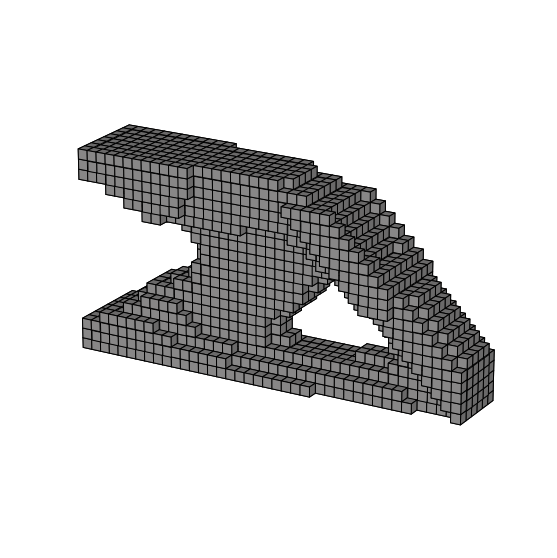

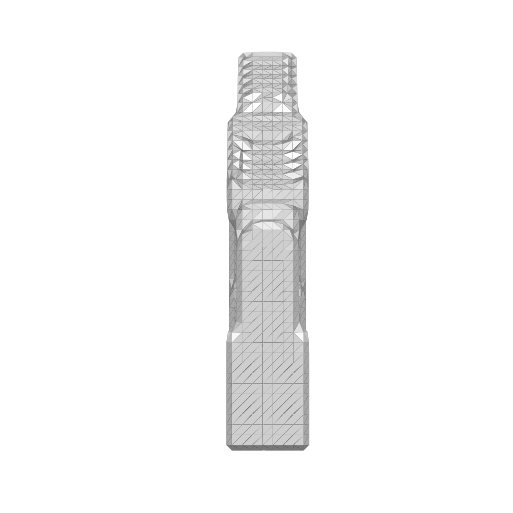

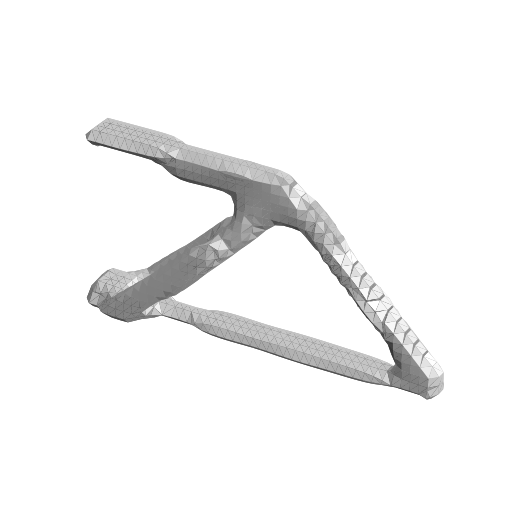

## Result Summary
VF:  tf.Tensor(0.089819066, shape=(), dtype=float32)
Mass: 0.162979 [kg]
Compliance: 1.204400e-01
Time: 237.47 [min]
Cost: 506.77 [$]
max d:  0.11279404807447029
comp:  0.12044001370668411
vf: tf.Tensor(0.089819066, shape=(), dtype=float32)
0.5 vf: tf.Tensor(0.08859375, shape=(), dtype=float64)
0.2 mass: tf.Tensor(0.20073216000000002, shape=(), dtype=float64)
cutoff 0.4755102040816327
cutoff mass:  tf.Tensor(0.16444160000000002, shape=(), dtype=float64)
## Result Summary
VF:  tf.Tensor(0.089819066, shape=(), dtype=float32)
Mass: 0.162979 [kg]
Compliance: 1.204400e-01
Time: 237.47 [min]
Cost: 506.77 [$]
Max Disp: 0.11279404811878921 [mm]
5
vf_arr:  [[0.39702413 1.         0.39702413]
 [0.98831086 1.         1.06928821]]
mass_vf,time_vf,cost_vf 0.27555375282167044 0.39702412583696445 0.988310857142857
cost_vf
opt1.time_con tf.Tensor(493.22195, shape=(), dtype=float32)
opt1.cost_con tf.Tensor(473.44916, shape=(), dtype=float32)
6
vf_arr:  [[-0.64398269  1.         -0.643

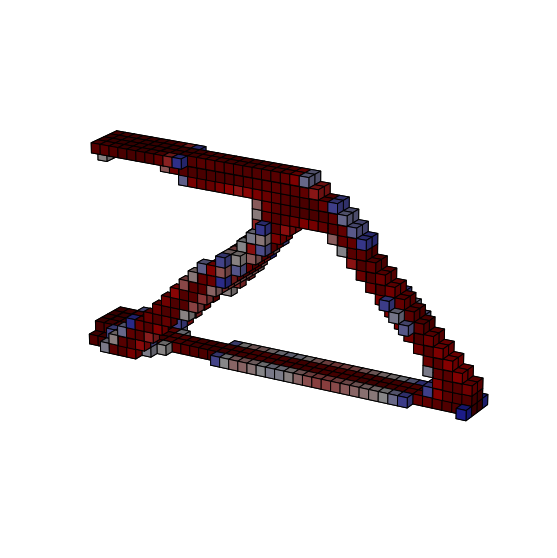

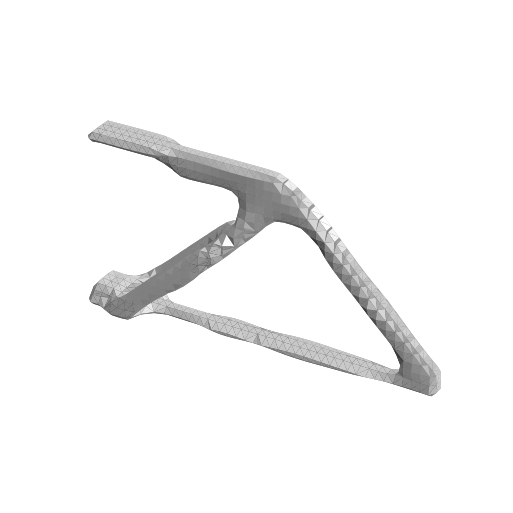

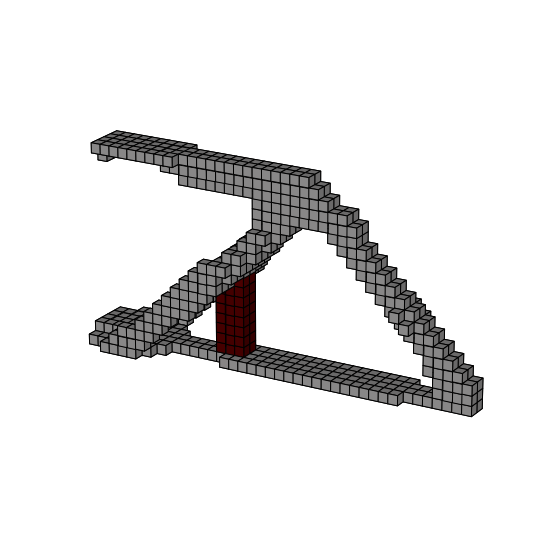

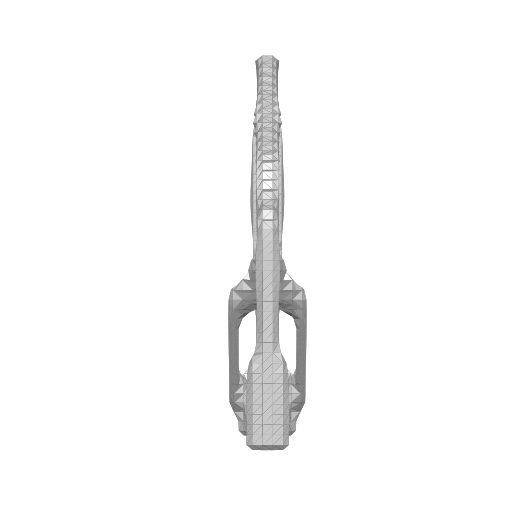

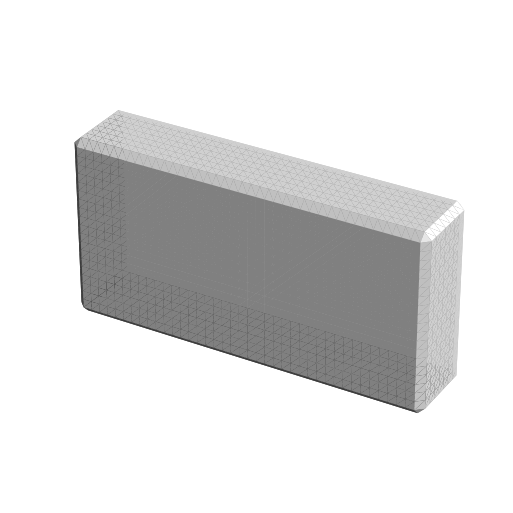

## Result Summary
VF:  tf.Tensor(0.9999998, shape=(), dtype=float32)
Mass: 0.434176 [kg]
Compliance: 9.183555e-01
Time: 115.00 [min]
Cost: 270.87 [$]
max d:  0.6227690053389867
comp:  0.9183556437492371
vf: tf.Tensor(0.9999998, shape=(), dtype=float32)
0.5 vf: tf.Tensor(1.0, shape=(), dtype=float64)
0.2 mass: tf.Tensor(0.43417600000000006, shape=(), dtype=float64)
cutoff 0.9
cutoff mass:  tf.Tensor(0.43417600000000006, shape=(), dtype=float64)
## Result Summary
VF:  tf.Tensor(0.9999998, shape=(), dtype=float32)
Mass: 0.434176 [kg]
Compliance: 9.183553e-01
Time: 115.00 [min]
Cost: 270.87 [$]
Max Disp: 0.6227689456985154 [mm]
8
vf_arr:  [[-1.          0.84167924  0.84167889]
 [-1.          0.4462232   0.26018731]]
mass_vf,time_vf,cost_vf 0.99999 0.8416792449032984 0.4462231960696819
cost_vf
opt1.time_con tf.Tensor(446.39996, shape=(), dtype=float32)
opt1.cost_con tf.Tensor(499.5023, shape=(), dtype=float32)
opt1.c_0 tf.Tensor(9.187654e-10, shape=(), dtype=float32)


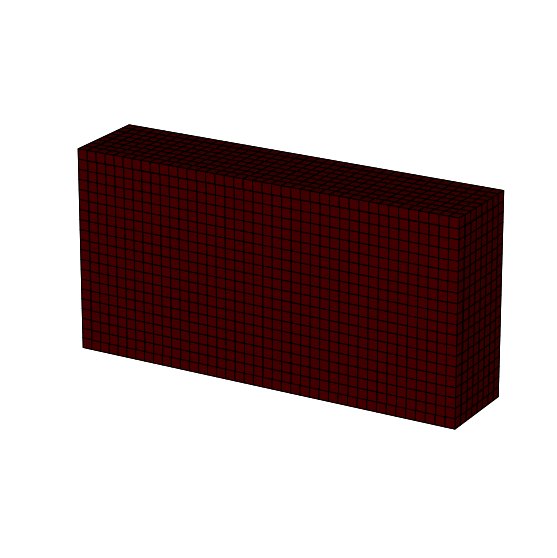

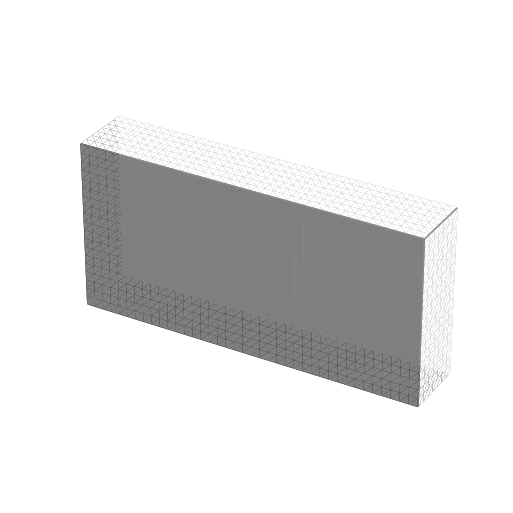

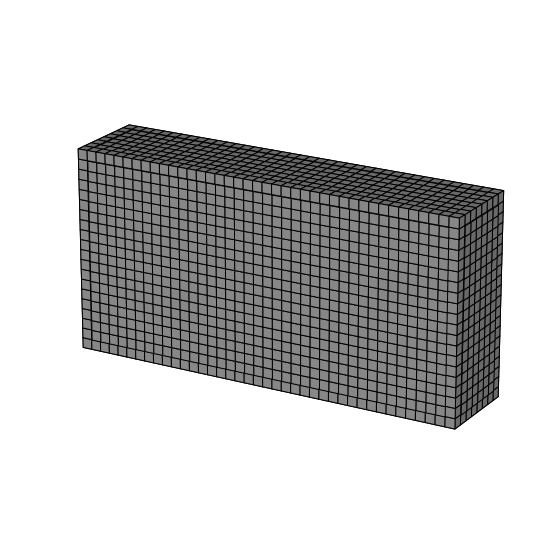

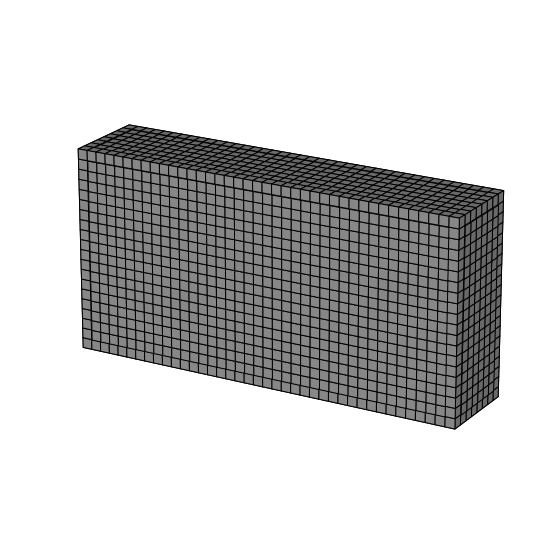

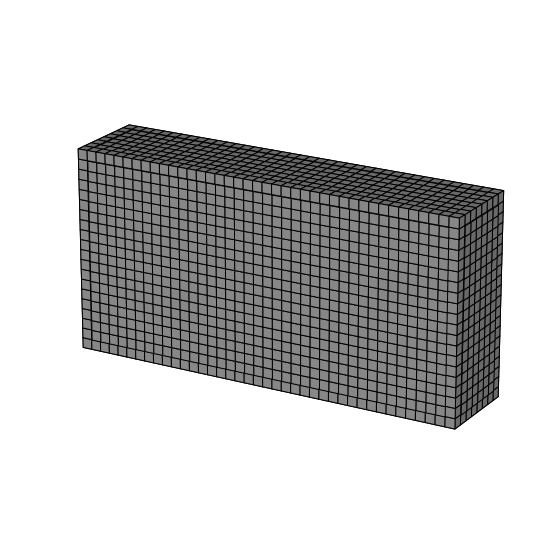

...

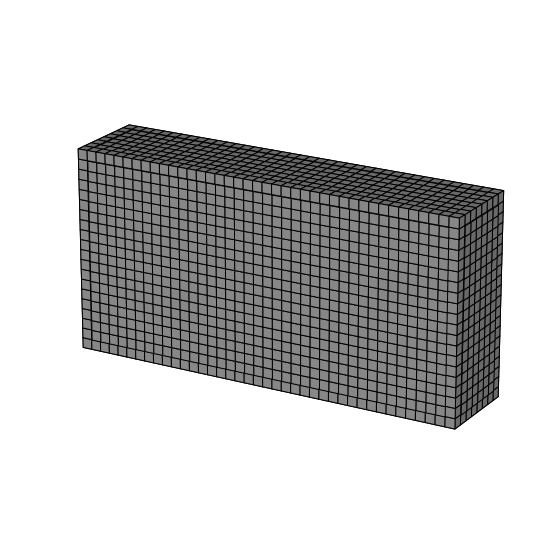

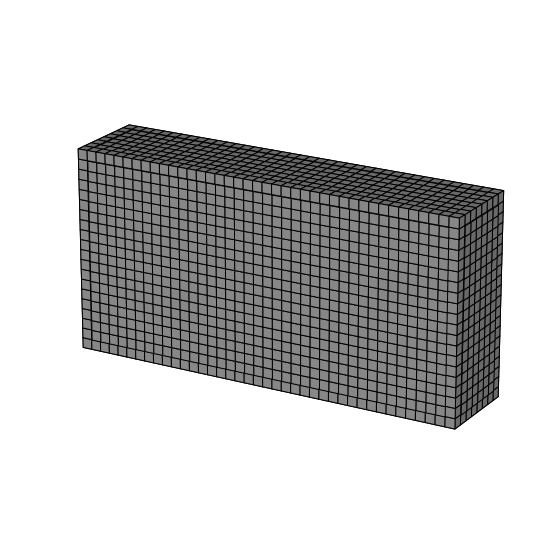

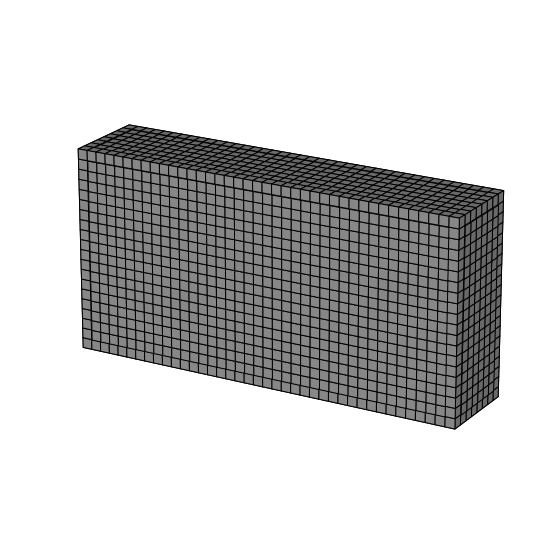

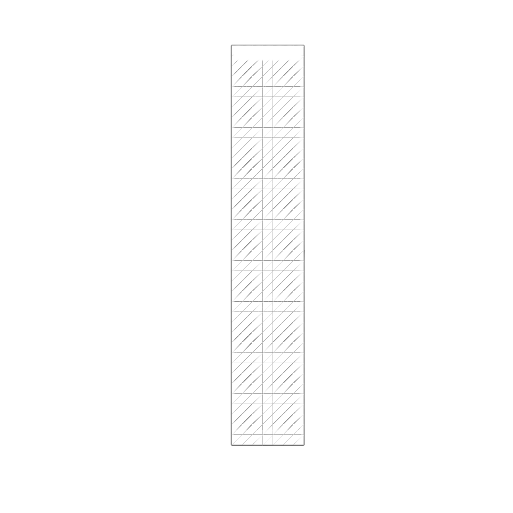

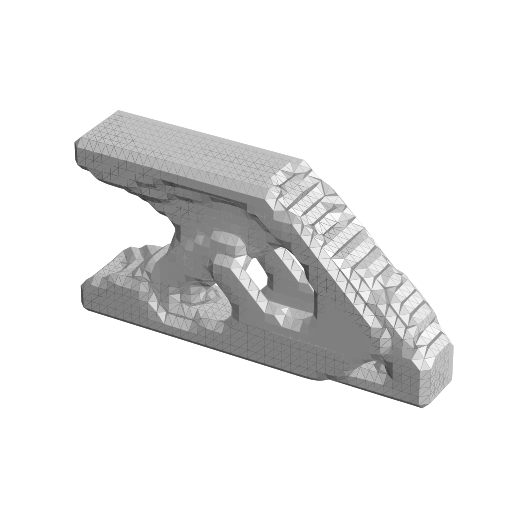

## Result Summary
VF:  tf.Tensor(0.4596698, shape=(), dtype=float32)
Mass: 0.199578 [kg]
Compliance: 1.290897e+00
Time: 269.90 [min]
Cost: 500.19 [$]
max d:  0.9891848207638622
comp:  1.2908967733383179
vf: tf.Tensor(0.4596698, shape=(), dtype=float32)
0.5 vf: tf.Tensor(0.46015625, shape=(), dtype=float64)
0.2 mass: tf.Tensor(0.20697984, shape=(), dtype=float64)
cutoff 0.49183673469387756
cutoff mass:  tf.Tensor(0.19992448000000002, shape=(), dtype=float64)
## Result Summary
VF:  tf.Tensor(0.4596698, shape=(), dtype=float32)
Mass: 0.199578 [kg]
Compliance: 1.290897e+00
Time: 269.90 [min]
Cost: 500.19 [$]
Max Disp: 0.9891848201019557 [mm]
9
vf_arr:  [[-0.64398269  1.          1.        ]
 [ 0.57069625  1.          1.        ]]
mass_vf,time_vf,cost_vf 0.99999 -0.6439826948924683 0.5706962500000001
cost_vf
opt1.time_con 446.40024346752347
opt1.cost_con 499.70378024034767
opt1.c_0 tf.Tensor(4.0997855e-10, shape=(), dtype=float32)


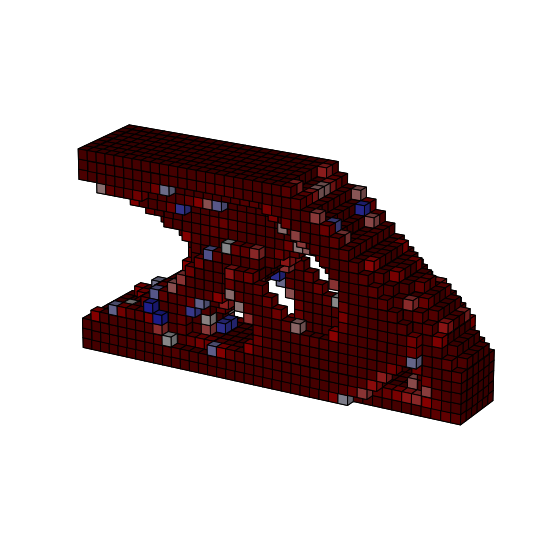

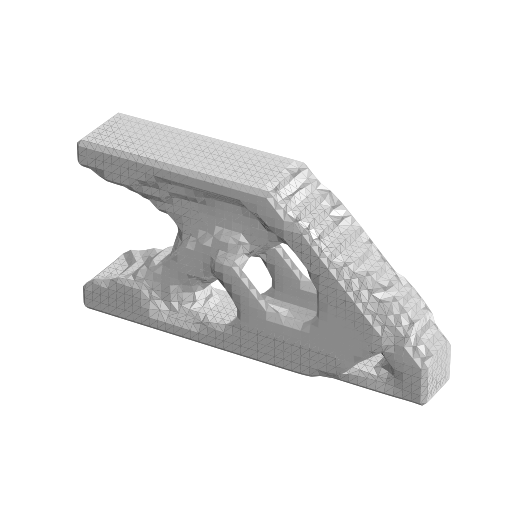

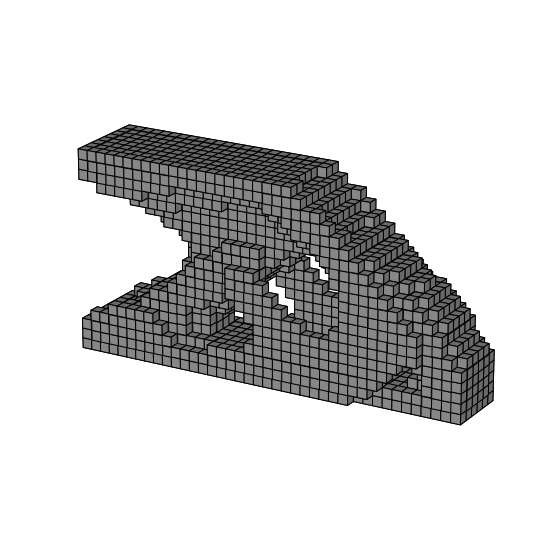

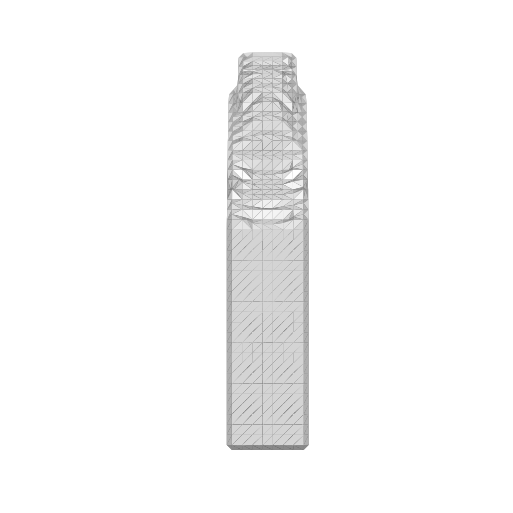

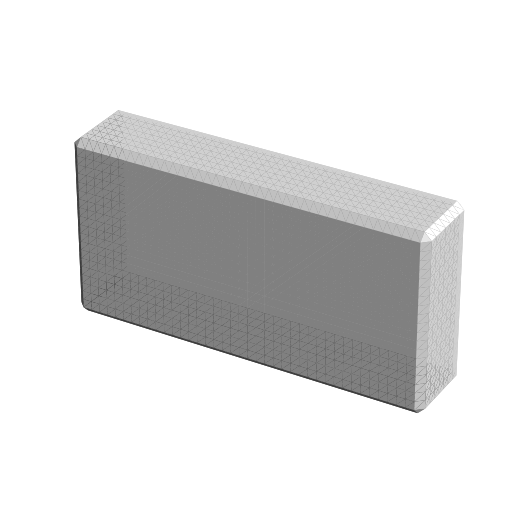

## Result Summary
VF:  tf.Tensor(0.9999994, shape=(), dtype=float32)
Mass: 0.434176 [kg]
Compliance: 9.183555e-01
Time: 56.76 [min]
Cost: 97.91 [$]
max d:  0.6227690054084144
comp:  0.9183555841445923
vf: tf.Tensor(0.9999994, shape=(), dtype=float32)
0.5 vf: tf.Tensor(1.0, shape=(), dtype=float64)
0.2 mass: tf.Tensor(0.43417600000000006, shape=(), dtype=float64)
cutoff 0.9
cutoff mass:  tf.Tensor(0.43417600000000006, shape=(), dtype=float64)
## Result Summary
VF:  tf.Tensor(0.9999994, shape=(), dtype=float32)
Mass: 0.434176 [kg]
Compliance: 9.183552e-01
Time: 56.76 [min]
Cost: 97.91 [$]
Max Disp: 0.6227689458068754 [mm]
1
vf_arr:  [[-1.          0.33043695  0.33043695]
 [-1.          0.16059529  0.09368058]]
mass_vf,time_vf,cost_vf 0.1808449074074074 0.33043695060745376 0.16059529463816474
cost_vf
opt1.time_con tf.Tensor(446.3999, shape=(), dtype=float32)
opt1.cost_con tf.Tensor(499.71017, shape=(), dtype=float32)


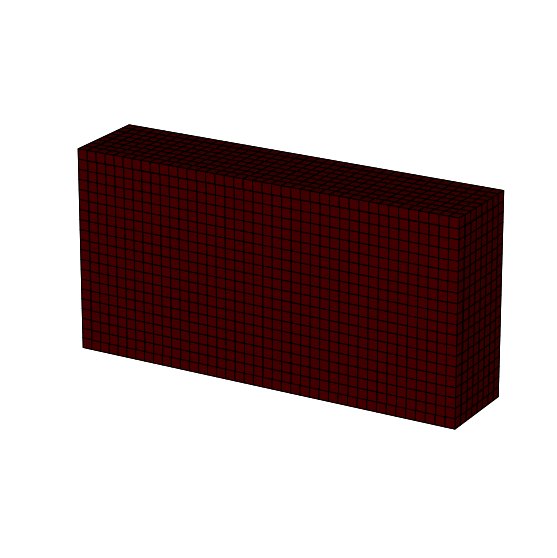

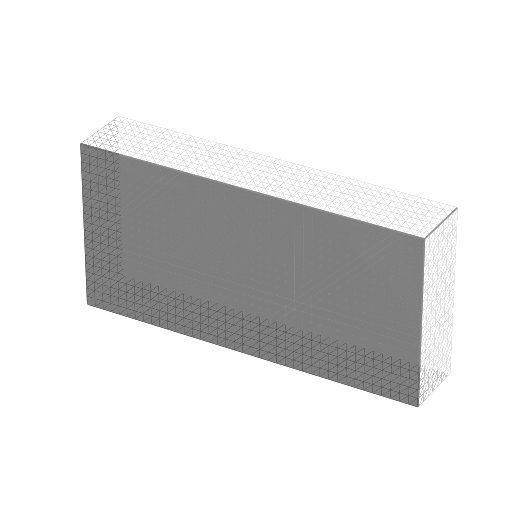

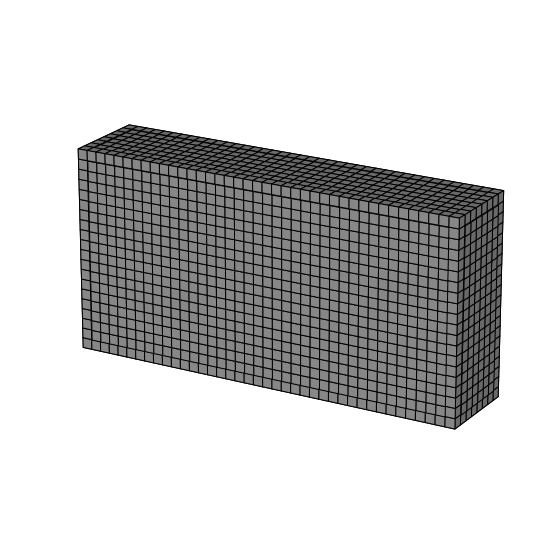

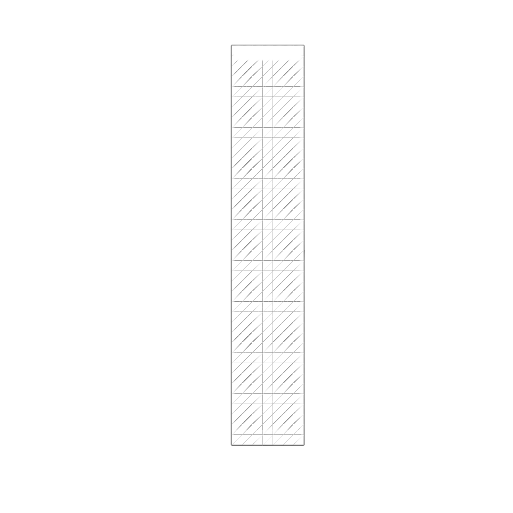

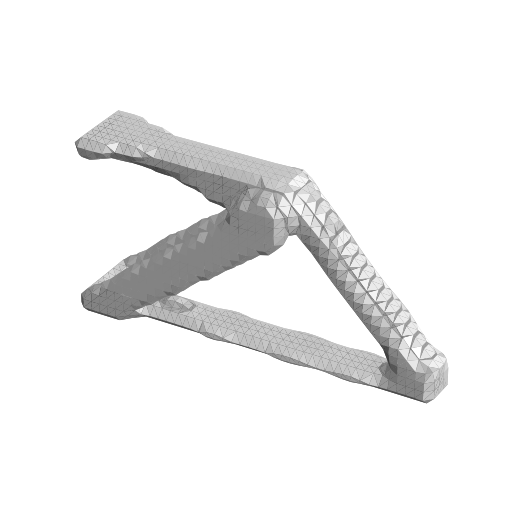

## Result Summary
VF:  tf.Tensor(0.16099483, shape=(), dtype=float32)
Mass: 0.178047 [kg]
Compliance: 1.076766e-01
Time: 253.39 [min]
Cost: 500.70 [$]
max d:  0.09661595936565008
comp:  0.10767664015293121
vf: tf.Tensor(0.16099483, shape=(), dtype=float32)
0.5 vf: tf.Tensor(0.1584375, shape=(), dtype=float64)
0.2 mass: tf.Tensor(0.1973376, shape=(), dtype=float64)
cutoff 0.4102040816326531
cutoff mass:  tf.Tensor(0.1791936, shape=(), dtype=float64)
## Result Summary
VF:  tf.Tensor(0.16099483, shape=(), dtype=float32)
Mass: 0.178047 [kg]
Compliance: 1.076766e-01
Time: 253.39 [min]
Cost: 500.70 [$]
Max Disp: 0.09661595939632518 [mm]
2
vf_arr:  [[-4.91079861  1.         -4.91079861]
 [ 0.05878533  1.          0.849922  ]]
mass_vf,time_vf,cost_vf 0.1808449074074074 -4.910798611111235 0.058785333333333245
cost_vf
opt1.time_con tf.Tensor(492.87778, shape=(), dtype=float32)
opt1.cost_con tf.Tensor(453.83353, shape=(), dtype=float32)


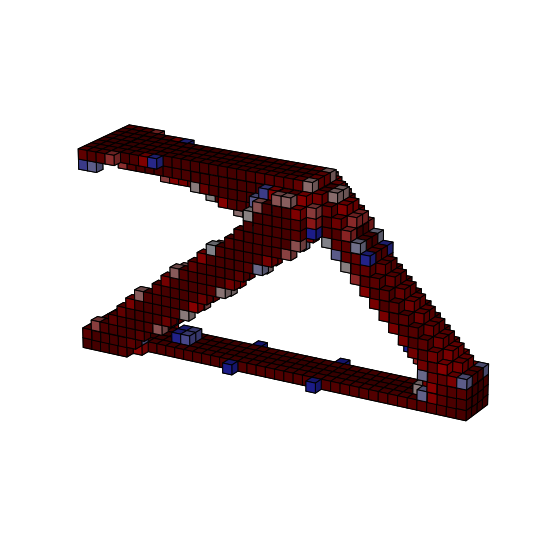

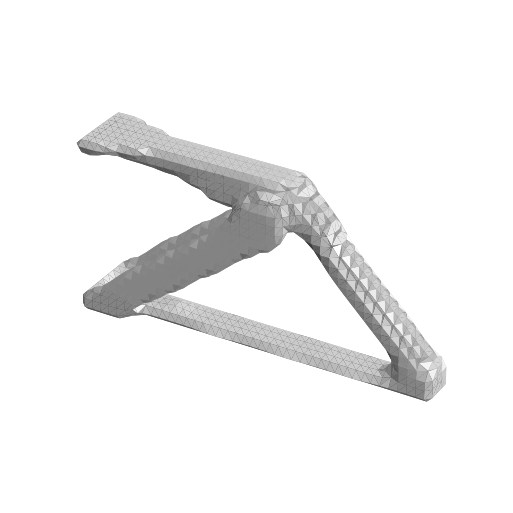

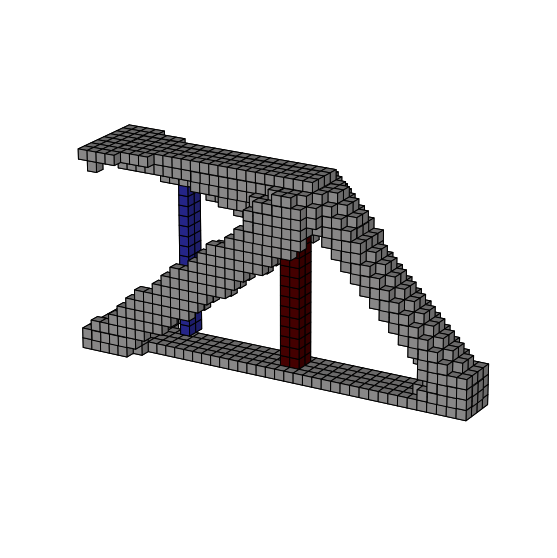

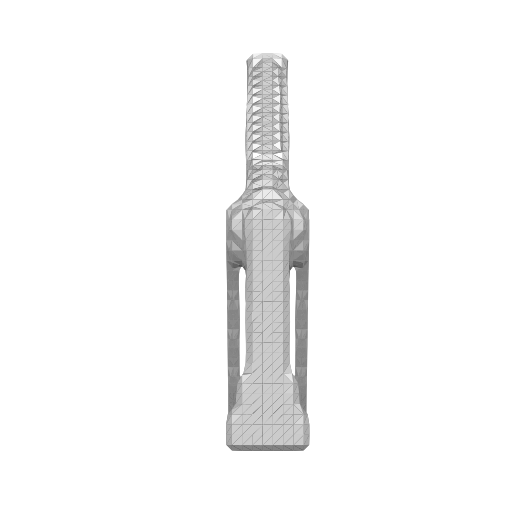

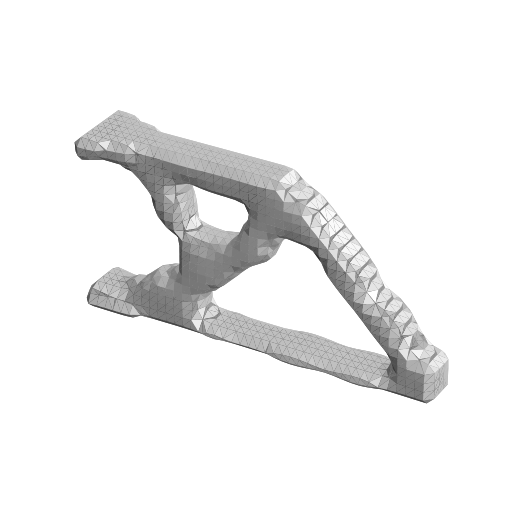

## Result Summary
VF:  tf.Tensor(0.1814199, shape=(), dtype=float32)
Mass: 0.200636 [kg]
Compliance: 9.578496e-02
Time: 167.33 [min]
Cost: 430.31 [$]
max d:  0.08481643714784358
comp:  0.09578496217727661
vf: tf.Tensor(0.1814199, shape=(), dtype=float32)
0.5 vf: tf.Tensor(0.17875, shape=(), dtype=float64)
0.2 mass: tf.Tensor(0.2249856, shape=(), dtype=float64)
cutoff 0.44285714285714284
cutoff mass:  tf.Tensor(0.2011392, shape=(), dtype=float64)
## Result Summary
VF:  tf.Tensor(0.1814199, shape=(), dtype=float32)
Mass: 0.200636 [kg]
Compliance: 9.578498e-02
Time: 167.33 [min]
Cost: 430.31 [$]
Max Disp: 0.08481643720962416 [mm]
3
vf_arr:  [[-0.64398269  1.         -0.64398269]
 [ 0.57324771  1.          0.74823538]]
mass_vf,time_vf,cost_vf 0.1808449074074074 -0.6439826948924683 0.5732477083333334
cost_vf
opt1.time_con 446.40024346752347
opt1.cost_con 499.7233782041071
4
vf_arr:  [[-1.          0.201395   -1.        ]
 [-1.          0.08807108 -1.        ]]
mass_vf,time_vf,cost_vf 0.1102

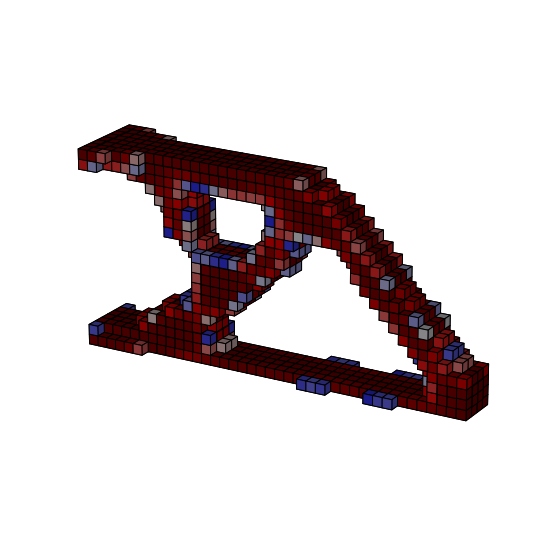

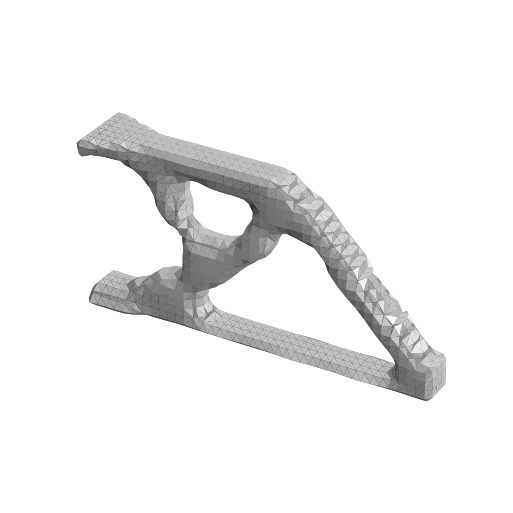

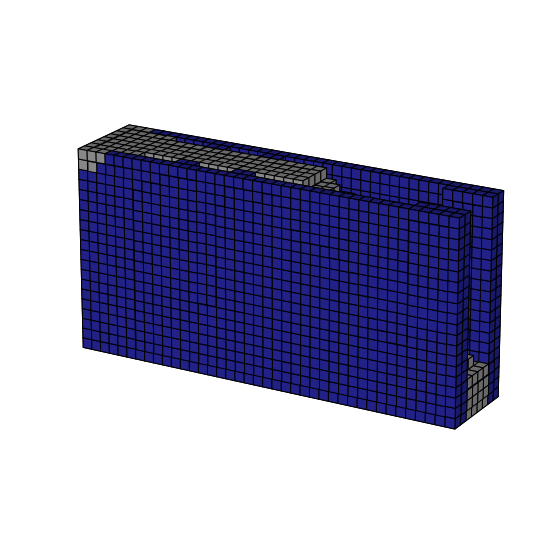

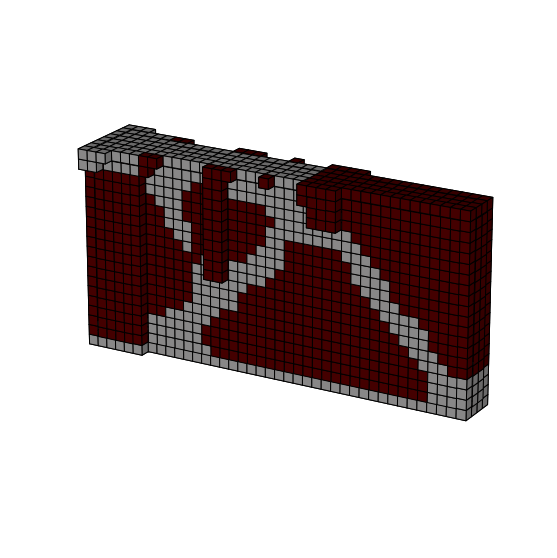

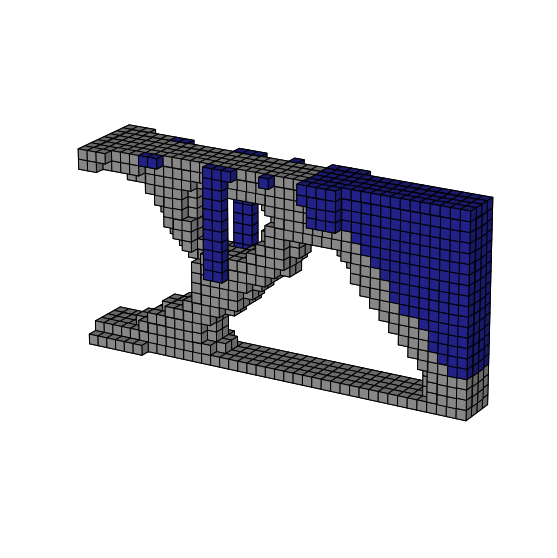

...

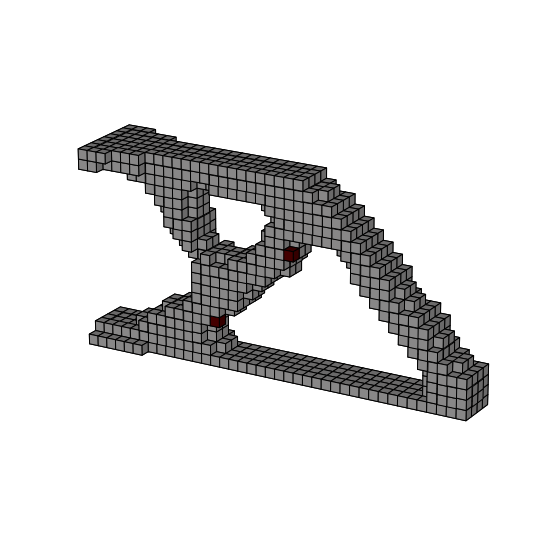

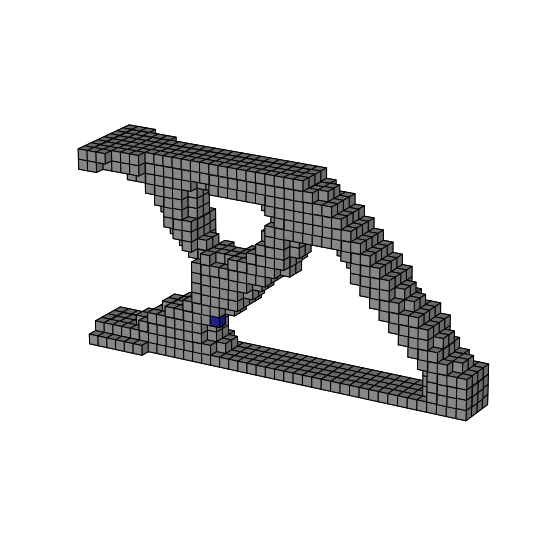

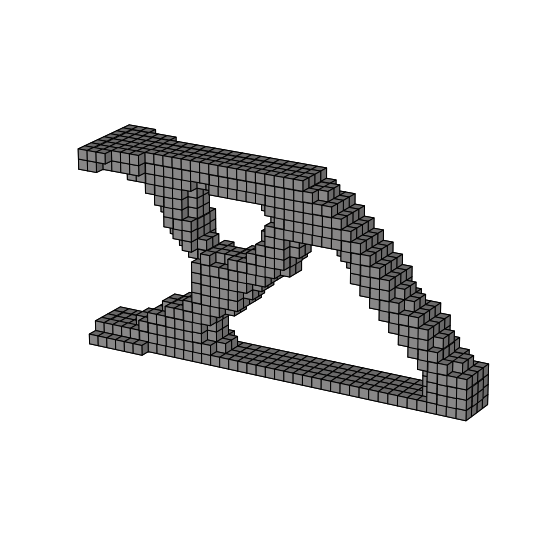

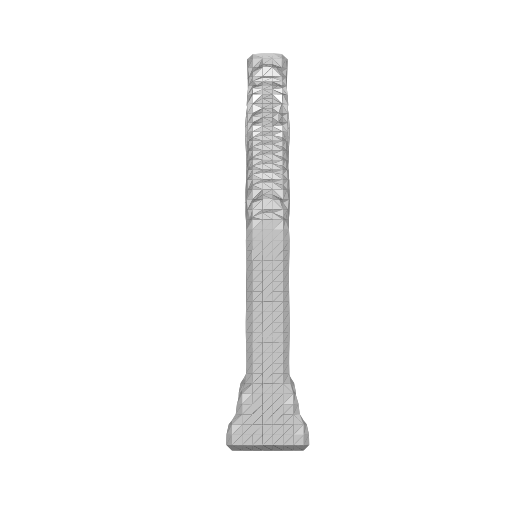

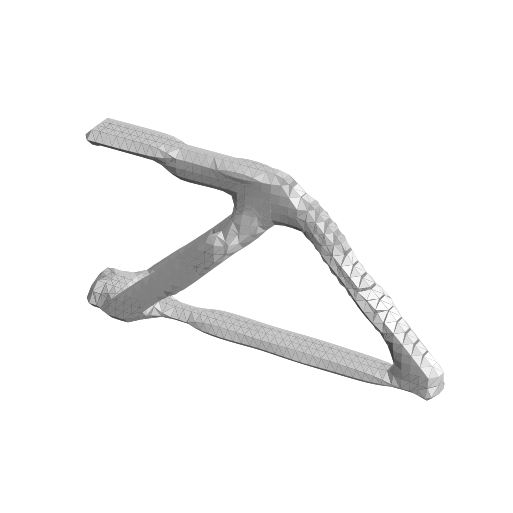

## Result Summary
VF:  tf.Tensor(0.09130905, shape=(), dtype=float32)
Mass: 0.165683 [kg]
Compliance: 1.197763e-01
Time: 240.47 [min]
Cost: 514.07 [$]
max d:  0.11207459348458362
comp:  0.11977632343769073
vf: tf.Tensor(0.09130905, shape=(), dtype=float32)
0.5 vf: tf.Tensor(0.09, shape=(), dtype=float64)
0.2 mass: tf.Tensor(0.21122240000000003, shape=(), dtype=float64)
cutoff 0.4755102040816327
cutoff mass:  tf.Tensor(0.16670976, shape=(), dtype=float64)
## Result Summary
VF:  tf.Tensor(0.09130905, shape=(), dtype=float32)
Mass: 0.165683 [kg]
Compliance: 1.197763e-01
Time: 240.47 [min]
Cost: 514.07 [$]
Max Disp: 0.11207459347197633 [mm]
5
vf_arr:  [[0.39702413 1.         0.39702413]
 [0.98831086 1.         1.06928821]]
mass_vf,time_vf,cost_vf 0.11022150112866819 0.39702412583696445 0.988310857142857
cost_vf
opt1.time_con tf.Tensor(493.22195, shape=(), dtype=float32)
opt1.cost_con tf.Tensor(473.44916, shape=(), dtype=float32)
6
vf_arr:  [[-0.64398269  1.         -0.64398269]
 [ 0.760476

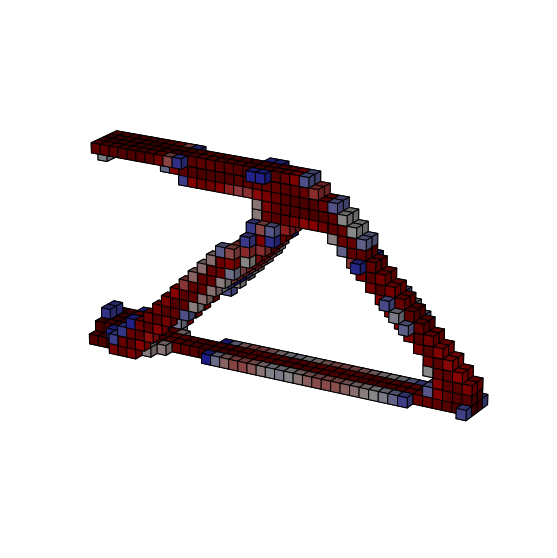

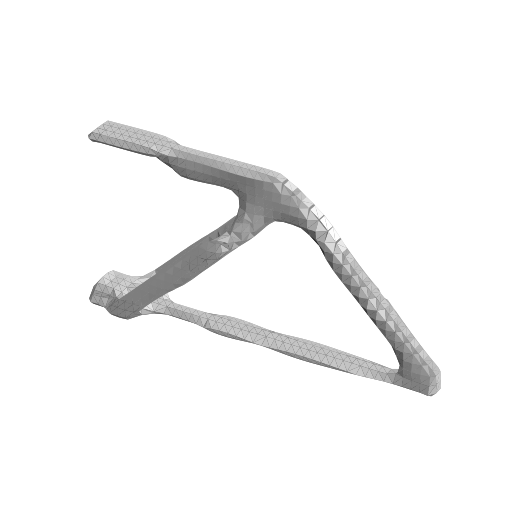

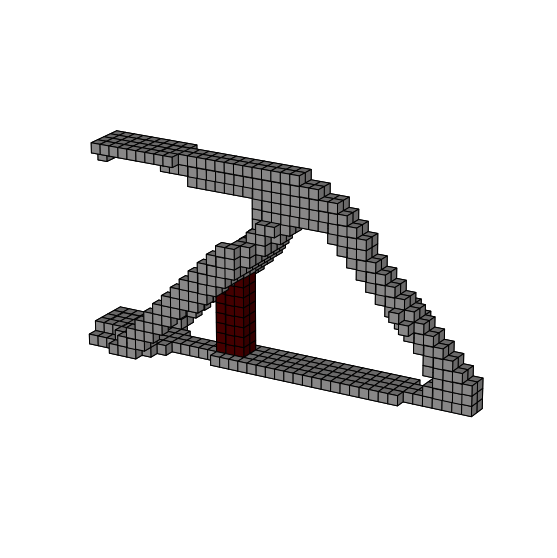

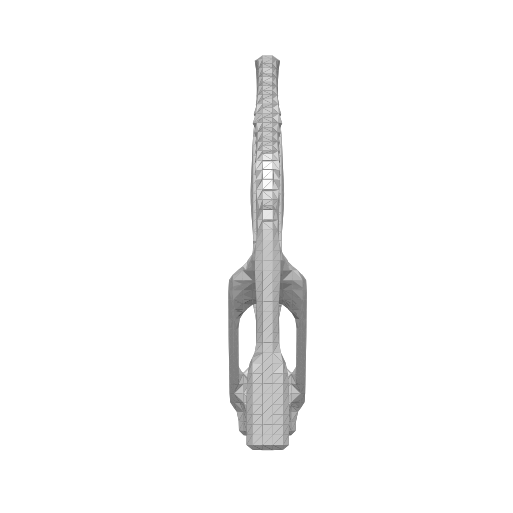

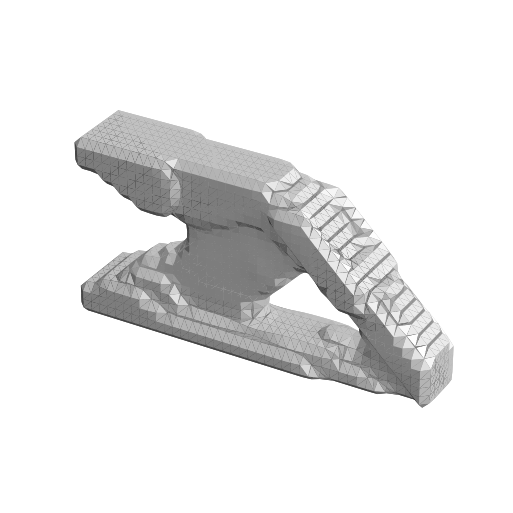

## Result Summary
VF:  tf.Tensor(0.4611078, shape=(), dtype=float32)
Mass: 0.200202 [kg]
Compliance: 1.288701e+00
Time: 151.17 [min]
Cost: 379.37 [$]
max d:  0.9867803034024415
comp:  1.2887012958526611
vf: tf.Tensor(0.4611078, shape=(), dtype=float32)
0.5 vf: tf.Tensor(0.45984375, shape=(), dtype=float64)
0.2 mass: tf.Tensor(0.20677632, shape=(), dtype=float64)
cutoff 0.4755102040816327
cutoff mass:  tf.Tensor(0.20026368000000003, shape=(), dtype=float64)
## Result Summary
VF:  tf.Tensor(0.4611078, shape=(), dtype=float32)
Mass: 0.200202 [kg]
Compliance: 1.288701e+00
Time: 151.17 [min]
Cost: 379.37 [$]
Max Disp: 0.9867803046810995 [mm]
8
vf_arr:  [[-1.          0.84167924  0.84167889]
 [-1.          0.4462232   0.26018731]]
mass_vf,time_vf,cost_vf 0.46064268867924535 0.8416792449032984 0.4462231960696819
cost_vf
opt1.time_con tf.Tensor(446.39996, shape=(), dtype=float32)
opt1.cost_con tf.Tensor(499.5023, shape=(), dtype=float32)
opt1.c_0 tf.Tensor(9.187654e-10, shape=(), dtype=float32

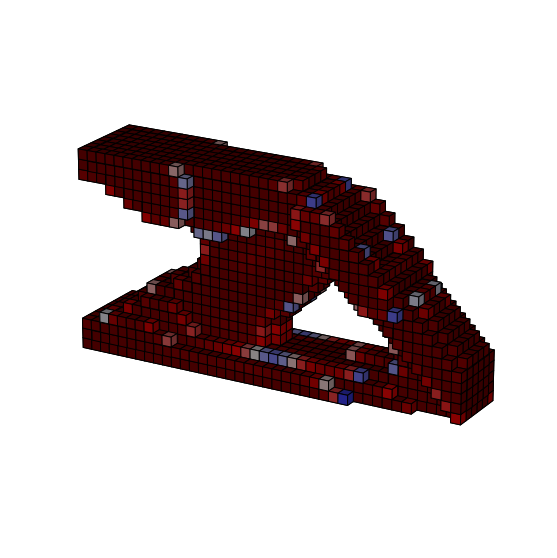

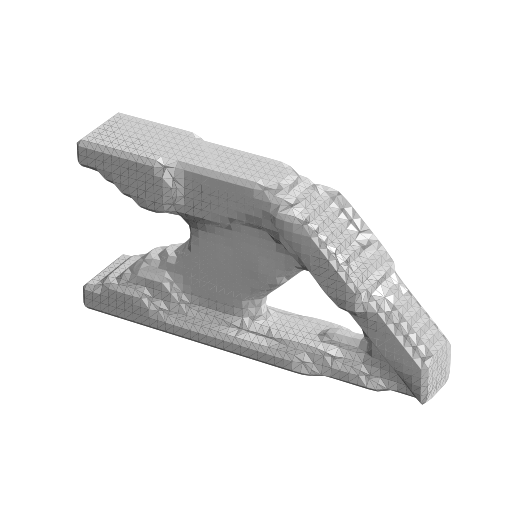

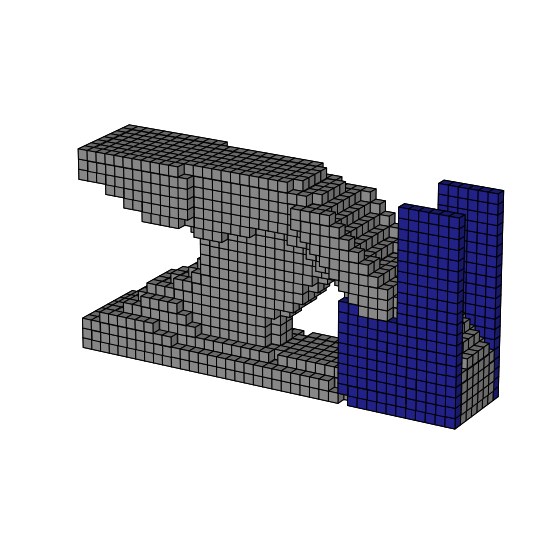

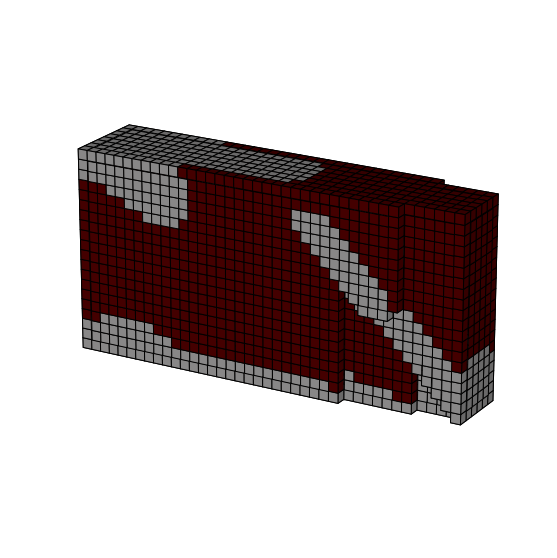

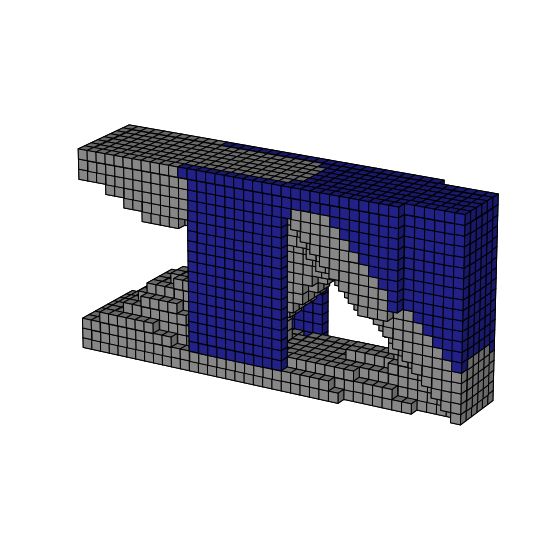

...

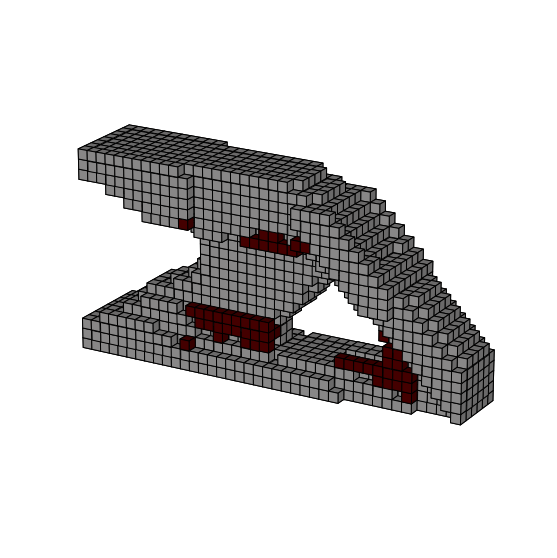

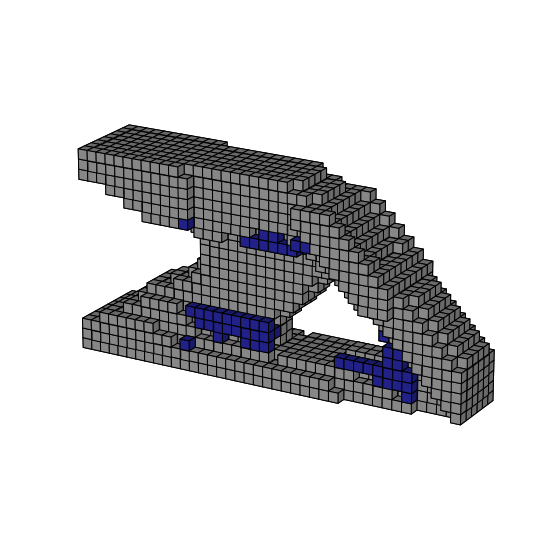

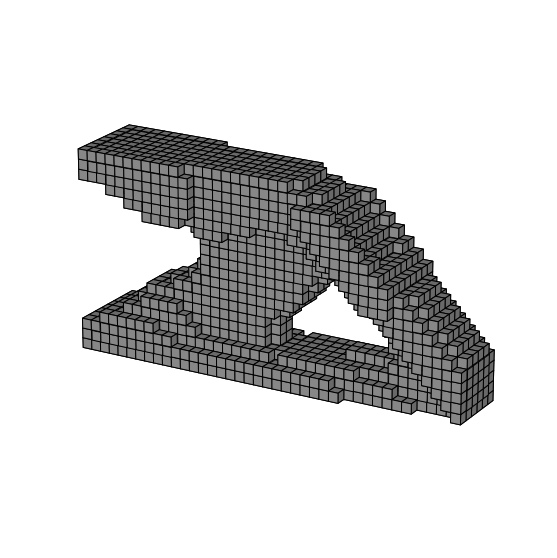

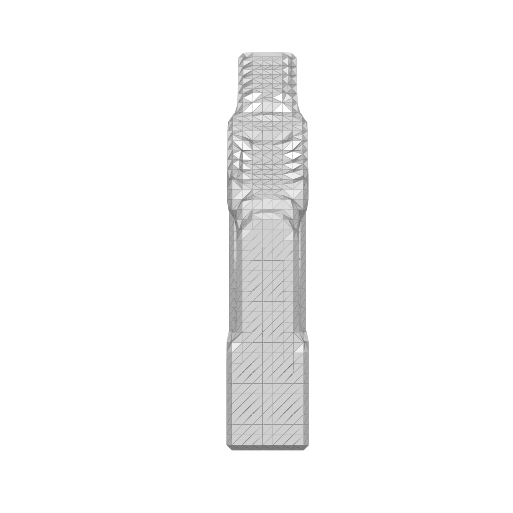

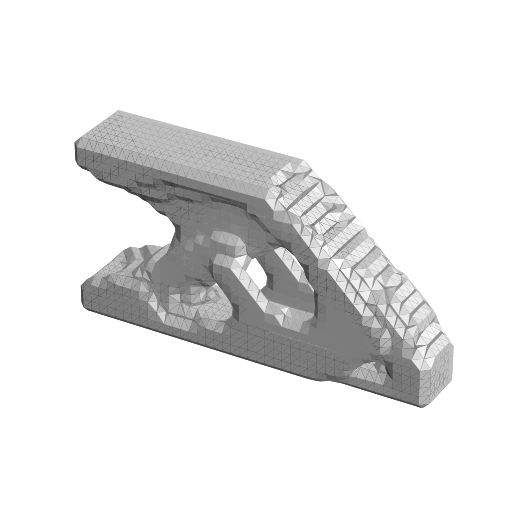

## Result Summary
VF:  tf.Tensor(0.45966706, shape=(), dtype=float32)
Mass: 0.199576 [kg]
Compliance: 1.290977e+00
Time: 269.89 [min]
Cost: 500.19 [$]
max d:  0.9891671165897606
comp:  1.290976881980896
vf: tf.Tensor(0.45966706, shape=(), dtype=float32)
0.5 vf: tf.Tensor(0.46, shape=(), dtype=float64)
0.2 mass: tf.Tensor(0.20704768, shape=(), dtype=float64)
cutoff 0.5081632653061224
cutoff mass:  tf.Tensor(0.19965312, shape=(), dtype=float64)
## Result Summary
VF:  tf.Tensor(0.45966706, shape=(), dtype=float32)
Mass: 0.199576 [kg]
Compliance: 1.290977e+00
Time: 269.89 [min]
Cost: 500.19 [$]
Max Disp: 0.9891671189818654 [mm]
9
vf_arr:  [[-0.64398269  1.          1.        ]
 [ 0.57069625  1.          1.        ]]
mass_vf,time_vf,cost_vf 0.46064268867924535 -0.6439826948924683 0.5706962500000001
cost_vf
opt1.time_con 446.40024346752347
opt1.cost_con 499.70378024034767
1
vf_arr:  [[-1.          0.19137941  0.19137941]
 [-1.          0.08029766  0.0400958 ]]
mass_vf,time_vf,cost_vf 0.18084

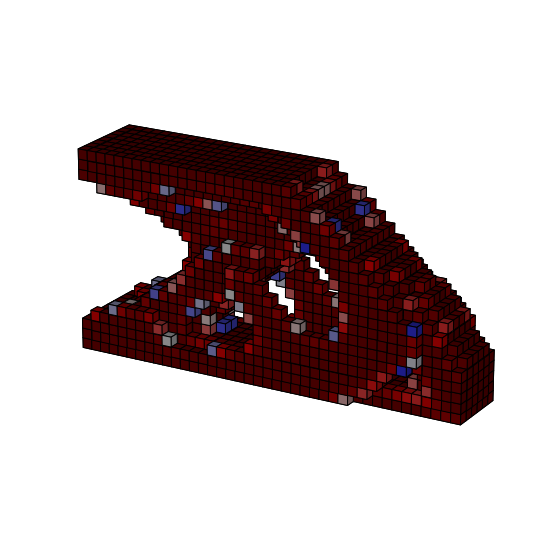

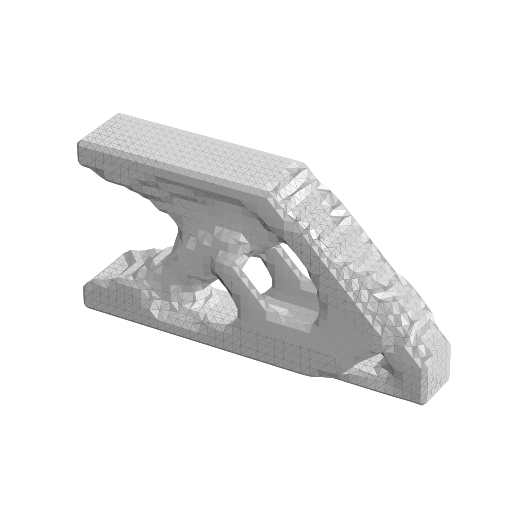

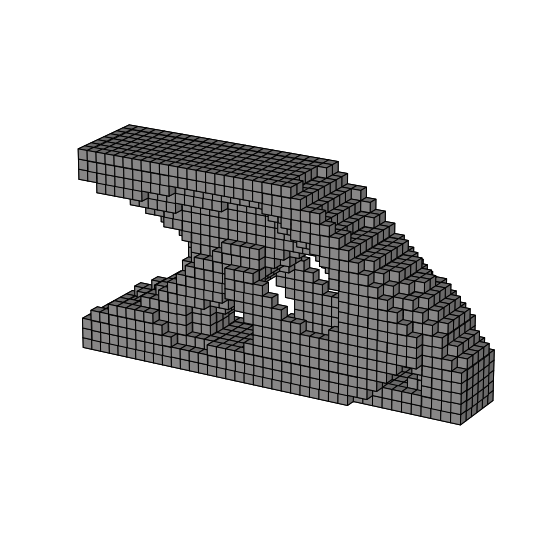

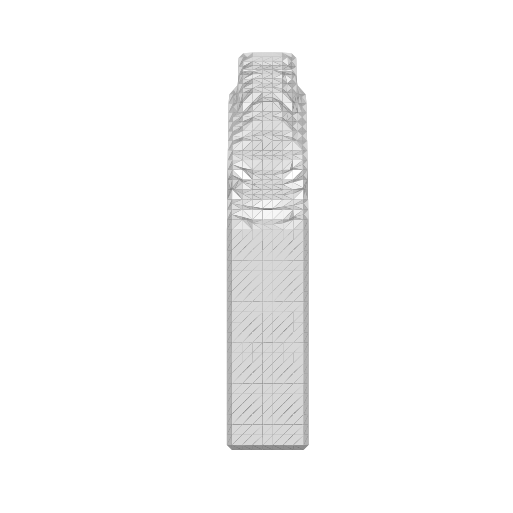

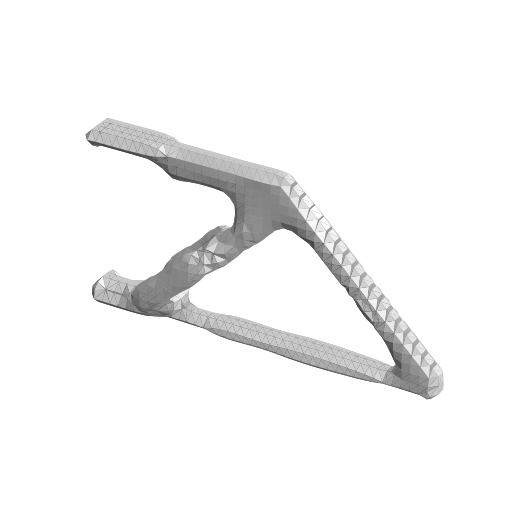

## Result Summary
VF:  tf.Tensor(0.0829297, shape=(), dtype=float32)
Mass: 0.091714 [kg]
Compliance: 2.304932e-01
Time: 164.39 [min]
Cost: 306.25 [$]
max d:  0.21689886637161115
comp:  0.2304931879043579
vf: tf.Tensor(0.0829297, shape=(), dtype=float32)
0.5 vf: tf.Tensor(0.079375, shape=(), dtype=float64)
0.2 mass: tf.Tensor(0.11733120000000001, shape=(), dtype=float64)
cutoff 0.4591836734693878
cutoff mass:  tf.Tensor(0.0926208, shape=(), dtype=float64)
## Result Summary
VF:  tf.Tensor(0.0829297, shape=(), dtype=float32)
Mass: 0.091714 [kg]
Compliance: 2.304932e-01
Time: 164.39 [min]
Cost: 306.25 [$]
Max Disp: 0.21689886643317932 [mm]
2
vf_arr:  [[-2.16079861  1.         -2.16079861]
 [ 0.98882417  1.          1.41382389]]
mass_vf,time_vf,cost_vf 0.1808449074074074 -2.160798611111166 0.9888241666666666
cost_vf
opt1.time_con tf.Tensor(317.07013, shape=(), dtype=float32)
opt1.cost_con tf.Tensor(275.46115, shape=(), dtype=float32)
3
vf_arr:  [[0.02133989 1.         0.02133989]
 [0.783492

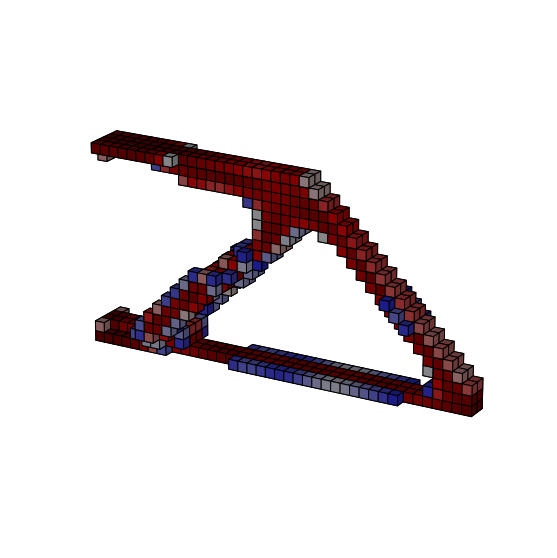

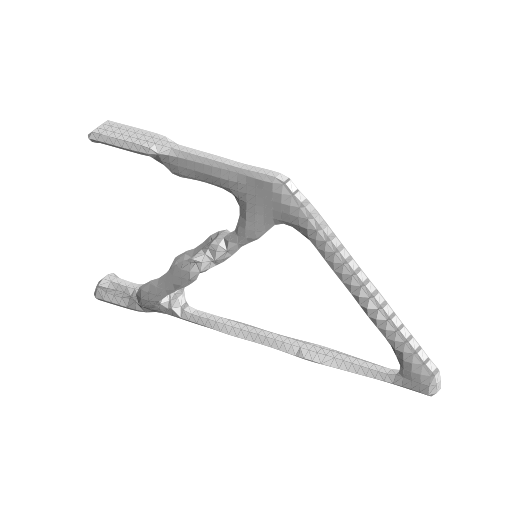

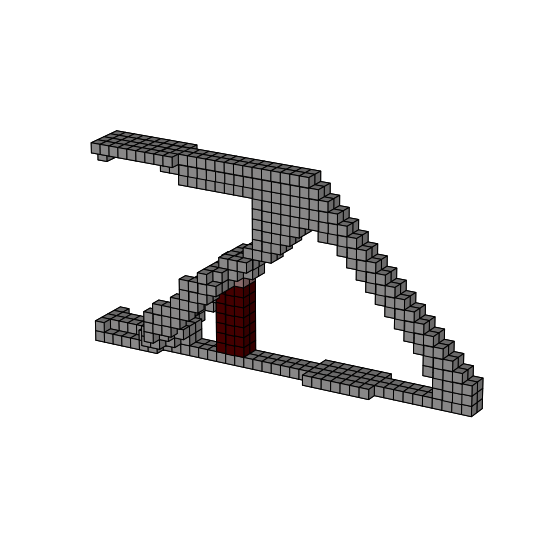

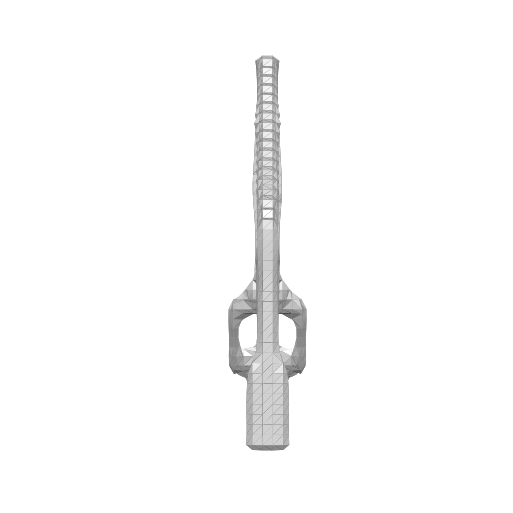

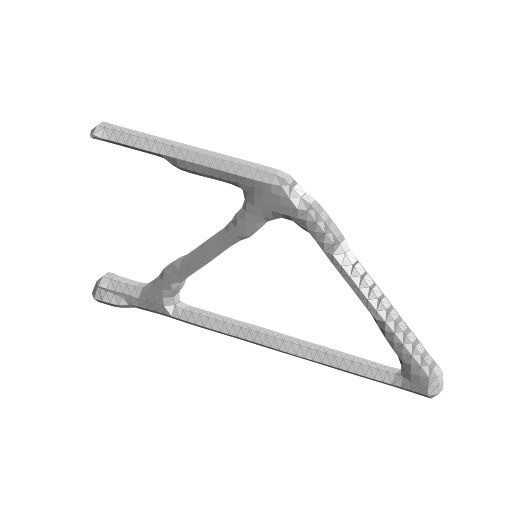

## Result Summary
VF:  tf.Tensor(0.047204703, shape=(), dtype=float32)
Mass: 0.085654 [kg]
Compliance: 2.221783e-01
Time: 155.88 [min]
Cost: 308.61 [$]
max d:  0.2134336568315437
comp:  0.22217831015586853
vf: tf.Tensor(0.047204703, shape=(), dtype=float32)
0.5 vf: tf.Tensor(0.0515625, shape=(), dtype=float64)
0.2 mass: tf.Tensor(0.10717056000000001, shape=(), dtype=float64)
cutoff 0.589795918367347
cutoff mass:  tf.Tensor(0.08675712000000001, shape=(), dtype=float64)
## Result Summary
VF:  tf.Tensor(0.047204703, shape=(), dtype=float32)
Mass: 0.085654 [kg]
Compliance: 2.221783e-01
Time: 155.88 [min]
Cost: 308.61 [$]
Max Disp: 0.21343365678467088 [mm]
5
con supplier
6
vf_arr:  [[0.02133989 1.         0.02133989]
 [0.97026333 1.         1.07495049]]
mass_vf,time_vf,cost_vf 0.11022150112866819 0.02133988575268808 0.9702633333333333
cost_vf
opt1.time_con 287.99990211478905
opt1.cost_con 299.77168342719386
7
vf_arr:  [[-2.01317881  1.          1.        ]
 [ 0.97861833  1.          1.     

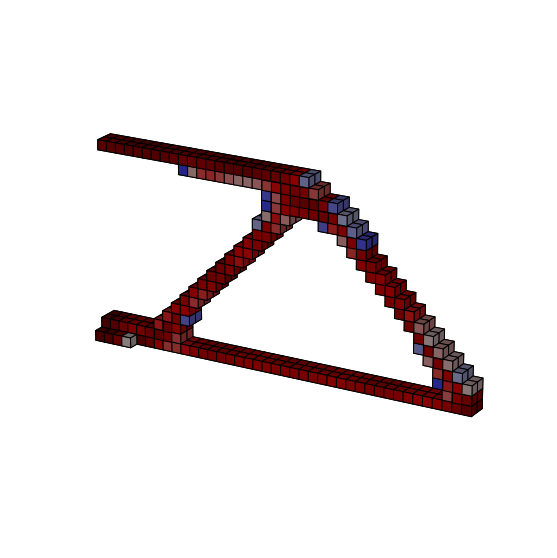

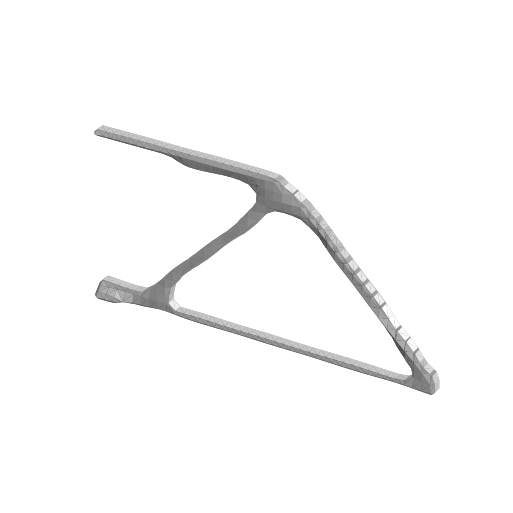

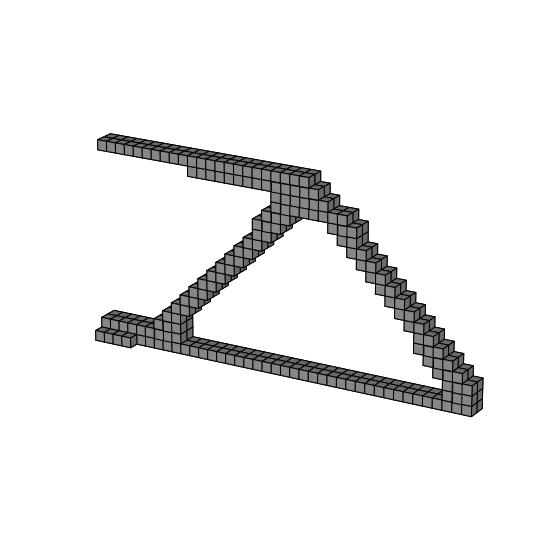

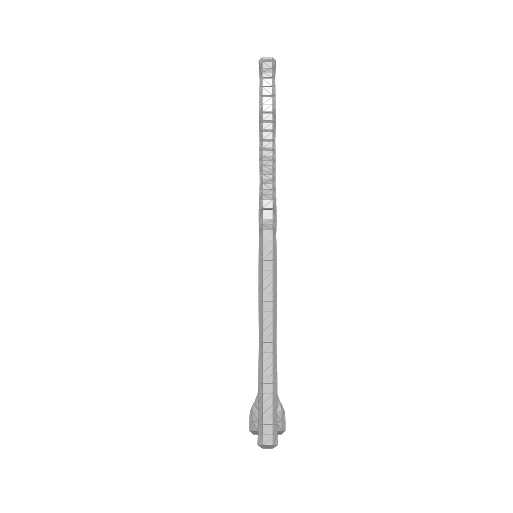

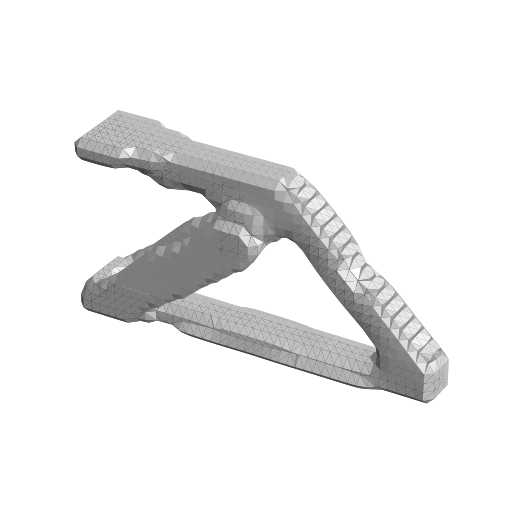

## Result Summary
VF:  tf.Tensor(0.22713795, shape=(), dtype=float32)
Mass: 0.098618 [kg]
Compliance: 2.378906e+00
Time: 169.96 [min]
Cost: 300.11 [$]
max d:  2.062131651588812
comp:  2.378906011581421
vf: tf.Tensor(0.22713795, shape=(), dtype=float32)
0.5 vf: tf.Tensor(0.225, shape=(), dtype=float64)
0.2 mass: tf.Tensor(0.10474496000000001, shape=(), dtype=float64)
cutoff 0.4102040816326531
cutoff mass:  tf.Tensor(0.09877504000000001, shape=(), dtype=float64)
## Result Summary
VF:  tf.Tensor(0.22713795, shape=(), dtype=float32)
Mass: 0.098618 [kg]
Compliance: 2.378906e+00
Time: 169.96 [min]
Cost: 300.11 [$]
Max Disp: 2.0621316503531455 [mm]
9
vf_arr:  [[0.02133989 1.         1.        ]
 [0.78091411 1.         1.        ]]
mass_vf,time_vf,cost_vf 0.46064268867924535 0.02133988575268808 0.780914105263158
cost_vf
opt1.time_con 287.99990211478905
opt1.cost_con 299.50868089569815


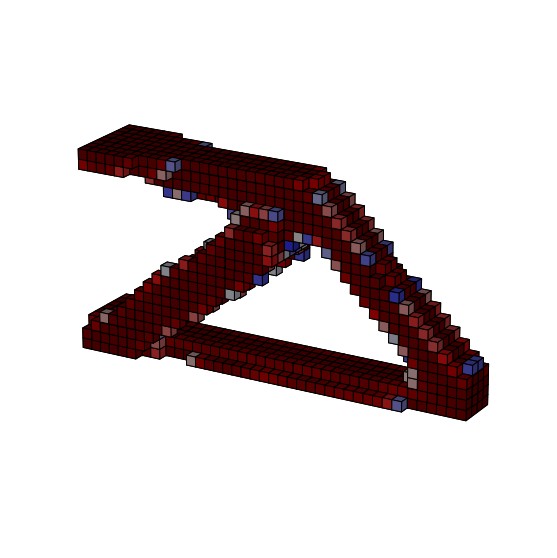

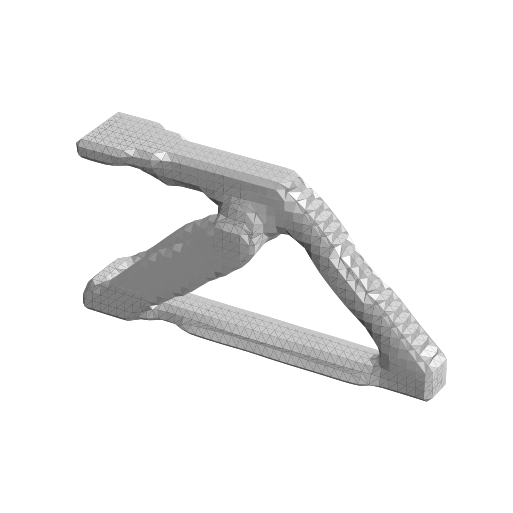

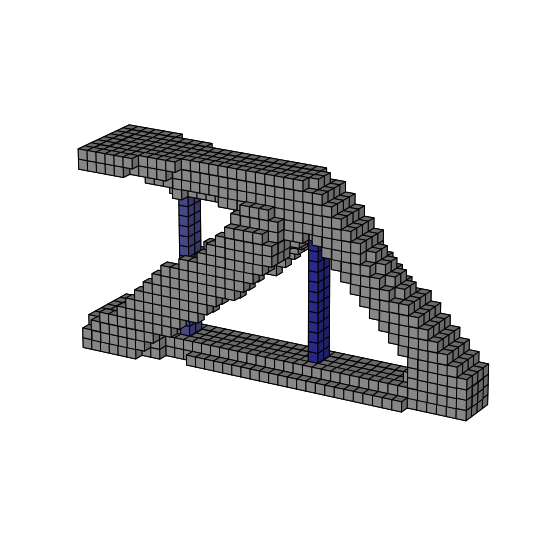

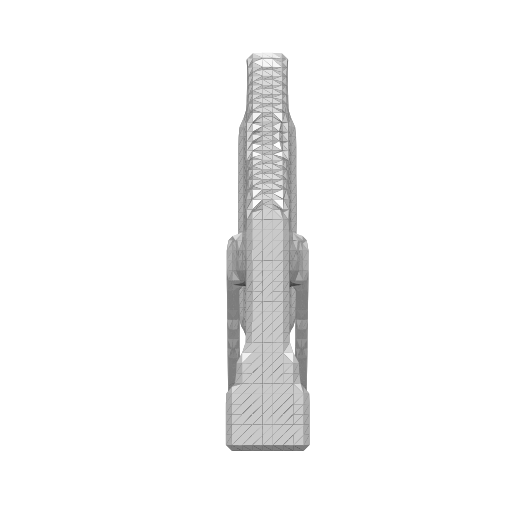

In [1]:
from optimization_sp import run_opt
from optimization_sp import run_batch_opt
import os

study_folder = "Studies/CB_Scenario_1"
for i in range(1,10):
    print(i)
    folder_name = "Past/Iter0/"+"config_{}".format(i)
    config_path = os.path.join(study_folder, folder_name)
    # run_opt(os.path.join(study_folder,"Past/Iter0/request_header.json"),os.path.join(config_path,"mmm.json"), os.path.join(study_folder,"bc.json"), "Resources/mat_lib.json",'Resources/machine.json',os.path.join(study_folder,"Past/Iter0/constraints.json"),probe = True, test = False)
    run_opt(os.path.join(study_folder,"Past/Iter0/request_header.json"),os.path.join(config_path,"mmm.json"), os.path.join(study_folder,"bc.json"), "Resources/mat_lib.json",'Resources/machine.json',os.path.join(study_folder,"Past/Iter0/constraints.json"),probe = False, test = True)

study_folder = "Studies/CB_Scenario_1"
for i in range(1,10):
    print(i)
    folder_name = "Past/Iter1/"+"config_{}".format(i)
    config_path = os.path.join(study_folder, folder_name)
    # run_opt(os.path.join(study_folder,"Past/Iter1/request_header.json"),os.path.join(config_path,"mmm.json"), os.path.join(study_folder,"bc.json"), "Resources/mat_lib.json",'Resources/machine.json',os.path.join(study_folder,"Past/Iter1/constraints.json"),probe = True, test = False)
    run_opt(os.path.join(study_folder,"Past/Iter1/request_header.json"),os.path.join(config_path,"mmm.json"), os.path.join(study_folder,"bc.json"), "Resources/mat_lib.json",'Resources/machine.json',os.path.join(study_folder,"Past/Iter1/constraints.json"),probe = False, test = True)


study_folder = "Studies/CB_Scenario_1"
for i in range(1,10):
    print(i)
    folder_name = "config_{}".format(i)
    config_path = os.path.join(study_folder, folder_name)
    # run_opt(os.path.join(study_folder,"request_header.json"),os.path.join(config_path,"mmm.json"), os.path.join(study_folder,"bc.json"), "Resources/mat_lib.json",'Resources/machine.json',os.path.join(study_folder,"constraints.json"),probe = True, test = False)
    run_opt(os.path.join(study_folder,"request_header.json"),os.path.join(config_path,"mmm.json"), os.path.join(study_folder,"bc.json"), "Resources/mat_lib.json",'Resources/machine.json',os.path.join(study_folder,"constraints.json"),probe = False, test = True)
